In [1]:
import hypothesis as h
import numpy as np
import glob
import torch
import os
import matplotlib.pyplot as plt
from scipy.stats import kstest, uniform
from copy import deepcopy as copy

from matplotlib import cm
from matplotlib.patches import Rectangle
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.axes_grid1 import Divider
from mpl_toolkits.axes_grid1.axes_size import Fixed, Scaled
from hypothesis.plot import make_square

In [2]:
h.plot.activate()

In [3]:
np_load_old = np.load
np.load = lambda *a, **k: np_load_old(*a, allow_pickle=True, **k)

## Setup

In [4]:
simulation_budgets = [2**x for x in range(10, 18)]
problems = ["slcp", "mg1", "weinberg", "lotka_volterra", "spatialsir", "gw"]
problem_titles = {
    problems[0]: "SLCP",
    problems[1]: "M/G/1",
    problems[2]: "Weinberg",
    problems[3]: "Lotka Volterra",
    problems[4]: "Spatial SIR",
    problems[5]: "Gravitational Waves",
}
problem_lrs = {
    problems[0]: "0.001",
    problems[1]: "0.001",
    problems[2]: "0.001",
    problems[3]: "0.001",
    problems[4]: "0.001",
    problems[5]: "0.001",
}
problem_nb_params = {
    problems[0]: 2,
    problems[1]: 3,
    problems[2]: 1,
    problems[3]: 2,
    problems[4]: 2,
    problems[5]: 2,
}

levels = np.linspace(0.05, 0.95, 19)
colors = cm.get_cmap("viridis", len(simulation_budgets)).colors
colors_levels = cm.get_cmap("viridis", len(levels)).colors
batch_size = "128"

## Utilities

In [5]:
def area_under_expected_coverage(
    method, problem, simulations, gamma=None, schedule=False
):
    method_name = method.split(" ")[0]
    if method_name == "npe":
        query = (
            "../casbi/coverage_simulations_and_bias_reduction/"
            + problem
            + "/output/"
            + str(simulations)
            + "/without-regularization/"
        )
        if "ensemble" not in method:
            query += "/flow-sbi-0*/coverage.npy"
        else:
            query += "/coverage-flow-sbi.npy"
    else:
        if method_name == "cnre":
            query_prefix = "../bnre/"
        elif method_name == "calnre":
            query_prefix = "./"
        else:
            query_prefix = f"../{method_name}/"
        query = (
            query_prefix
            + problem
            + "/output/estimator/"
            + str(simulations)
            + "/"
            + batch_size
            + "/"
            + problem_lrs[method_name][problem]
        )
        if gamma is not None:
            query += "/" + str(gamma)
        if schedule:
            query += "/schedule"

        if "ensemble" not in method:
            query += "/*/coverage.npy"
        else:
            query += "/coverage.npy"
    files = glob.glob(query)
    if len(files) == 0:
        return None, None

    differences = []
    for f in files:
        difference = np.load(f) - levels
        differences.append(difference)

    summed = np.mean(differences, axis=1)

    return np.mean(summed), np.std(summed)

In [6]:
def plot_problem(axes, problem):
    # Plot NPE
    plot_npe(problem, axes[0])
    # Plot NPE ensemble
    plot_npe_ensemble(problem, axes[1])
    # Plot NRE
    plot_nre(problem, axes[2])
    # Plot NRE ensemble
    plot_nre_ensemble(problem, axes[3])
    # Plot CNRE
    plot_cnre(problem, axes[4])
    # Plot CNRE ensemble
    plot_cnre_ensemble(problem, axes[5])
    # Plot CalNRE
    plot_calnre(problem, axes[6])
    # Plot CalNRE ensemble
    plot_calnre_ensemble(problem, axes[7])
    # Plot CalNPE
    plot_calnpe(problem, axes[8])
    # Plot CalNPE ensemble
    plot_calnpe_ensemble(problem, axes[9])

In [7]:
def plot_npe(problem, ax):
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        paths = glob.glob(
            "../casbi/coverage_simulations_and_bias_reduction/"
            + problem
            + "/output/"
            + str(simulation_budget)
            + "/without-regularization/flow-sbi-0*/coverage.npy"
        )
        coverages = [np.flip(np.load(path)).reshape(1, -1) for path in paths]
        if len(coverages) <= 1:
            continue
        coverages = np.vstack(coverages)
        m_coverages = np.flip(
            np.mean(coverages, axis=0)
        )  # Average of coverages
        s_coverages = np.flip(np.std(coverages, axis=1))  # STD of coverages
        ax.plot(levels, m_coverages, c=colors[index], label=simulation_budget)

In [8]:
def plot_npe_ensemble(problem, ax):
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        path = (
            "../casbi/coverage_simulations_and_bias_reduction/"
            + problem
            + "/output/"
            + str(simulation_budget)
            + "/without-regularization/coverage-flow-sbi.npy"
        )
        if os.path.exists(path):
            coverage = np.load(path)
            ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [9]:
def plot_nre(problem, ax):
    learning_rate = problem_lrs["nre"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        paths = glob.glob(
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/coverage.npy"
        )
        coverages = [np.load(path).reshape(1, -1) for path in paths]
        if len(coverages) <= 1:
            continue
        coverages = np.vstack(coverages)
        m_coverages = np.flip(
            np.mean(coverages, axis=0)
        )  # Average of coverages
        s_coverages = np.flip(np.std(coverages, axis=1))  # STD of coverages
        ax.plot(levels, m_coverages, c=colors[index], label=simulation_budget)

In [10]:
def plot_nre_ensemble(problem, ax):
    learning_rate = problem_lrs["nre_ensemble"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        path = (
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/coverage.npy"
        )
        if os.path.exists(path):
            coverage = np.flip(np.load(path))
            try:
                ax.plot(
                    levels, coverage, c=colors[index], label=simulation_budget
                )
            except:
                print(f"NRE-ensemble for {problem} {simulation_budget} failed")

In [11]:
def plot_cnre(problem, ax):
    learning_rate = problem_lrs["cnre"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        query = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/coverage.npy"
        )
        paths = glob.glob(query)
        coverages = [np.load(path).reshape(1, -1) for path in paths]
        if len(coverages) == 0:
            continue
        elif len(coverages) == 1:
            c = np.flip(coverages[0].reshape(-1))
        else:
            coverages = np.vstack(coverages)
            c = np.flip(np.mean(coverages, axis=0))  # Average of coverages
            s_coverages = np.flip(
                np.std(coverages, axis=1)
            )  # STD of coverages
        ax.plot(levels, c, c=colors[index], label=simulation_budget)

In [12]:
def plot_cnre_ensemble(problem, ax):
    learning_rate = problem_lrs["cnre_ensemble"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        path = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/coverage.npy"
        )
        if os.path.exists(path):
            coverage = np.flip(np.load(path))
            ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [13]:
def plot_calnre(problem, ax):
    learning_rate = problem_lrs["calnre"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        query = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/coverage.npy"
        )
        paths = glob.glob(query)
        coverages = [np.load(path).reshape(1, -1) for path in paths]
        if len(coverages) == 0:
            continue
        elif len(coverages) == 1:
            c = np.flip(coverages[0].reshape(-1))
        else:
            coverages = np.vstack(coverages)
            c = np.flip(np.mean(coverages, axis=0))  # Average of coverages
            s_coverages = np.flip(
                np.std(coverages, axis=1)
            )  # STD of coverages
        ax.plot(levels, c, c=colors[index], label=simulation_budget)

In [14]:
def plot_calnre_ensemble(problem, ax):
    learning_rate = problem_lrs["calnre_ensemble"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        path = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/coverage.npy"
        )
        if os.path.exists(path):
            coverage = np.flip(np.load(path))
            ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [15]:
def plot_calnpe(problem, ax):
    learning_rate = problem_lrs["calnpe"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        query = (
            "../calnpe/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/coverage.npy"
        )
        paths = glob.glob(query)
        coverages = [np.load(path).reshape(1, -1) for path in paths]
        if len(coverages) == 0:
            continue
        elif len(coverages) == 1:
            c = np.flip(coverages[0].reshape(-1))
        else:
            coverages = np.vstack(coverages)
            c = np.flip(np.mean(coverages, axis=0))  # Average of coverages
            s_coverages = np.flip(
                np.std(coverages, axis=1)
            )  # STD of coverages
        ax.plot(levels, c, c=colors[index], label=simulation_budget)

In [16]:
def plot_calnpe_ensemble(problem, ax):
    learning_rate = problem_lrs["calnpe_ensemble"][problem]
    for index, simulation_budget in enumerate(simulation_budgets):
        coverages = []
        path = (
            "../calnpe/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/coverage.npy"
        )
        if os.path.exists(path):
            coverage = np.flip(np.load(path))
            ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [17]:
# def plot_ratio_npe(problem, ax):
#     learning_rate = problem_lrs[problem]
#     for index, simulation_budget in enumerate(simulation_budgets):
#         coverages = []
#         paths = glob.glob(
#             "../ratio_npe/"
#             + problem
#             + "/output/estimator/"
#             + str(simulation_budget)
#             + "/"
#             + batch_size
#             + "/"
#             + learning_rate
#             + "/*/coverage.npy"
#         )
#         coverages = [np.load(path).reshape(1, -1) for path in paths]
#         if len(coverages) <= 1:
#             continue
#         coverages = np.vstack(coverages)
#         m_coverages = np.flip(
#             np.mean(coverages, axis=0)
#         )  # Average of coverages
#         s_coverages = np.flip(np.std(coverages, axis=1))  # STD of coverages
#         ax.plot(levels, m_coverages, c=colors[index], label=simulation_budget)

In [18]:
# def plot_ratio_npe_ensemble(problem, ax):
#     learning_rate = problem_lrs[problem]
#     for index, simulation_budget in enumerate(simulation_budgets):
#         coverages = []
#         path = (
#             "../ratio_npe/"
#             + problem
#             + "/output/estimator/"
#             + str(simulation_budget)
#             + "/"
#             + batch_size
#             + "/"
#             + learning_rate
#             + "/coverage.npy"
#         )
#         if os.path.exists(path):
#             coverage = np.flip(np.load(path))
#             ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [19]:
# def plot_ratio_cnpe(problem, ax):
#     learning_rate = problem_lrs[problem]
#     for index, simulation_budget in enumerate(simulation_budgets):
#         coverages = []
#         paths = glob.glob(
#             "../ratio_cnpe/"
#             + problem
#             + "/output/estimator/"
#             + str(simulation_budget)
#             + "/"
#             + batch_size
#             + "/"
#             + learning_rate
#             + "/*/coverage.npy"
#         )
#         coverages = [np.load(path).reshape(1, -1) for path in paths]
#         if len(coverages) <= 1:
#             continue
#         coverages = np.vstack(coverages)
#         m_coverages = np.flip(
#             np.mean(coverages, axis=0)
#         )  # Average of coverages
#         s_coverages = np.flip(np.std(coverages, axis=1))  # STD of coverages
#         ax.plot(levels, m_coverages, c=colors[index], label=simulation_budget)

In [20]:
# def plot_ratio_cnpe_ensemble(problem, ax):
#     learning_rate = problem_lrs[problem]
#     for index, simulation_budget in enumerate(simulation_budgets):
#         coverages = []
#         path = (
#             "../ratio_cnpe/"
#             + problem
#             + "/output/estimator/"
#             + str(simulation_budget)
#             + "/"
#             + batch_size
#             + "/"
#             + learning_rate
#             + "/coverage.npy"
#         )
#         if os.path.exists(path):
#             coverage = np.flip(np.load(path))
#             ax.plot(levels, coverage, c=colors[index], label=simulation_budget)

In [21]:
def plot_mi_problem(axes, problem):
    plot_mi_nre(problem, axes[0])
    plot_mi_nre_ensemble(problem, axes[1])
    plot_mi_cnre(problem, axes[2])
    plot_mi_cnre_ensemble(problem, axes[3])
    plot_mi_calnre(problem, axes[4])
    plot_mi_calnre_ensemble(problem, axes[5])

In [22]:
def plot_mi_nre(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["nre"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        query = (
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-1.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 2
        query = (
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-2.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [23]:
def plot_mi_nre_ensemble(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["nre_ensemble"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-1.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-2.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [24]:
def plot_mi_cnre(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["cnre"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        query = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-1.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 2
        query = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-2.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [25]:
def plot_mi_cnre_ensemble(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["cnre_ensemble"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-1.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-2.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [26]:
def plot_mi_calnre(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["calnre_ensemble"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        query = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-1.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 2
        query = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/mi-2.npy"
        )
        paths = glob.glob(query)
        if len(paths) == 0:
            continue
        budgets.append(simulation_budget)
        mis.append(np.mean([np.load(path).reshape(1, -1) for path in paths]))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [27]:
def plot_mi_calnre_ensemble(problem, ax):
    ax.set_xscale("log")

    # Mutual information type 1
    budgets = []
    mis = []
    learning_rate = problem_lrs["calnre_ensemble"][problem]
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-1.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C0")

    # Mutual information type 2
    budgets = []
    mis = []
    for simulation_budget in simulation_budgets:
        # Load type 1
        path = (
            problem
            + "/output/estimator/"
            + str(simulation_budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/mi-2.npy"
        )
        if os.path.exists(path):
            budgets.append(simulation_budget)
            mis.append(np.load(path))
    if len(budgets) > 0:
        ax.plot(budgets, mis, c="C1")

In [28]:
methods = [
    "npe",
    "npe_ensemble",
    "nre",
    "nre_ensemble",
    "cnre",
    "cnre_ensemble",
    "calnre",
    "calnre_ensemble",
    "calnpe",
    "calnpe_ensemble",
    # "ratio_npe",
    # "ratio_npe_ensemble",
    # "ratio_cnpe",
    # "ratio_cnpe_ensemble",
]

problem_lrs = {method: copy(problem_lrs) for method in methods}
problem_lrs["bnre"] = problem_lrs["cnre"]

method_titles = {
    "npe": "NPE",
    "npe_ensemble": "NPE ensemble",
    "nre": "NRE",
    "nre_ensemble": "NRE ensemble",
    "cnre": "BNRE",
    "cnre_ensemble": "BNRE ensemble",
    "calnre": "CalNRE",
    "calnre_ensemble": "CalNRE ensemble",
    "calnpe": "CalNPE",
    "calnpe_ensemble": "CalNPE ensemble",
    # "ratio_npe": "Ratio NPE",
    # "ratio_npe_ensemble": "Ratio NPE ensemble",
    # "ratio_cnpe": "Ratio CNPE",
    # "ratio_cnpe_ensemble": "Ratio CNPE ensemble",
    # "kl_npe": "KL NPE",
    # "kl_npe_ensemble": "KL NPE ensemble",
    # "kl_cnpe": "KL CNPE",
    # "kl_cnpe_ensemble": "KL CNPE ensemble",
}

method_plot_functions = {
    "npe": plot_npe,
    "npe_ensemble": plot_npe_ensemble,
    "nre": plot_nre,
    "nre_ensemble": plot_nre_ensemble,
    "cnre": plot_cnre,
    "cnre_ensemble": plot_cnre_ensemble,
    "calnre": plot_calnre,
    "calnre_ensemble": plot_calnre_ensemble,
    "calnpe": plot_calnpe,
    "calnpe_ensemble": plot_calnpe_ensemble,
    # "ratio_npe": plot_ratio_npe,
    # "ratio_npe_ensemble": plot_ratio_npe_ensemble,
    # "ratio_cnpe": plot_ratio_cnpe,
    # "ratio_cnpe_ensemble": plot_ratio_cnpe_ensemble,
}

problem_colors = {
    "slcp": "tab:blue",
    "weinberg": "tab:red",
    "spatialsir": "tab:green",
    "mg1": "tab:orange",
    "lotka_volterra": "tab:grey",
    "gw": "tab:cyan",
}

method_colors = {
    "nre": "C1",
    "cnre": "C3",
    "calnre": "green",
    "calnpe": "orange",
    "npe": "purple",
    # "ratio_npe": "g-",
    # "ratio_cnpe": "g--",
    # "kl_npe": "r-",
    # "kl_cnpe": "r--",
}

method_markers = {
    "nre": "*",
    "cnre": "*",
    "calnre": "*",
    "calnpe": ".",
    "npe": ".",
    # "ratio_npe": "g-",
    # "ratio_cnpe": "g--",
    # "kl_npe": "r-",
    # "kl_cnpe": "r--",
}

problem_scales = {
    "slcp": [6, 6],
    "weinberg": [1.75],
    "spatialsir": [1, 1],
    "mg1": [10, 10, 1 / 3],
    "lotka_volterra": [5, 5],
    "gw": [70, 70],
}

## Coverage plot

NRE-ensemble for spatialsir 65536 failed


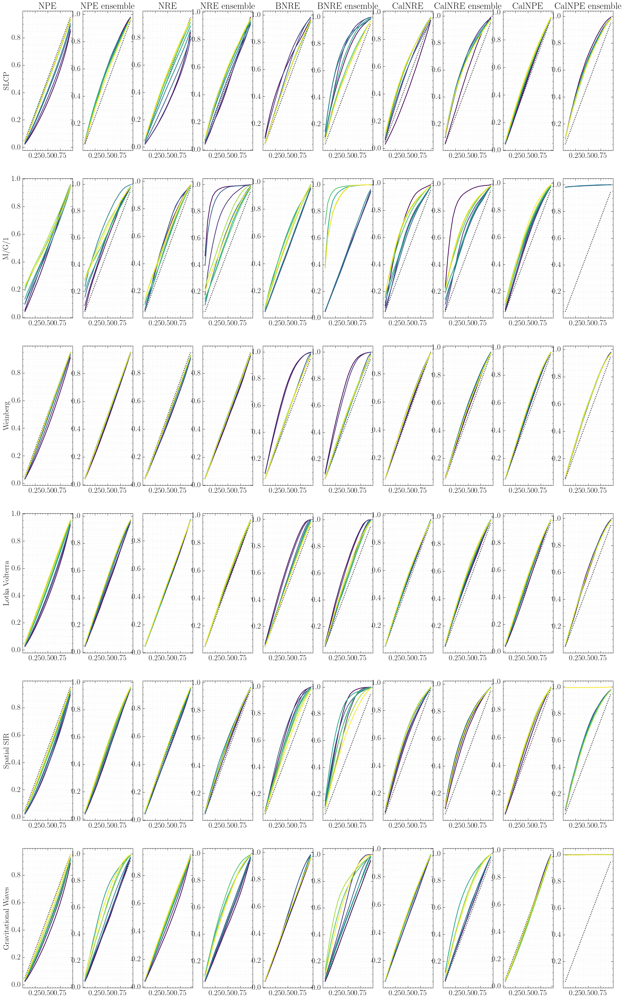

In [29]:
nrows = 6
ncols = 10
res = 5
fig, axes = plt.subplots(nrows, ncols, figsize=(res * nrows, res * ncols))

# Plot tit

# Plot calibration lines
for row in axes:
    for ax in row:
        ax.plot([0.05, 0.95], [0.05, 0.95], ":", color="black")

# Set titles
axes[0][0].set_title(r"NPE")
axes[0][1].set_title(r"NPE ensemble")
axes[0][2].set_title(r"NRE")
axes[0][3].set_title(r"NRE ensemble")
axes[0][4].set_title(r"BNRE")
axes[0][5].set_title(r"BNRE ensemble")
axes[0][6].set_title(r"CalNRE")
axes[0][7].set_title(r"CalNRE ensemble")
axes[0][8].set_title(r"CalNPE")
axes[0][9].set_title(r"CalNPE ensemble")

# Plot results
for index, problem in enumerate(problems):
    axes[index][0].set_ylabel(problem_titles[problem])
    plot_problem(axes[index], problem)

plt.show()

In [30]:
def make_coverage_plot(methods, save_name):
    # Construct grid
    horiz_sizes = [0.75, 0.75]

    for _ in range(len(methods)):
        horiz_sizes += [2.5, 1.0]
    horiz_sizes = horiz_sizes[:-1]

    vert_sizes = [0.75, 0.5]

    for _ in range(len(problems)):
        vert_sizes += [2.5, 0.5]

    vert_sizes.append(0.75)

    fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
    horiz = [Fixed(x) for x in horiz_sizes]
    vert = [Fixed(x) for x in vert_sizes]

    rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
    divider = Divider(fig, rect, horiz, vert, aspect=False)

    title_size = 25

    # Problems
    for i in range(len(problems)):
        ax = fig.add_axes(rect, label="problem_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=0, ny=2 * len(problems) - 2 * i)
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            problem_titles[problems[i]],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
            rotation=90,
        )

    # Metrics
    for i, method in enumerate(methods):
        ax = fig.add_axes(rect, label="method_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=2 + 2 * i, ny=2 * (len(problems) + 1))
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            method_titles[method],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

    # Plots
    for i, problem in enumerate(problems):
        for j, method in enumerate(methods):
            ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j))
            ax.set_axes_locator(
                divider.new_locator(nx=2 + 2 * j, ny=2 * len(problems) - 2 * i)
            )
            method_plot_functions[method](problem, ax)

            if i == 0 and j == 0:
                han, l = ax.get_legend_handles_labels()

    # Legend
    ax_legend = fig.add_axes(rect, label="legend ax")
    ax_legend.set_axes_locator(
        divider.new_locator(nx=2, nx1=2 * len(methods) + 1, ny=0)
    )
    ax_legend.set_axis_off()
    ax_legend.legend(han, l, ncol=4, loc="center")

    plt.savefig(save_name)

NRE-ensemble for spatialsir 65536 failed


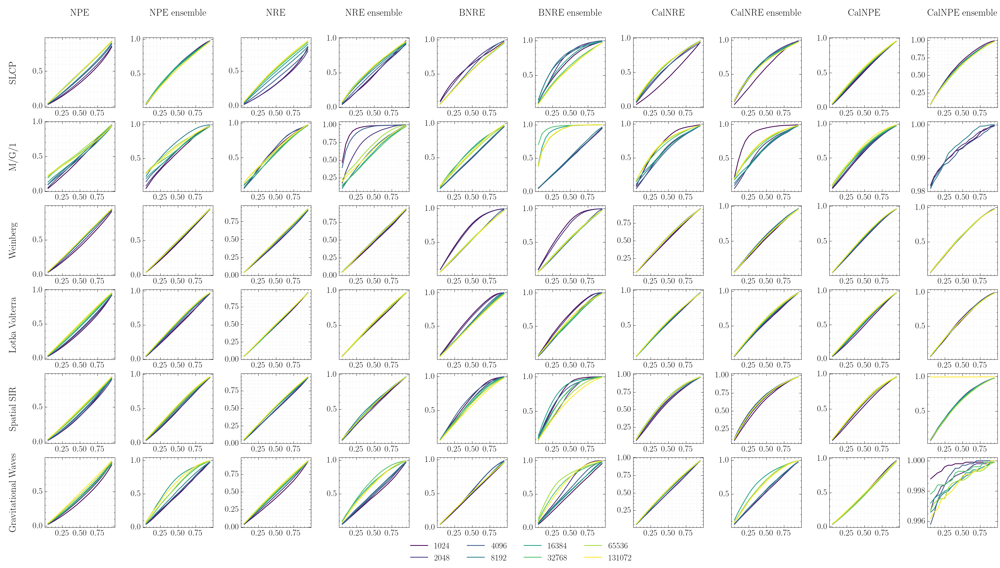

In [31]:
make_coverage_plot(
    [
        "npe",
        "npe_ensemble",
        "nre",
        "nre_ensemble",
        "cnre",
        "cnre_ensemble",
        "calnre",
        "calnre_ensemble",
        "calnpe",
        "calnpe_ensemble",
    ],
    "coverage.pdf",
)

In [32]:
def make_coverage_plot_reversed(methods, save_name):
    plot_problems = [
        "slcp",
        "weinberg",
        "spatialsir",
        "mg1",
        "lotka_volterra",
        "gw",
    ]

    # Construct grid
    horiz_sizes = [0.75, 1.0]

    for _ in range(len(plot_problems)):
        horiz_sizes += [2.5, 0.5]
    horiz_sizes = horiz_sizes[:-1]

    vert_sizes = [0.75, 0.75]

    for _ in range(len(methods)):
        vert_sizes += [2.5, 0.5]

    vert_sizes.append(0.75)

    fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
    horiz = [Fixed(x) for x in horiz_sizes]
    vert = [Fixed(x) for x in vert_sizes]

    rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
    divider = Divider(fig, rect, horiz, vert, aspect=False)

    title_size = 25

    # Problems

    for i in range(len(plot_problems)):
        ax = fig.add_axes(rect, label="problem_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=2 + 2 * i, ny=2 * len(methods) + 1)
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            problem_titles[plot_problems[i]],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

    # Metrics
    for i, method in enumerate(methods):
        ax = fig.add_axes(rect, label="method_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=0, ny=2 * (len(methods)) - 2 * i)
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            method_titles[method],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
            rotation=90,
        )

    # Plots
    for i, method in enumerate(methods):
        for j, problem in enumerate(plot_problems):
            ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j))
            ax.set_axes_locator(
                divider.new_locator(nx=2 + 2 * j, ny=2 * len(methods) - 2 * i)
            )
            method_plot_functions[method](problem, ax)

            ax.plot(
                levels,
                levels,
                color="C3",
                linestyle=":",
                linewidth=5.0,
                alpha=1.0,
                label="Calibrated estimator",
            )
            ax.set_ylim(-0.01, 1.01)
            ax.set_xlim(-0.01, 1.01)
            if i == 0 and j == 0:
                han, l = ax.get_legend_handles_labels()
            if i == len(methods) - 1 and j == 0:
                ax.set_xlabel("Credibility level")
                ax.set_ylabel("Expected coverage")

            if j != 0:
                plt.setp(ax.get_yticklabels(), visible=False)
            if i != len(methods) - 1:
                plt.setp(ax.get_xticklabels(), visible=False)

    # Legend
    ax_legend = fig.add_axes(rect, label="legend ax")
    ax_legend.set_axes_locator(
        divider.new_locator(nx=2, nx1=2 * len(plot_problems) + 1, ny=0)
    )
    ax_legend.set_axis_off()
    ax_legend.legend(han, l, ncol=5, loc="center")

    plt.savefig(save_name)

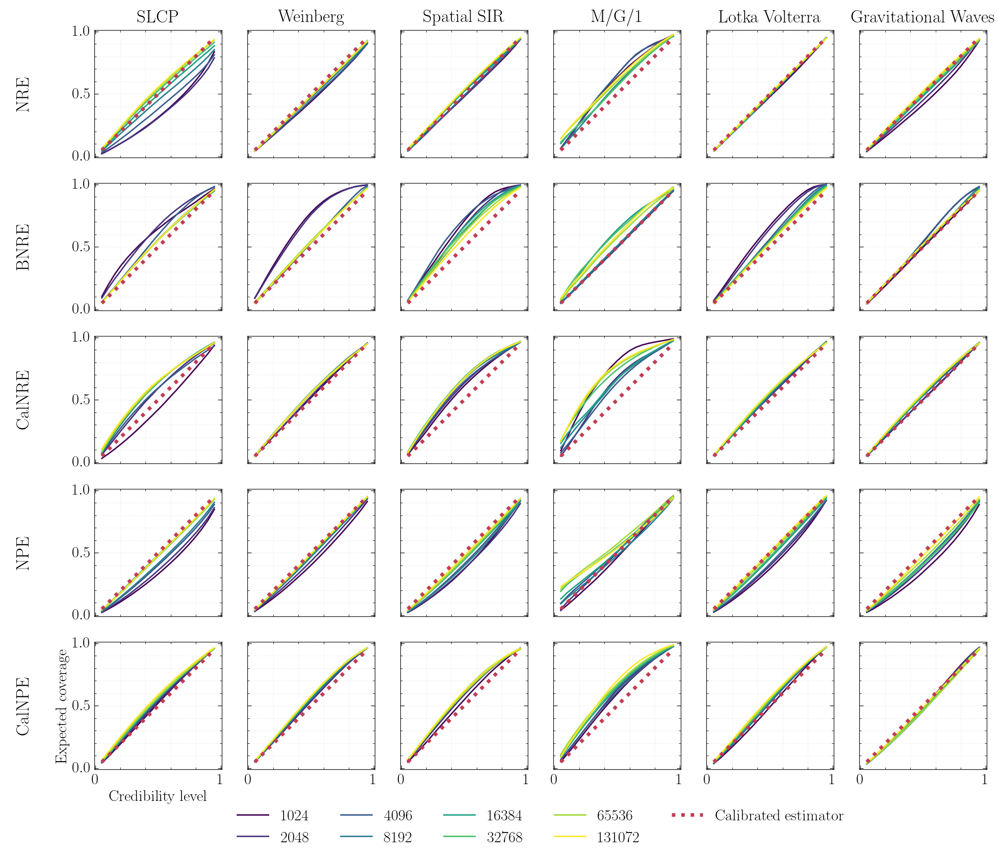

In [33]:
make_coverage_plot_reversed(
    ["nre", "cnre", "calnre", "npe", "calnpe"], "coverage_reversed.pdf"
)

## Area under expected coverage (above calibrated = +, beneath calibrated = -)

In [34]:
def auec_results(method):
    for problem in problems:
        print(problem)
        print("---\n")
        for budget in simulation_budgets:
            try:
                m, s = area_under_expected_coverage(method, problem, budget)
                print(budget, "\t", m, "\t", s)
            except:
                pass
        print("\n")

In [35]:
def make_coverage_stat_plot(methods, save_name, statistic="auc"):
    # Construct grid
    if statistic == "auc":
        x_offset = 3
        horiz_sizes = [5.0, 0.1, 0.75, 0.75]
    if statistic == "kstest":
        x_offset = 0
        horiz_sizes = [0.75]

    for i in range(len(methods)):
        horiz_sizes += [5.0, 0.25]

    horiz_sizes = horiz_sizes[:-1]

    vert_sizes = [0.75, 1]

    for _ in range(1):
        vert_sizes += [5.0, 0.5]

    vert_sizes.append(0.75)

    fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
    horiz = [Fixed(x) for x in horiz_sizes]
    vert = [Fixed(x) for x in vert_sizes]

    rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
    divider = Divider(fig, rect, horiz, vert, aspect=False)

    title_size = 25

    # Metrics
    for i, method in enumerate(methods):
        ax = fig.add_axes(rect, label="method_axes_{}".format(i))
        ax.set_axes_locator(divider.new_locator(nx=1 + x_offset + 2 * i, ny=3))
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            method_titles[method],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

    # Plots
    for i, method in enumerate(methods):
        if i == 0:
            ax = fig.add_axes(rect, label="plot_axes_{}".format(i))
            base_ax = ax
        else:
            ax = fig.add_axes(
                rect, label="plot_axes_{}".format(i), sharey=base_ax
            )

        ax.set_axes_locator(divider.new_locator(nx=1 + x_offset + 2 * i, ny=2))

        for j, problem in enumerate(problems):
            # print("method = {}, problem = {}".format(method, problem))
            if statistic == "auc":
                areas = []
                stds = []
                for budget in simulation_budgets:
                    m, s = area_under_expected_coverage(
                        method, problem, budget
                    )
                    areas.append(m)
                    stds.append(s)
                ax.plot(
                    [
                        simulation_budgets[idx]
                        for idx, val in enumerate(areas)
                        if val is not None
                    ],
                    [val for idx, val in enumerate(areas) if val is not None],
                    label=problem_titles[problem],
                    color=problem_colors[problem],
                )

            if statistic == "kstest":
                areas = []
                stds = []
                for budget in simulation_budgets:
                    m, s = sbc_value(method, problem, budget)
                    if m is None:
                        break
                    areas.append(m)
                    stds.append(s)

                if len(areas) != len(simulation_budgets):
                    continue

                ax.plot(
                    simulation_budgets,
                    areas,
                    label=problem_titles[problem],
                    color=problem_colors[problem],
                )

            # ax.errorbar(simulation_budgets, areas, yerr=stds, color=problem_colors[problem], alpha=0.3)

        if statistic == "auc":
            ax.plot(
                [simulation_budgets[0], simulation_budgets[-1]],
                [0.0, 0.0],
                ":",
                color="black",
                label="Calibrated estimator",
            )
        if statistic == "kstest":
            ax.set_yscale("log")
        ax.set_xscale("log")

        if i == 0:
            ax.set_xlabel("Simulation budget")
            if statistic == "auc":
                ax.set_ylabel("Coverage AUC")
                ax.set_ylim(-0.2, 0.2)
            if statistic == "kstest":
                ax.set_ylabel("KS test p-value")
                ax.set_ylim(1e-5, 1)
            han, l = ax.get_legend_handles_labels()
        else:
            plt.setp(ax.get_yticklabels(), visible=False)

    # Legend
    ax_legend = fig.add_axes(rect, label="legend ax")
    ax_legend.set_axes_locator(
        divider.new_locator(nx=0, nx1=2 * len(methods) + x_offset, ny=0)
    )
    ax_legend.set_axis_off()
    ax_legend.legend(han, l, ncol=4, loc="center")

    if statistic == "auc":
        # Demo
        demo_levels = [0.05 * i for i in range(0, 21)]
        coverages = [
            0.3 * np.sin(level * 2 * np.pi) + level for level in demo_levels
        ]
        ax = fig.add_axes(rect, label="demo_axes")
        ax.set_axes_locator(divider.new_locator(nx=0, ny=2))
        ax.plot(demo_levels, coverages)
        ax.plot([0, 1], [0, 1], ":", color="tab:gray")
        ax.set_xlabel("Credibility level")
        ax.set_ylabel("Expected coverage")
        ax.fill_between(
            demo_levels[:11],
            coverages[:11],
            y2=demo_levels[:11],
            zorder=2,
            fc="c",
        )
        ax.fill_between(
            demo_levels[10:],
            coverages[10:],
            y2=demo_levels[10:],
            zorder=2,
            fc="r",
        )
        ax.text(
            0.3,
            0.4,
            "AUC +",
            rotation=45,
            horizontalalignment="center",
            verticalalignment="center",
            fontdict={"fontsize": 30},
        )
        ax.text(
            0.75,
            0.6,
            "AUC -",
            rotation=45,
            horizontalalignment="center",
            verticalalignment="center",
            fontdict={"fontsize": 30},
        )

    plt.savefig(save_name)

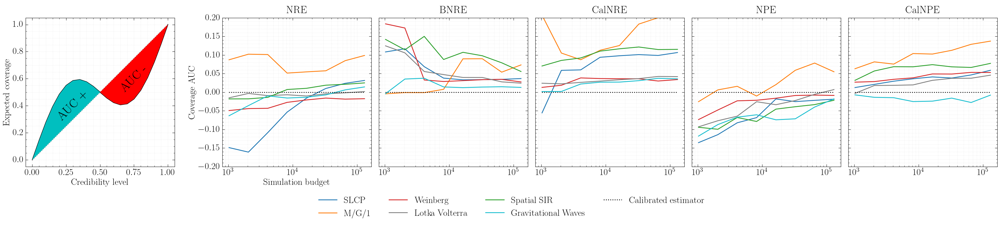

In [36]:
make_coverage_stat_plot(["nre", "cnre", "calnre", "npe", "calnpe"], "auc.pdf")

In [37]:
def make_auc_plot_grid(methods, save_name):
    plot_problems = [
        "slcp",
        "weinberg",
        "spatialsir",
        "mg1",
        "lotka_volterra",
        "gw",
    ]

    # Construct grid
    horiz_sizes = [0.75, 1.0]

    for _ in range(len(plot_problems)):
        horiz_sizes += [2.5, 0.5]
    horiz_sizes = horiz_sizes[:-1]

    vert_sizes = [0.75, 0.75]

    for _ in range(len(methods)):
        vert_sizes += [2.5, 0.5]

    vert_sizes.append(0.75)

    fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
    horiz = [Fixed(x) for x in horiz_sizes]
    vert = [Fixed(x) for x in vert_sizes]

    rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
    divider = Divider(fig, rect, horiz, vert, aspect=False)

    title_size = 25

    # Problems

    for i in range(len(plot_problems)):
        ax = fig.add_axes(rect, label="problem_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=2 + 2 * i, ny=2 * len(methods) + 1)
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            problem_titles[plot_problems[i]],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

    # Metrics
    for i, method in enumerate(methods):
        ax = fig.add_axes(rect, label="method_axes_{}".format(i))
        ax.set_axes_locator(
            divider.new_locator(nx=0, ny=2 * (len(methods)) - 2 * i)
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            method_titles[method],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
            rotation=90,
        )

    # Plots
    for i, method in enumerate(methods):
        for j, problem in enumerate(plot_problems):
            if i == 0 and j == 0:
                ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j))
                base_ax = ax
            else:
                ax = fig.add_axes(
                    rect, label="plot_axes_{}_{}".format(i, j), sharey=base_ax
                )

            ax.set_axes_locator(
                divider.new_locator(nx=2 + 2 * j, ny=2 * len(methods) - 2 * i)
            )
            areas = []
            stds = []
            for budget in simulation_budgets:
                m, s = area_under_expected_coverage(method, problem, budget)
                areas.append(m)
                stds.append(s)

            # areas = np.array(areas)
            # stds = np.array(stds)
            try:
                ax.plot(
                    [
                        simulation_budgets[idx]
                        for idx, val in enumerate(areas)
                        if val is not None
                    ],
                    [val for idx, val in enumerate(areas) if val is not None],
                    label=problem_titles[problem],
                    color=problem_colors[problem],
                    marker=".",
                )
                ax.fill_between(
                    [
                        simulation_budgets[idx]
                        for idx, val in enumerate(areas)
                        if val is not None
                    ],
                    y1=[
                        val - stds[idx]
                        for idx, val in enumerate(areas)
                        if val is not None
                    ],
                    y2=[
                        val + stds[idx]
                        for idx, val in enumerate(areas)
                        if val is not None
                    ],
                    color=problem_colors[problem],
                    alpha=0.3,
                )
            except:
                pass
            ax.plot(
                [simulation_budgets[0], simulation_budgets[-1]],
                [0.0, 0.0],
                ":",
                color="black",
                label="Calibrated estimator",
            )

            ax.set_xscale("log")
            ax.set_ylim(-0.2, 0.2)

            if i == 0 and j == 0:
                han, l = ax.get_legend_handles_labels()
            if i == len(methods) - 1 and j == 0:
                ax.set_xlabel("Simulation budget")
                ax.set_ylabel("Coverage AUC")

            if j != 0:
                plt.setp(ax.get_yticklabels(), visible=False)
            if i != len(methods) - 1:
                plt.setp(ax.get_xticklabels(), visible=False)

    plt.savefig(save_name)

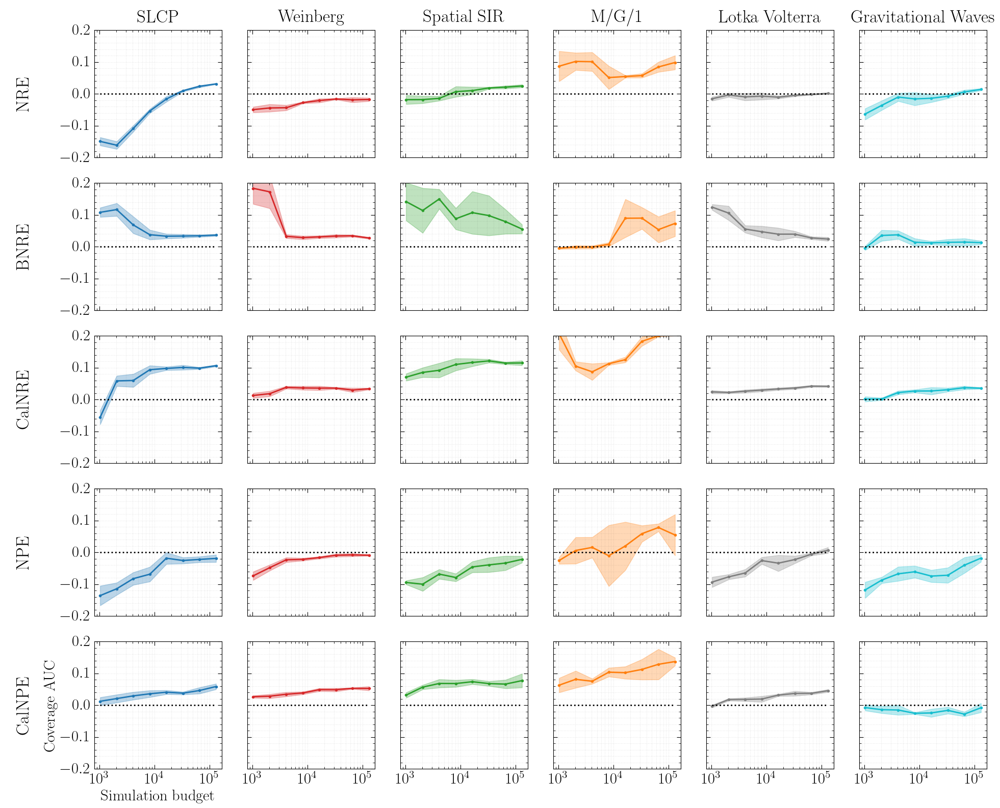

In [38]:
make_auc_plot_grid(["nre", "cnre", "calnre", "npe", "calnpe"], "auc_grid.pdf")

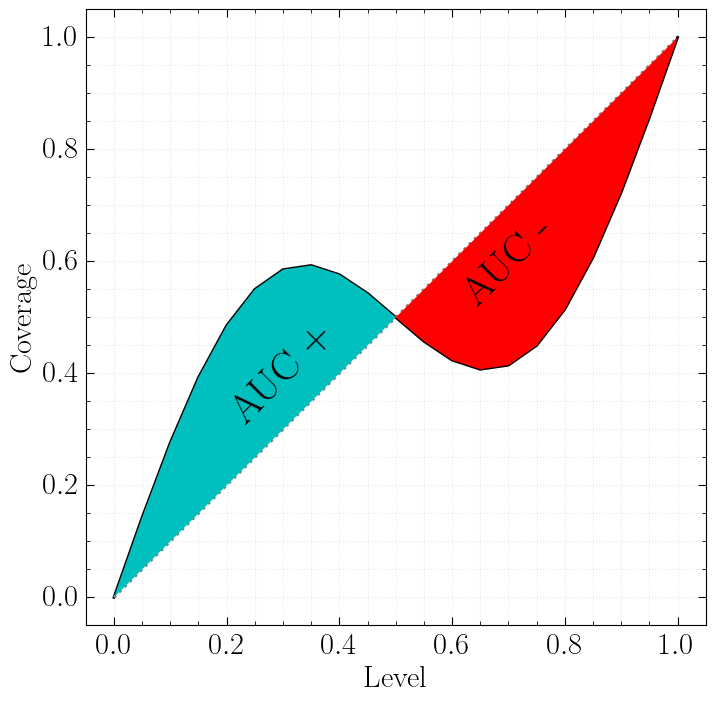

In [39]:
demo_levels = [0.05 * i for i in range(0, 21)]
# coverages = [np.sqrt(1 - (1-level)**2) for level in demo_levels]
coverages = [0.3 * np.sin(level * 2 * np.pi) + level for level in demo_levels]
plt.plot(demo_levels, coverages)
plt.plot([0, 1], [0, 1], ":", color="tab:gray")
plt.xlabel("Level")
plt.ylabel("Coverage")
# plt.fill_between(demo_levels, coverages, y2=demo_levels, hatch='\\', zorder=2, fc='c')
plt.fill_between(
    demo_levels[:11], coverages[:11], y2=demo_levels[:11], zorder=2, fc="c"
)
plt.fill_between(
    demo_levels[10:], coverages[10:], y2=demo_levels[10:], zorder=2, fc="r"
)
# plt.text(0.4, 0.6, "Coverage auc", rotation = 45, horizontalalignment='center', verticalalignment='center',
#         fontdict = {'fontsize': 30})
plt.text(
    0.3,
    0.4,
    "AUC +",
    rotation=45,
    horizontalalignment="center",
    verticalalignment="center",
    fontdict={"fontsize": 30},
)
plt.text(
    0.7,
    0.6,
    "AUC -",
    rotation=45,
    horizontalalignment="center",
    verticalalignment="center",
    fontdict={"fontsize": 30},
)

plt.savefig("auc_demo.pdf")

## SBC

In [40]:
def sbc_value(method, problem, simulations):
    TOT_SAMPLES = 10000

    method_name = method.split(" ")[0]
    if method_name == "npe":
        query = (
            "../casbi/workflows/coverage_simulations_and_bias_reduction/"
            + problem
            + "/output/"
            + str(simulations)
            + "/without-regularization/"
        )
        if "ensemble" not in method:
            query += "/flow-sbi-0*/coverage.npy"
        else:
            query += "/coverage-flow-sbi.npy"
    else:
        if method_name == "cnre":
            query_prefix = "../bnre/"
        elif method_name == "calnre":
            query_prefix = "./"
        else:
            query_prefix = f"../{method_name}/"
        query = (
            query_prefix
            + problem
            + "/output/estimator/"
            + str(simulations)
            + "/"
            + batch_size
            + "/"
            + problem_lrs[method.replace(" ", "_")][problem]
        )
        if "ensemble" not in method:
            query += "/*/coverage.npy"
        else:
            query += "/coverage.npy"
    files = glob.glob(query)
    if len(files) == 0:
        return None, None

    p_values = []
    for f in files:
        cov = np.load(f)
        if method != "npe":
            cov = np.flip(cov)
        # prop_samples [i] = prop of samples that are ranked between i*0.05 and (i+1)*0.05
        prop_samples = np.zeros((20,))
        prop_samples[0] = cov[0]
        for i in range(1, 19):
            prop_samples[i] = cov[i] - cov[i - 1]
        prop_samples[19] = 1 - cov[18]

        nb_samples = prop_samples * TOT_SAMPLES
        nb_samples = nb_samples.astype(np.int32)

        ranks = np.concatenate(
            [
                np.random.uniform(
                    low=i * 0.05, high=(i + 1) * 0.05, size=(nb_sample,)
                )
                for i, nb_sample in enumerate(nb_samples)
            ]
        )

        p_value = kstest(ranks, uniform(loc=0, scale=1).cdf)[1]
        p_values.append(p_value)

    return np.mean(p_values), np.std(p_values)

In [41]:
def plot_sbc(method, problem, ax=None):
    if ax is None:
        ax = plt.gca()
        ax.set_xlabel("Simulation budget")
        ax.set_title(method_titles[method])

    data = [sbc_value(method, problem, sim)[0] for sim in simulation_budgets]
    if len(data) == len(simulation_budgets):
        ax.plot(simulation_budgets, data, label=problem_titles[problem])

    ax.set_xscale("log")

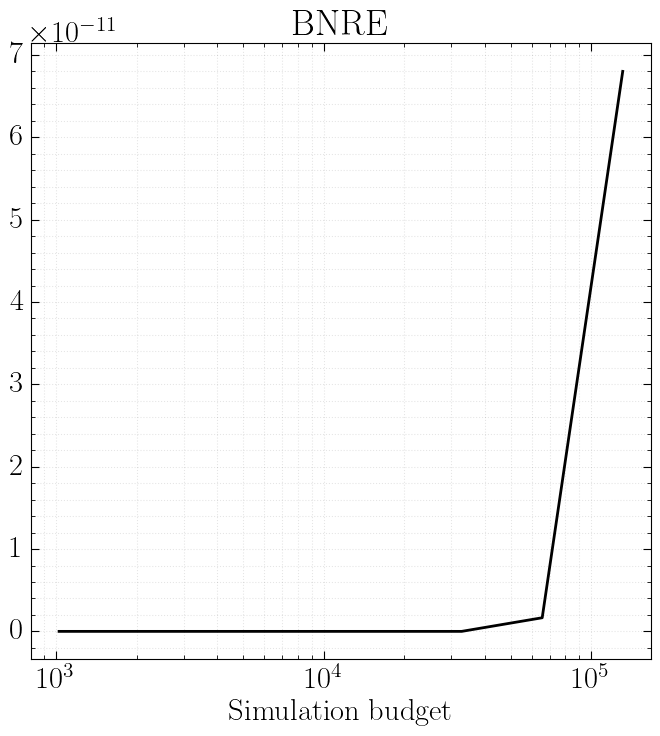

In [42]:
plot_sbc("cnre", "lotka_volterra")

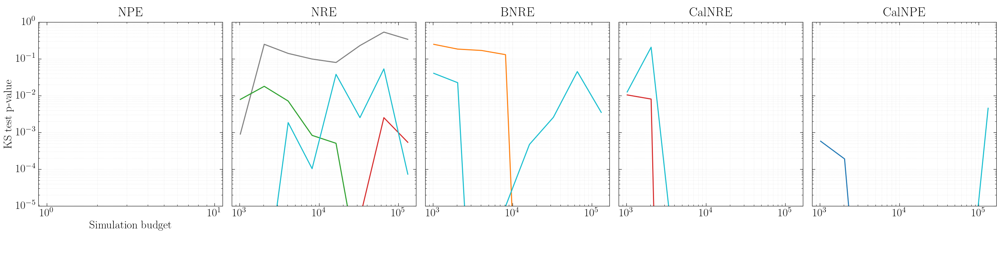

In [43]:
make_coverage_stat_plot(
    ["npe", "nre", "cnre", "calnre", "calnpe"],
    "sbc.pdf",
    statistic="kstest",
)

### C-NRE

In [44]:
auec_results("cnre")

slcp
---

1024 	 0.10821789473684214 	 0.014701916734857063
2048 	 0.11676631578947369 	 0.020152775384017746
4096 	 0.06861894736842107 	 0.026304234642178872
8192 	 0.037864210526315806 	 0.015085656595025835
16384 	 0.03320947368421055 	 0.007357789623524471
32768 	 0.03366526315789477 	 0.0057140101912206845
65536 	 0.034538947368421065 	 0.003583434648227352
131072 	 0.03664526315789475 	 0.002909370856587977


mg1
---

1024 	 -0.004401052631578935 	 0.002819507432276932
2048 	 -0.0010421052631578594 	 0.0051109951543847135
4096 	 -0.0011063157894736697 	 0.004729590238352014
8192 	 0.007755789473684227 	 0.005775748899169728
16384 	 0.08964631578947371 	 0.05978276976871209
32768 	 0.08997473684210526 	 0.03399024292132105
65536 	 0.05387578947368423 	 0.04066851955877535
131072 	 0.07334315789473686 	 0.040449327199770915


weinberg
---

1024 	 0.1837021052631579 	 0.04927932939699132
2048 	 0.17253473684210527 	 0.05158647201826133
4096 	 0.032811578947368435 	 0.00596183094819

### C-NRE ensemble

In [45]:
auec_results("cnre ensemble")

slcp
---

1024 	 0.16855263157894745 	 0.0
2048 	 0.2228421052631579 	 0.0
4096 	 0.24278421052631582 	 0.0
8192 	 0.24531052631578945 	 0.0
16384 	 0.19081578947368416 	 0.0
32768 	 0.10153157894736843 	 0.0
65536 	 0.08607894736842106 	 0.0
131072 	 0.0806 	 0.0


mg1
---

1024 	 -0.004968421052631575 	 0.0
2048 	 0.0031578947368421082 	 0.0
4096 	 -0.004299999999999982 	 0.0
8192 	 0.01734736842105264 	 0.0
16384 	 0.4176 	 0.0
32768 	 0.46288947368421063 	 0.0
65536 	 0.3919789473684212 	 0.0
131072 	 0.3959421052631579 	 0.0


weinberg
---

1024 	 0.20987368421052635 	 0.0
2048 	 0.18599473684210538 	 0.0
4096 	 0.03776842105263163 	 0.0
8192 	 0.03311052631578949 	 0.0
16384 	 0.03685789473684209 	 0.0
32768 	 0.04458947368421054 	 0.0
65536 	 0.0479684210526316 	 0.0
131072 	 0.04094736842105264 	 0.0


lotka_volterra
---

1024 	 0.13999473684210526 	 0.0
2048 	 0.12543157894736845 	 0.0
4096 	 0.06852105263157897 	 0.0
8192 	 0.07348421052631583 	 0.0
16384 	 0.0579736842105263

### NRE

In [46]:
auec_results("nre")

slcp
---

1024 	 -0.14898105263157896 	 0.01277573990788423
2048 	 -0.16103684210526314 	 0.011974546874649813
4096 	 -0.10864421052631579 	 0.009859615495978118
8192 	 -0.053541052631578934 	 0.006569889680619634
16384 	 -0.015977894736842087 	 0.008679750944254888
32768 	 0.010027368421052632 	 0.0027348502873435075
65536 	 0.023886315789473707 	 0.0032228986798031756
131072 	 0.03158842105263161 	 0.001287060685343225


mg1
---

1024 	 0.08712947368421056 	 0.047283976612816
2048 	 0.1021557894736842 	 0.027189937971054765
4096 	 0.10123368421052632 	 0.029508322991348965
8192 	 0.05140947368421054 	 0.03637585016664572
16384 	 0.05464631578947371 	 0.0037263030032489365
32768 	 0.05756105263157898 	 0.006561425593358085
65536 	 0.08476000000000003 	 0.015721208428738344
131072 	 0.09872 	 0.022001875367058832


weinberg
---

1024 	 -0.049303157894736827 	 0.008737035254681717
2048 	 -0.04407052631578945 	 0.011721416627534094
4096 	 -0.04330315789473682 	 0.00834702302331799
8192 	

### NRE ensemble

In [47]:
auec_results("nre ensemble")

slcp
---

1024 	 -0.020789473684210528 	 0.0
2048 	 -0.02493684210526313 	 0.0
4096 	 0.0013105263157894929 	 0.0
8192 	 0.033778947368421054 	 0.0
16384 	 0.0512578947368421 	 0.0
32768 	 0.06607368421052635 	 0.0
65536 	 0.06337894736842106 	 0.0
131072 	 0.06857368421052633 	 0.0


mg1
---

1024 	 0.43192105263157893 	 0.0
2048 	 0.279721052631579 	 0.0
4096 	 0.4031736842105264 	 0.0
8192 	 0.12476315789473684 	 0.0
16384 	 0.09675263157894738 	 0.0
32768 	 0.0860421052631579 	 0.0
65536 	 0.1909157894736842 	 0.0
131072 	 0.13528947368421052 	 0.0


weinberg
---

1024 	 -0.028331578947368416 	 0.0
2048 	 -0.019315789473684186 	 0.0
4096 	 -0.014526315789473651 	 0.0
8192 	 -0.0012315789473683848 	 0.0
16384 	 -0.003531578947368412 	 0.0
32768 	 -0.0034263157894736575 	 0.0
65536 	 -0.004252631578947356 	 0.0
131072 	 -0.007536842105263152 	 0.0


lotka_volterra
---

1024 	 0.013284210526315782 	 0.0
2048 	 0.022894736842105277 	 0.0
4096 	 0.024557894736842122 	 0.0
8192 	 0.03249

### CalNRE

In [48]:
auec_results("calnre")

slcp
---

1024 	 -0.05560631578947367 	 0.021980948537653196
2048 	 0.05874631578947369 	 0.016118118158271116
4096 	 0.06001473684210529 	 0.02048783475268156
8192 	 0.09383263157894739 	 0.013196823003894628
16384 	 0.09793473684210528 	 0.005413526303252898
32768 	 0.10104736842105262 	 0.0074196280827563315
65536 	 0.09879052631578951 	 0.0029755111295363076
131072 	 0.1066347368421053 	 0.0024987589163190022


mg1
---

1024 	 0.20711789473684208 	 0.0502750450093535
2048 	 0.10523789473684213 	 0.013931097321323143
4096 	 0.08729368421052633 	 0.02569694796325117
8192 	 0.11269368421052635 	 0.004046794703023732
16384 	 0.12545894736842106 	 0.008698692486203257
32768 	 0.18309157894736844 	 0.01460332205213764
65536 	 0.20029473684210522 	 0.0020211376078626995
131072 	 0.2080147368421053 	 0.006953230700510048


weinberg
---

1024 	 0.012964210526315809 	 0.0077734261440255805
2048 	 0.018631578947368437 	 0.008504216975782729
4096 	 0.038383157894736855 	 0.0040075543622961635


### CalNRE ensemble

In [49]:
auec_results("calnre ensemble")

slcp
---

1024 	 0.07153157894736843 	 0.0
2048 	 0.15901052631578952 	 0.0
4096 	 0.1403105263157895 	 0.0
8192 	 0.16240526315789472 	 0.0
16384 	 0.1501052631578948 	 0.0
32768 	 0.1420631578947368 	 0.0
65536 	 0.13903684210526315 	 0.0
131072 	 0.13942105263157897 	 0.0


mg1
---

1024 	 0.35678421052631587 	 0.0
2048 	 0.1393052631578948 	 0.0
4096 	 0.11676315789473687 	 0.0
8192 	 0.12312631578947375 	 0.0
16384 	 0.14278947368421052 	 0.0
32768 	 0.20307894736842105 	 0.0
65536 	 0.21072631578947373 	 0.0
131072 	 0.2205105263157895 	 0.0


weinberg
---

1024 	 0.030847368421052658 	 0.0
2048 	 0.03875789473684214 	 0.0
4096 	 0.061642105263157956 	 0.0
8192 	 0.05686315789473686 	 0.0
16384 	 0.050273684210526325 	 0.0
32768 	 0.048247368421052664 	 0.0
65536 	 0.040663157894736866 	 0.0
131072 	 0.04401578947368422 	 0.0


lotka_volterra
---

1024 	 0.039200000000000026 	 0.0
2048 	 0.04496842105263159 	 0.0
4096 	 0.05181052631578947 	 0.0
8192 	 0.06003157894736846 	 0.0
1

### NPE

In [50]:
auec_results("npe")

slcp
---

1024 	 -0.13558778947368416 	 0.030854847043586243
2048 	 -0.11408526315789472 	 0.01928627812692018
4096 	 -0.08227284210526313 	 0.019708576871061704
8192 	 -0.06835042105263156 	 0.022947207209477176
16384 	 -0.018084315789473667 	 0.018169300147665445
32768 	 -0.025312105263157875 	 0.009664952218456207
65536 	 -0.021909157894736818 	 0.008976141491618895
131072 	 -0.01874347368421051 	 0.011557161478993166


mg1
---

1024 	 -0.02546105263157893 	 0.010440783872250016
2048 	 0.00620000000000002 	 0.04152853012573925
4096 	 0.0158463157894737 	 0.03215893811727969
8192 	 -0.01025052631578945 	 0.09579481544388496
16384 	 0.02035157894736844 	 0.07551950560897377
32768 	 0.05889473684210528 	 0.025777185472016247
65536 	 0.07831157894736843 	 0.011880219552706024
131072 	 0.054901052631578975 	 0.06450494111504054


weinberg
---

1024 	 -0.07358473684210524 	 0.013296948872108937
2048 	 -0.04785452631578946 	 0.009236972916152763
4096 	 -0.023203684210526297 	 0.00741619912

### NPE ensemble

In [51]:
auec_results("npe ensemble")

slcp
---

1024 	 0.07777631578947371 	 0.0
2048 	 0.08345000000000002 	 0.0
4096 	 0.08330526315789476 	 0.0
8192 	 0.0707763157894737 	 0.0
16384 	 0.08397368421052633 	 0.0
32768 	 0.06919473684210527 	 0.0
65536 	 0.05453684210526318 	 0.0
131072 	 0.05161315789473687 	 0.0


mg1
---

1024 	 0.07194736842105263 	 0.0
2048 	 0.09643157894736844 	 0.0
4096 	 0.11075789473684211 	 0.0
8192 	 0.21186315789473686 	 0.0
16384 	 0.12235789473684211 	 0.0
32768 	 0.1372526315789474 	 0.0
65536 	 0.17698947368421056 	 0.0
131072 	 0.16415789473684214 	 0.0


weinberg
---

1024 	 -0.027779473684210493 	 0.0
2048 	 -0.017023684210526305 	 0.0
4096 	 -0.004082105263157876 	 0.0
8192 	 -0.01077421052631577 	 0.0
16384 	 -0.006079473684210509 	 0.0
32768 	 -0.0005468421052631343 	 0.0
65536 	 -0.002224736842105239 	 0.0
131072 	 -0.006512105263157876 	 0.0


lotka_volterra
---

1024 	 -0.012402631578947353 	 0.0
2048 	 -0.004113157894736812 	 0.0
4096 	 0.013247368421052653 	 0.0
8192 	 0.0281026

### CalNPE

In [52]:
auec_results("calnpe")

slcp
---

1024 	 0.012509473684210543 	 0.012550711052463824
2048 	 0.021061052631578973 	 0.012515250574914927
4096 	 0.02954 	 0.012054969481366418
8192 	 0.03608526315789476 	 0.010503356751395777
16384 	 0.041087368421052636 	 0.006263613075012104
32768 	 0.03809052631578949 	 0.004302923569683463
65536 	 0.046372631578947374 	 0.009736109446119348
131072 	 0.05894105263157897 	 0.008888711381730247


mg1
---

1024 	 0.06311684210526318 	 0.022546565271459113
2048 	 0.08152315789473685 	 0.02670320150538356
4096 	 0.0755347368421053 	 0.008135964138648491
8192 	 0.10390105263157896 	 0.013687980614261502
16384 	 0.1025221052631579 	 0.019237189974534833
32768 	 0.11258421052631581 	 0.03189179211697162
65536 	 0.1287084210526316 	 0.047661211904667385
131072 	 0.13729894736842102 	 0.012453255934875077


weinberg
---

1024 	 0.026969473684210543 	 0.0037076164775497558
2048 	 0.02854105263157895 	 0.006456122864202102
4096 	 0.03462842105263158 	 0.006762986768263028
8192 	 0.03859

### CalNPE ensemble

In [53]:
auec_results("calnpe ensemble")

slcp
---

1024 	 0.14918421052631575 	 0.0
2048 	 0.13130000000000006 	 0.0
4096 	 0.1313842105263158 	 0.0
8192 	 0.13054736842105266 	 0.0
16384 	 0.12331052631578954 	 0.0
32768 	 0.11233157894736845 	 0.0
65536 	 0.11406842105263156 	 0.0
131072 	 0.11711578947368424 	 0.0


mg1
---

1024 	 0.49274210526315787 	 0.0
2048 	 0.49291578947368436 	 0.0
4096 	 0.49218947368421057 	 0.0
8192 	 0.4936631578947369 	 0.0
16384 	 None 	 None
32768 	 None 	 None
65536 	 None 	 None
131072 	 None 	 None


weinberg
---

1024 	 0.06730000000000003 	 0.0
2048 	 0.06881578947368419 	 0.0
4096 	 0.07123684210526318 	 0.0
8192 	 0.06604210526315792 	 0.0
16384 	 0.07131578947368418 	 0.0
32768 	 0.07054736842105265 	 0.0
65536 	 0.07524736842105263 	 0.0
131072 	 0.0686 	 0.0


lotka_volterra
---

1024 	 0.07282105263157898 	 0.0
2048 	 0.08898421052631582 	 0.0
4096 	 0.08063157894736844 	 0.0
8192 	 0.07513157894736844 	 0.0
16384 	 0.07687368421052632 	 0.0
32768 	 0.07849473684210528 	 0.0
65536

## Metrics

### CalNRE

In [54]:
for problem in problems:
    print(problem)
    print("--")
    learning_rate = problem_lrs["calnre"][problem]
    for budget in simulation_budgets:
        # Balancing condition
        conditions_met = True
        paths = glob.glob(
            problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/balancing.npy"
        )
        balancing_values = [np.load(p) for p in paths]
        if len(balancing_values) < 2:
            continue
        balancing = np.mean(balancing_values)
        balanced = np.abs(balancing - 1) <= 0.01
        conditions_met &= balanced
        # E_marginals[rhat]
        paths = glob.glob(
            problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/marginal_rhat.npy"
        )
        rhat_values = [np.load(p) for p in paths]
        if len(rhat_values) < 2:
            continue
        marginals_rhat = np.mean(rhat_values)
        conditions_met &= marginals_rhat <= 1.001
        # Output
        print(
            "> ",
            budget,
            "\t",
            balancing,
            "+-",
            np.std(balancing_values),
            "\t",
            balanced,
            "\t",
            marginals_rhat,
            "+-",
            np.std(rhat_values),
            "\t",
            conditions_met,
        )
    print("\n")

slcp
--
>  1024 	 0.95961666 +- 0.017243484 	 False 	 1.1431344 +- 0.06966987 	 False
>  2048 	 0.99235 +- 0.005120697 	 True 	 0.89262754 +- 0.031196939 	 True
>  4096 	 0.9714077 +- 0.010831708 	 False 	 0.83774424 +- 0.054157943 	 False
>  8192 	 0.9857752 +- 0.0022407447 	 False 	 0.7886144 +- 0.04068623 	 False
>  16384 	 0.98464525 +- 0.0022055346 	 False 	 0.7409123 +- 0.014701942 	 False
>  32768 	 0.98245984 +- 0.0025294179 	 False 	 0.70807576 +- 0.012928189 	 False
>  65536 	 0.98163235 +- 0.0056488966 	 False 	 0.7204431 +- 0.028051892 	 False
>  131072 	 0.97884256 +- 0.0039830385 	 False 	 0.71310663 +- 0.04909503 	 False


mg1
--
>  1024 	 1.0046346 +- 0.0070788455 	 True 	 0.9209607 +- 0.31018522 	 True
>  2048 	 0.99218595 +- 0.0040313154 	 True 	 0.7312762 +- 0.066700175 	 True
>  4096 	 0.98866576 +- 0.0017461182 	 False 	 0.87582225 +- 0.37350088 	 False
>  8192 	 0.9895035 +- 0.0027871358 	 False 	 0.6391947 +- 0.037446063 	 False
>  16384 	 0.9896904 +- 0.00172503

### BNRE

In [55]:
for problem in problems:
    print(problem)
    print("--")
    learning_rate = problem_lrs["cnre"][problem]
    for budget in simulation_budgets:
        # Balancing condition
        conditions_met = True
        paths = glob.glob(
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/balancing.npy"
        )
        balancing_values = [np.load(p) for p in paths]
        if len(balancing_values) < 2:
            continue
        balancing = np.mean(balancing_values)
        balanced = np.abs(balancing - 1) <= 0.01
        conditions_met &= balanced
        # E_marginals[rhat]
        paths = glob.glob(
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/marginal_rhat.npy"
        )
        rhat_values = [np.load(p) for p in paths]
        if len(rhat_values) < 2:
            continue
        marginals_rhat = np.mean(rhat_values)
        conditions_met &= marginals_rhat <= 1.001
        # Output
        print(
            "> ",
            budget,
            "\t",
            balancing,
            "+-",
            np.std(balancing_values),
            "\t",
            balanced,
            "\t",
            marginals_rhat,
            "+-",
            np.std(rhat_values),
            "\t",
            conditions_met,
        )
    print("\n")

slcp
--
>  1024 	 0.9909027 +- 0.004357647 	 True 	 0.9422537 +- 0.020838896 	 True
>  2048 	 0.9872602 +- 0.0057328395 	 False 	 0.9071042 +- 0.03452527 	 False
>  4096 	 0.98219615 +- 0.0058207954 	 False 	 0.8522936 +- 0.043137055 	 False
>  8192 	 0.9751239 +- 0.007592416 	 False 	 0.8880515 +- 0.03041744 	 False
>  16384 	 0.9737908 +- 0.005728409 	 False 	 0.83917844 +- 0.018882032 	 False
>  32768 	 0.9800519 +- 0.0029350256 	 False 	 0.8471907 +- 0.031983547 	 False
>  65536 	 0.98668015 +- 0.002400207 	 False 	 0.79719347 +- 0.048074193 	 False
>  131072 	 0.9891712 +- 0.0014909841 	 False 	 0.81568754 +- 0.025850238 	 False


mg1
--
>  1024 	 0.9999372 +- 0.00014771312 	 True 	 0.9998997 +- 0.0002938406 	 True
>  2048 	 1.0000236 +- 8.312057e-05 	 True 	 1.0000585 +- 0.00018099388 	 True
>  4096 	 0.99999076 +- 2.8587261e-05 	 True 	 0.9999666 +- 4.9196038e-05 	 True
>  8192 	 0.99999046 +- 6.07488e-06 	 True 	 0.9999407 +- 1.47357105e-05 	 True
>  16384 	 0.9974588 +- 0.0032

In [56]:
auec_results("npe ensemble")

slcp
---

1024 	 0.07777631578947371 	 0.0
2048 	 0.08345000000000002 	 0.0
4096 	 0.08330526315789476 	 0.0
8192 	 0.0707763157894737 	 0.0
16384 	 0.08397368421052633 	 0.0
32768 	 0.06919473684210527 	 0.0
65536 	 0.05453684210526318 	 0.0
131072 	 0.05161315789473687 	 0.0


mg1
---

1024 	 0.07194736842105263 	 0.0
2048 	 0.09643157894736844 	 0.0
4096 	 0.11075789473684211 	 0.0
8192 	 0.21186315789473686 	 0.0
16384 	 0.12235789473684211 	 0.0
32768 	 0.1372526315789474 	 0.0
65536 	 0.17698947368421056 	 0.0
131072 	 0.16415789473684214 	 0.0


weinberg
---

1024 	 -0.027779473684210493 	 0.0
2048 	 -0.017023684210526305 	 0.0
4096 	 -0.004082105263157876 	 0.0
8192 	 -0.01077421052631577 	 0.0
16384 	 -0.006079473684210509 	 0.0
32768 	 -0.0005468421052631343 	 0.0
65536 	 -0.002224736842105239 	 0.0
131072 	 -0.006512105263157876 	 0.0


lotka_volterra
---

1024 	 -0.012402631578947353 	 0.0
2048 	 -0.004113157894736812 	 0.0
4096 	 0.013247368421052653 	 0.0
8192 	 0.0281026

## Metrics

### CalNRE

In [57]:
for problem in problems:
    print(problem)
    print("--")
    learning_rate = problem_lrs["calnre"][problem]
    for budget in simulation_budgets:
        # Balancing condition
        conditions_met = True
        paths = glob.glob(
            problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/balancing.npy"
        )
        balancing_values = [np.load(p) for p in paths]
        if len(balancing_values) < 2:
            continue
        balancing = np.mean(balancing_values)
        balanced = np.abs(balancing - 1) <= 0.01
        conditions_met &= balanced
        # E_marginals[rhat]
        paths = glob.glob(
            problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/marginal_rhat.npy"
        )
        rhat_values = [np.load(p) for p in paths]
        if len(rhat_values) < 2:
            continue
        marginals_rhat = np.mean(rhat_values)
        conditions_met &= marginals_rhat <= 1.001
        # Output
        print(
            "> ",
            budget,
            "\t",
            balancing,
            "+-",
            np.std(balancing_values),
            "\t",
            balanced,
            "\t",
            marginals_rhat,
            "+-",
            np.std(rhat_values),
            "\t",
            conditions_met,
        )
    print("\n")

slcp
--
>  1024 	 0.95961666 +- 0.017243484 	 False 	 1.1431344 +- 0.06966987 	 False
>  2048 	 0.99235 +- 0.005120697 	 True 	 0.89262754 +- 0.031196939 	 True
>  4096 	 0.9714077 +- 0.010831708 	 False 	 0.83774424 +- 0.054157943 	 False
>  8192 	 0.9857752 +- 0.0022407447 	 False 	 0.7886144 +- 0.04068623 	 False
>  16384 	 0.98464525 +- 0.0022055346 	 False 	 0.7409123 +- 0.014701942 	 False
>  32768 	 0.98245984 +- 0.0025294179 	 False 	 0.70807576 +- 0.012928189 	 False
>  65536 	 0.98163235 +- 0.0056488966 	 False 	 0.7204431 +- 0.028051892 	 False
>  131072 	 0.97884256 +- 0.0039830385 	 False 	 0.71310663 +- 0.04909503 	 False


mg1
--
>  1024 	 1.0046346 +- 0.0070788455 	 True 	 0.9209607 +- 0.31018522 	 True
>  2048 	 0.99218595 +- 0.0040313154 	 True 	 0.7312762 +- 0.066700175 	 True
>  4096 	 0.98866576 +- 0.0017461182 	 False 	 0.87582225 +- 0.37350088 	 False
>  8192 	 0.9895035 +- 0.0027871358 	 False 	 0.6391947 +- 0.037446063 	 False
>  16384 	 0.9896904 +- 0.00172503

### BNRE

In [58]:
for problem in problems:
    print(problem)
    print("--")
    learning_rate = problem_lrs["cnre"][problem]
    for budget in simulation_budgets:
        # Balancing condition
        conditions_met = True
        paths = glob.glob(
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/balancing.npy"
        )
        balancing_values = [np.load(p) for p in paths]
        if len(balancing_values) < 2:
            continue
        balancing = np.mean(balancing_values)
        balanced = np.abs(balancing - 1) <= 0.01
        conditions_met &= balanced
        # E_marginals[rhat]
        paths = glob.glob(
            "../bnre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/marginal_rhat.npy"
        )
        rhat_values = [np.load(p) for p in paths]
        if len(rhat_values) < 2:
            continue
        marginals_rhat = np.mean(rhat_values)
        conditions_met &= marginals_rhat <= 1.001
        # Output
        print(
            "> ",
            budget,
            "\t",
            balancing,
            "+-",
            np.std(balancing_values),
            "\t",
            balanced,
            "\t",
            marginals_rhat,
            "+-",
            np.std(rhat_values),
            "\t",
            conditions_met,
        )
    print("\n")

slcp
--
>  1024 	 0.9909027 +- 0.004357647 	 True 	 0.9422537 +- 0.020838896 	 True
>  2048 	 0.9872602 +- 0.0057328395 	 False 	 0.9071042 +- 0.03452527 	 False
>  4096 	 0.98219615 +- 0.0058207954 	 False 	 0.8522936 +- 0.043137055 	 False
>  8192 	 0.9751239 +- 0.007592416 	 False 	 0.8880515 +- 0.03041744 	 False
>  16384 	 0.9737908 +- 0.005728409 	 False 	 0.83917844 +- 0.018882032 	 False
>  32768 	 0.9800519 +- 0.0029350256 	 False 	 0.8471907 +- 0.031983547 	 False
>  65536 	 0.98668015 +- 0.002400207 	 False 	 0.79719347 +- 0.048074193 	 False
>  131072 	 0.9891712 +- 0.0014909841 	 False 	 0.81568754 +- 0.025850238 	 False


mg1
--
>  1024 	 0.9999372 +- 0.00014771312 	 True 	 0.9998997 +- 0.0002938406 	 True
>  2048 	 1.0000236 +- 8.312057e-05 	 True 	 1.0000585 +- 0.00018099388 	 True
>  4096 	 0.99999076 +- 2.8587261e-05 	 True 	 0.9999666 +- 4.9196038e-05 	 True
>  8192 	 0.99999046 +- 6.07488e-06 	 True 	 0.9999407 +- 1.47357105e-05 	 True
>  16384 	 0.9974588 +- 0.0032

### NRE

In [59]:
for problem in problems:
    print(problem)
    print("--")
    learning_rate = problem_lrs["nre"][problem]
    for budget in simulation_budgets:
        # Balancing condition
        conditions_met = True
        paths = glob.glob(
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/balancing.npy"
        )
        balancing_values = [np.load(p) for p in paths]
        if len(balancing_values) < 2:
            continue
        balancing = np.mean(balancing_values)
        balanced = np.abs(balancing - 1) <= 0.01
        conditions_met &= balanced
        # E_marginals[rhat]
        paths = glob.glob(
            "../nre/"
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
            + "/*/marginal_rhat.npy"
        )
        rhat_values = [np.load(p) for p in paths]
        if len(rhat_values) < 2:
            continue
        marginals_rhat = np.mean(rhat_values)
        conditions_met &= marginals_rhat <= 1.001
        # Output
        print(
            "> ",
            budget,
            "\t",
            balancing,
            "+-",
            np.std(balancing_values),
            "\t",
            balanced,
            "\t",
            marginals_rhat,
            "+-",
            np.std(rhat_values),
            "\t",
            conditions_met,
        )
    print("\n")

slcp
--
>  1024 	 0.75950766 +- 0.017178694 	 False 	 0.84417665 +- 0.09114994 	 False
>  2048 	 0.81487477 +- 0.009556334 	 False 	 0.8281029 +- 0.027260153 	 False
>  4096 	 0.8739297 +- 0.0054862686 	 False 	 0.8459854 +- 0.026623268 	 False
>  8192 	 0.916185 +- 0.0072851353 	 False 	 0.8960969 +- 0.019783448 	 False
>  16384 	 0.93925154 +- 0.012708683 	 False 	 0.8702713 +- 0.01881341 	 False
>  32768 	 0.95995635 +- 0.0072900024 	 False 	 0.86564124 +- 0.04773656 	 False
>  65536 	 0.9732171 +- 0.004117653 	 False 	 0.8442618 +- 0.04125505 	 False
>  131072 	 0.9767224 +- 0.00213037 	 False 	 0.8015317 +- 0.020677567 	 False


mg1
--
>  1024 	 0.99706584 +- 0.003627213 	 True 	 0.9703964 +- 0.017930543 	 True
>  2048 	 1.0027634 +- 0.033370864 	 True 	 49.95823 +- 97.00314 	 False
>  4096 	 1.0158497 +- 0.032369148 	 False 	 0.9301756 +- 0.19106774 	 False
>  8192 	 0.986783 +- 0.003810743 	 False 	 0.7739557 +- 0.0335879 	 False
>  16384 	 0.9973338 +- 0.014327426 	 True 	 0.83

## Mutual information plot

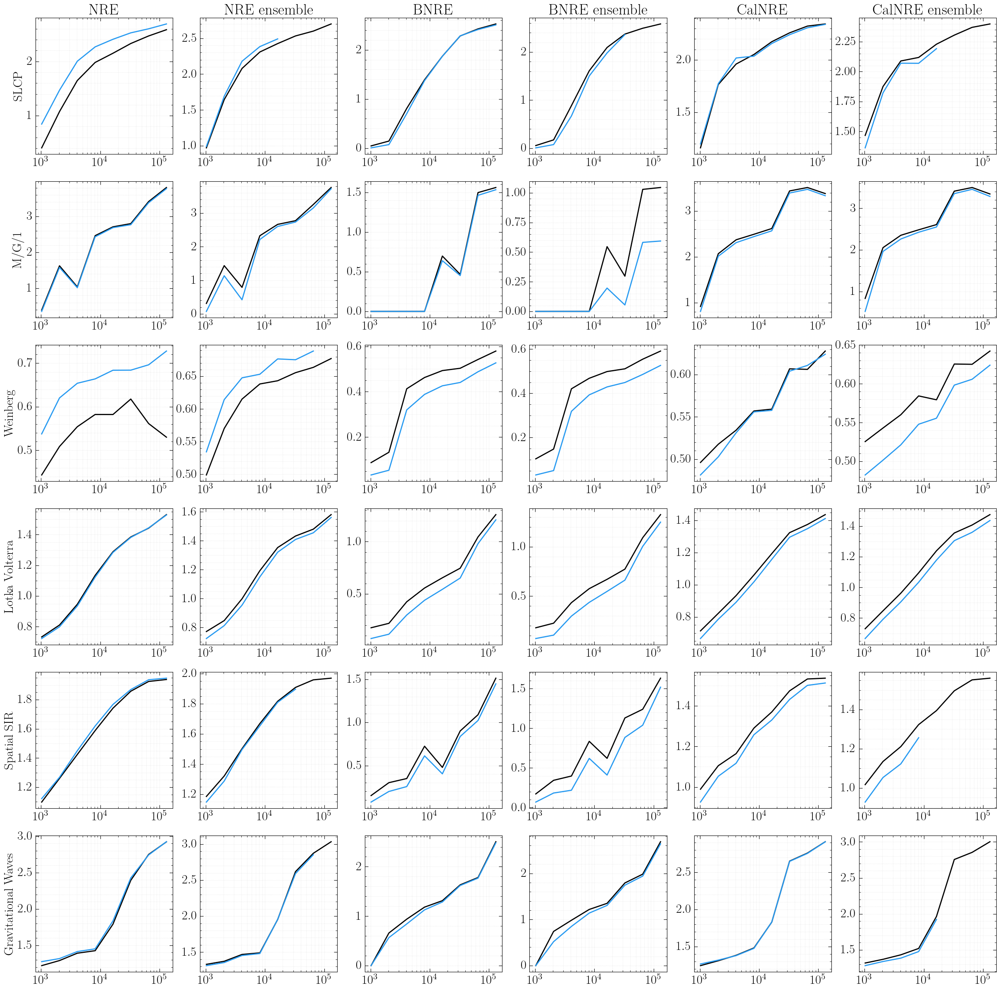

In [60]:
nrows = 6
ncols = 6
res = 5
fig, axes = plt.subplots(nrows, ncols, figsize=(res * nrows, res * ncols))

# Plot results
for index, problem in enumerate(problems):
    axes[index][0].set_ylabel(problem_titles[problem])
    plot_mi_problem(axes[index], problem)

axes[0][0].set_title(r"NRE")
axes[0][1].set_title(r"NRE ensemble")
axes[0][2].set_title(r"BNRE")
axes[0][3].set_title(r"BNRE ensemble")
axes[0][4].set_title(r"CalNRE")
axes[0][5].set_title(r"CalNRE ensemble")

plt.show()

## Contour area distributions

In [61]:
show_levels = [0.95]

### NRE

slcp
---


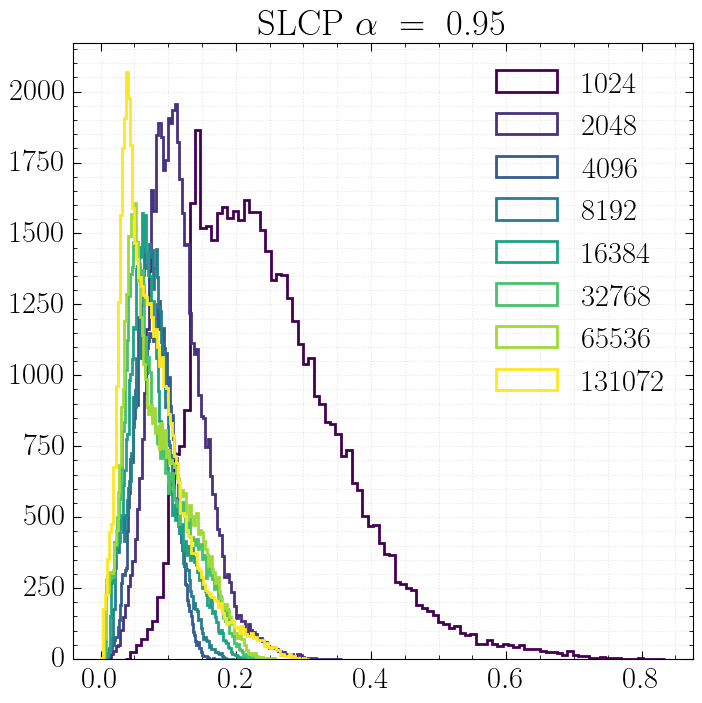



mg1
---


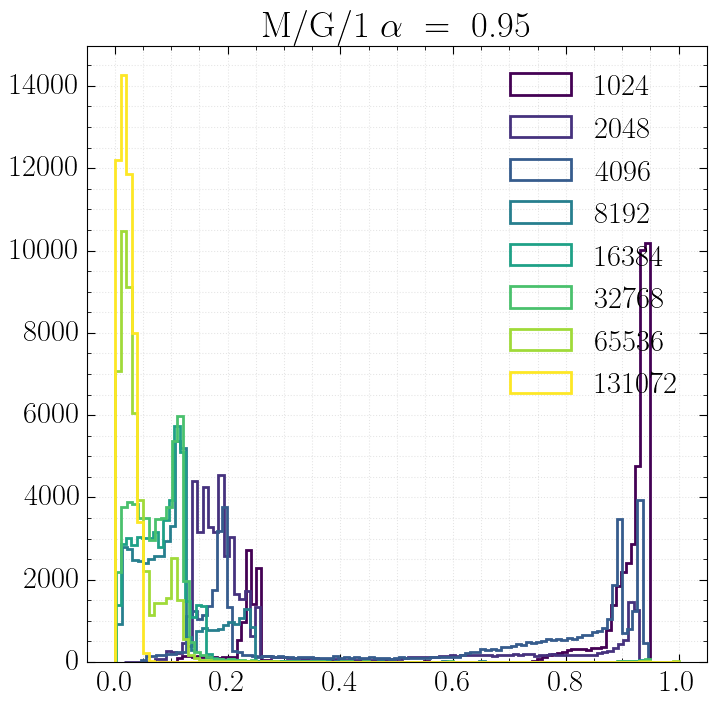



weinberg
---


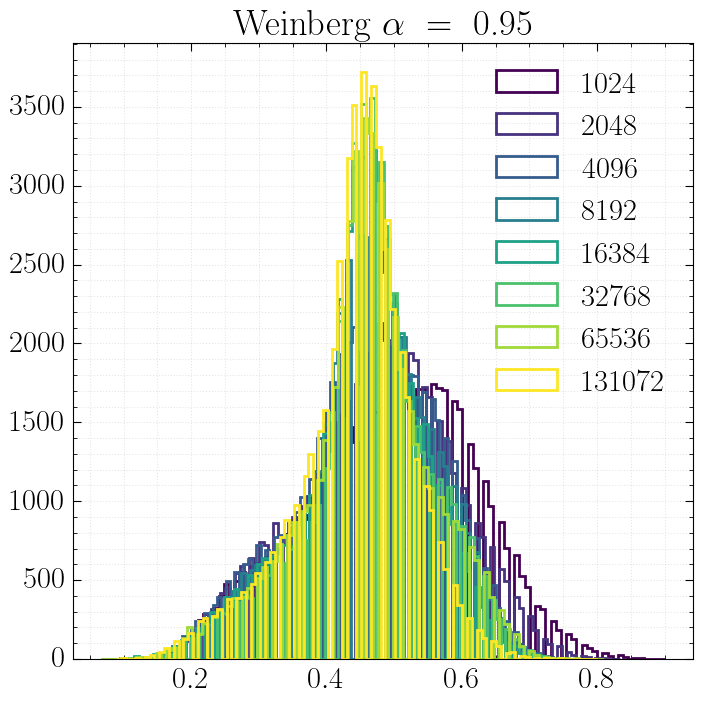



lotka_volterra
---


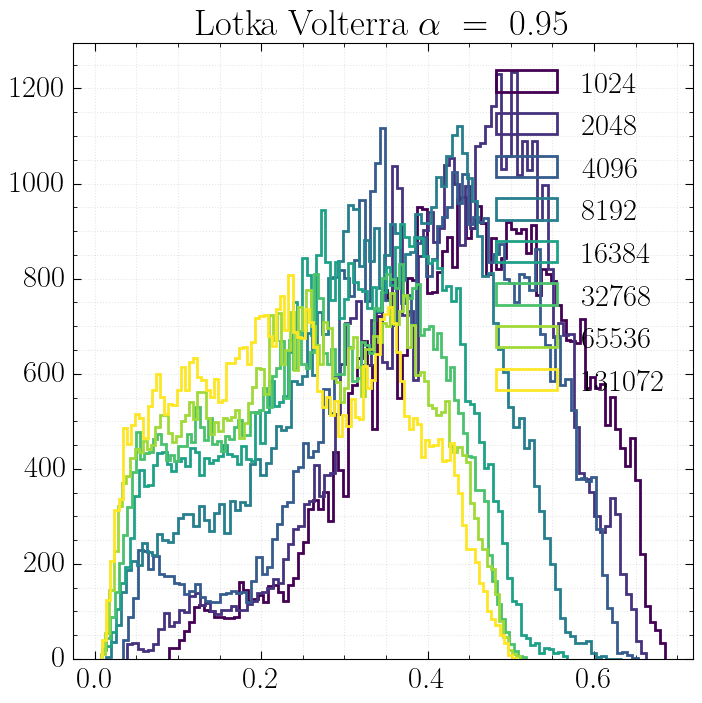



spatialsir
---


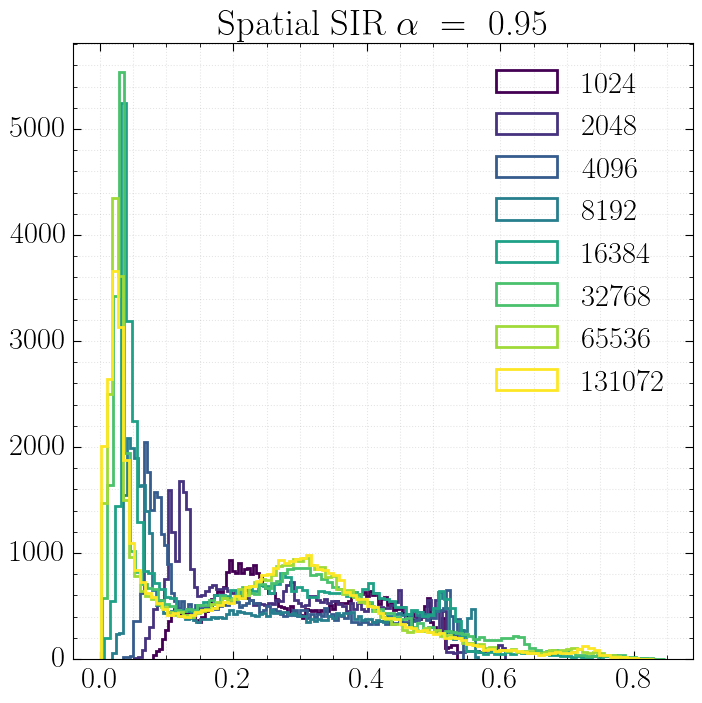



gw
---


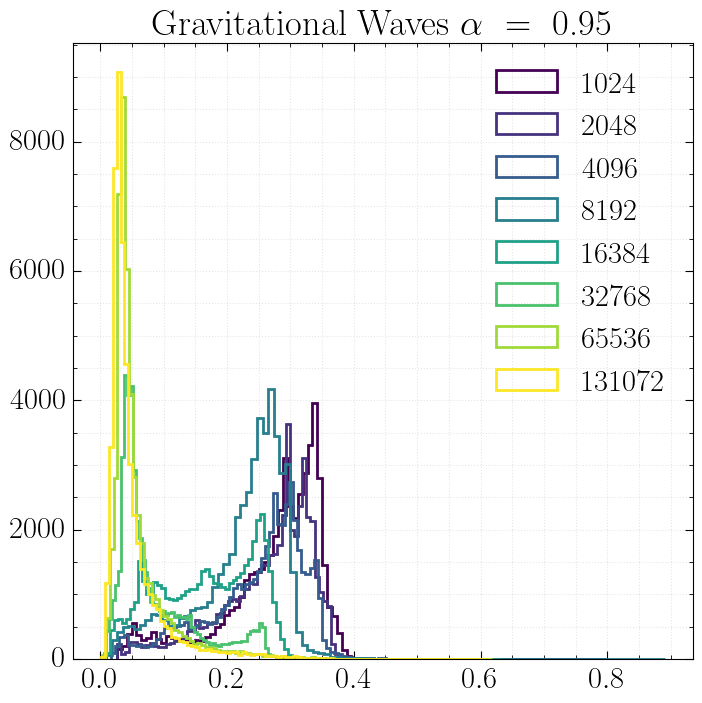

In [62]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["nre"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../nre/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/*/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=100,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### NRE ensemble

slcp
---


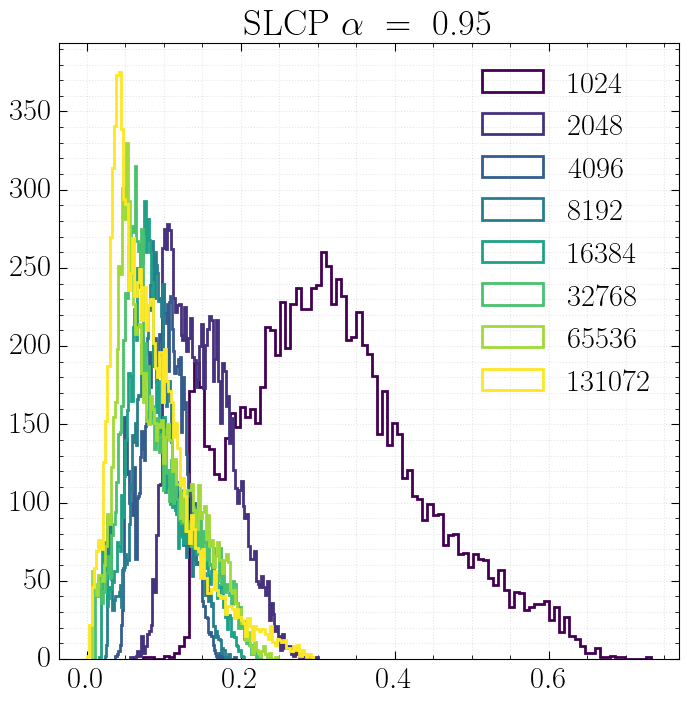



mg1
---


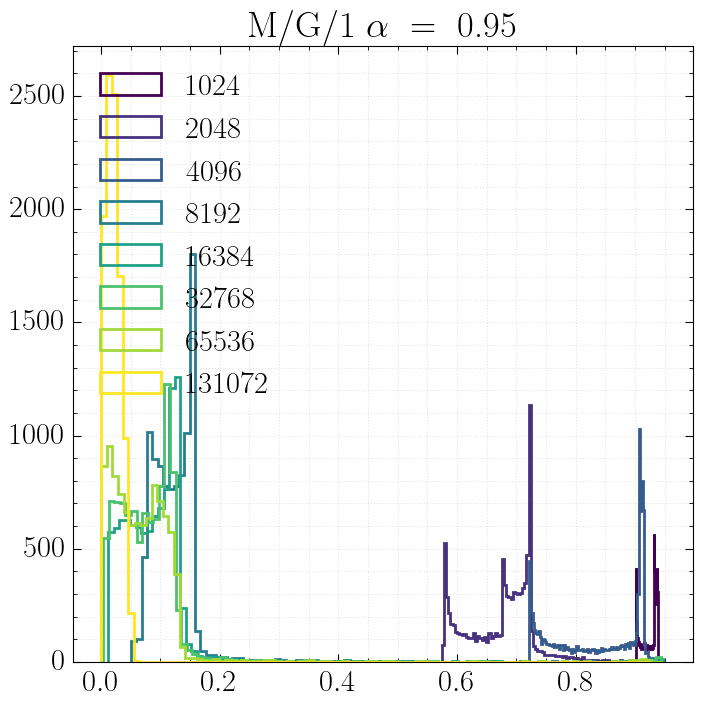



weinberg
---


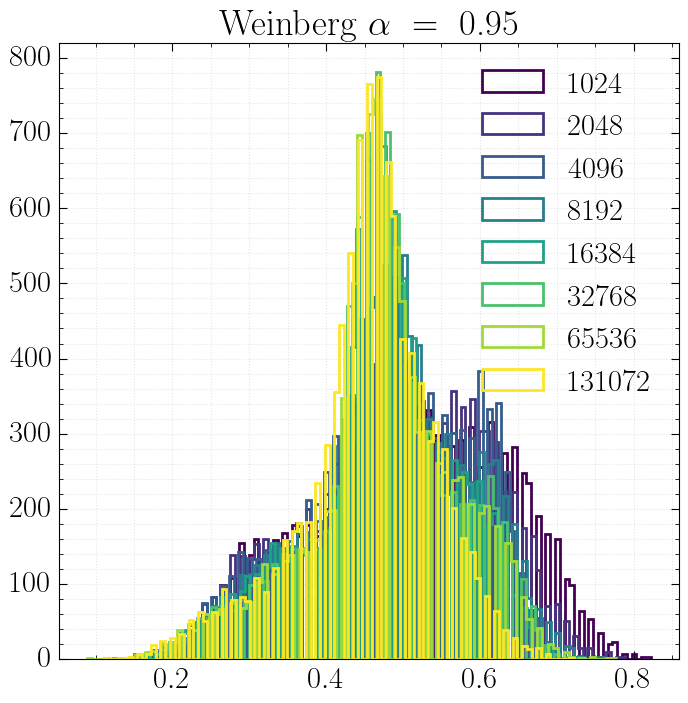



lotka_volterra
---


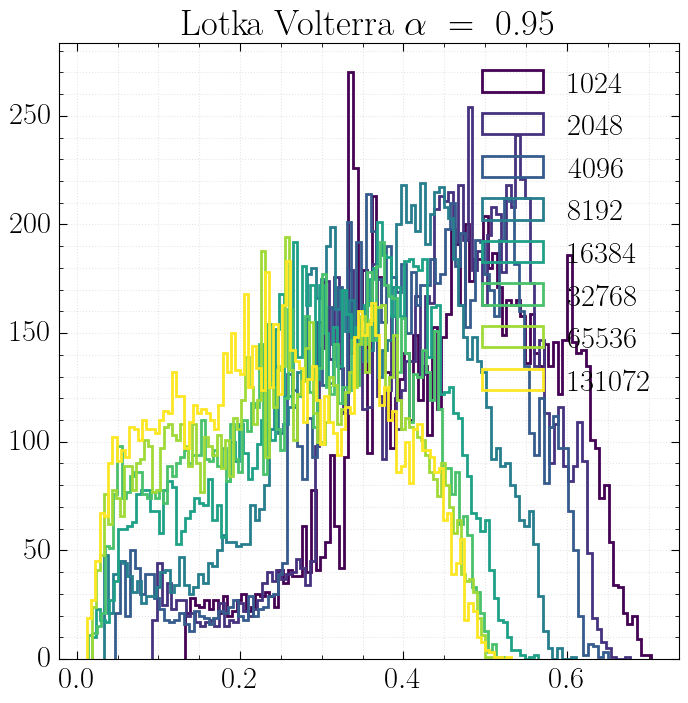



spatialsir
---
spatialsir 65536 failed


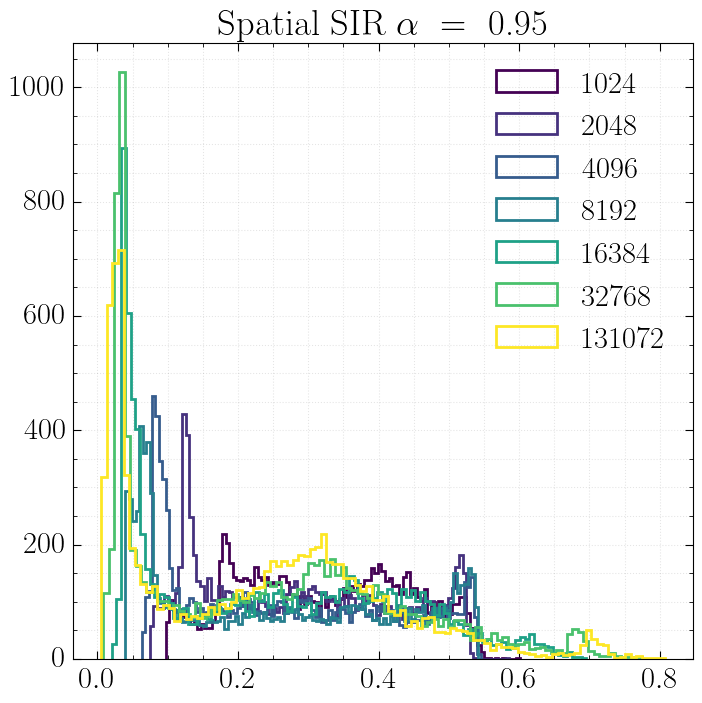



gw
---


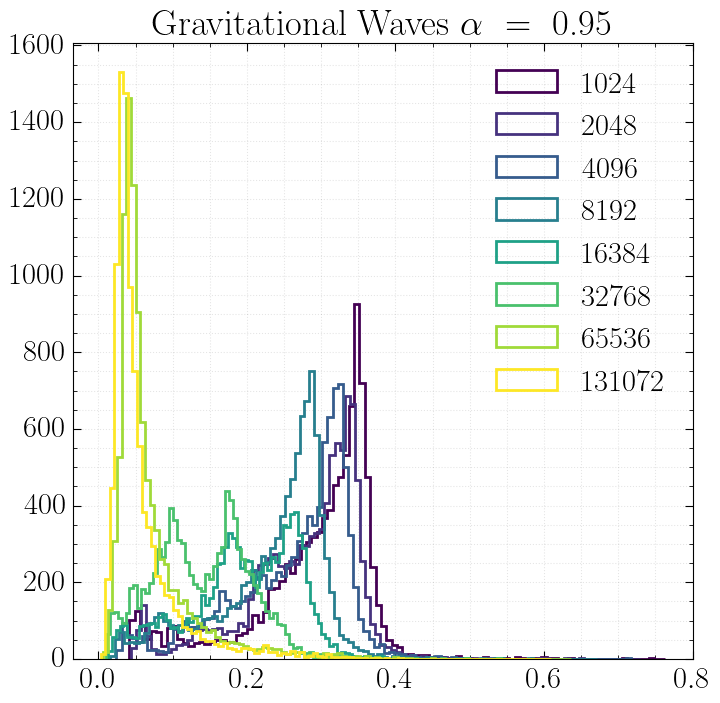

In [63]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["nre_ensemble"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../nre/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            try:
                samples = np.hstack(
                    [
                        np.flip(np.load(f))[level_index].reshape(-1)
                        for f in files
                    ]
                )
                plt.hist(
                    samples,
                    bins=100,
                    density=False,
                    cumulative=False,
                    histtype="step",
                    lw=2,
                    label=budget,
                    color=colors[budget_index],
                )
            except:
                print(f"{problem} {budget} failed")
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### BNRE

slcp
---


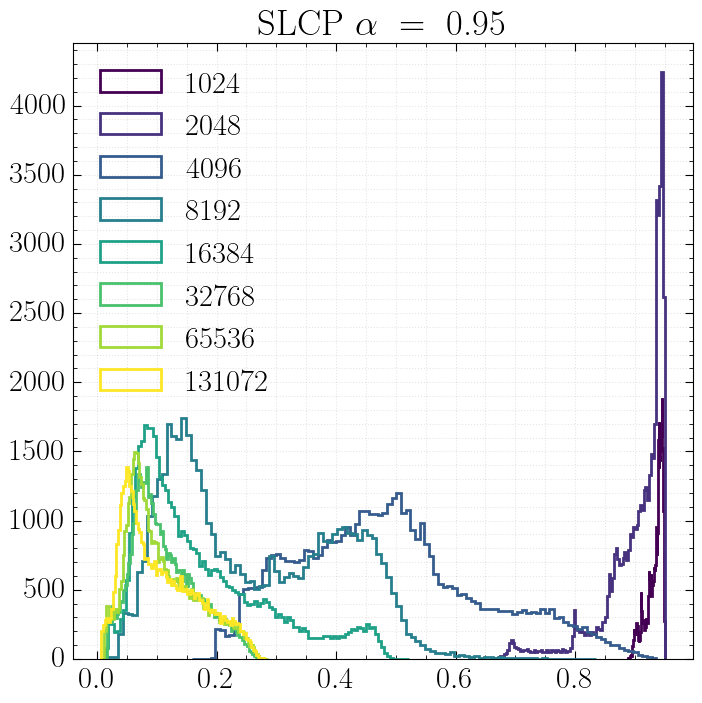



mg1
---


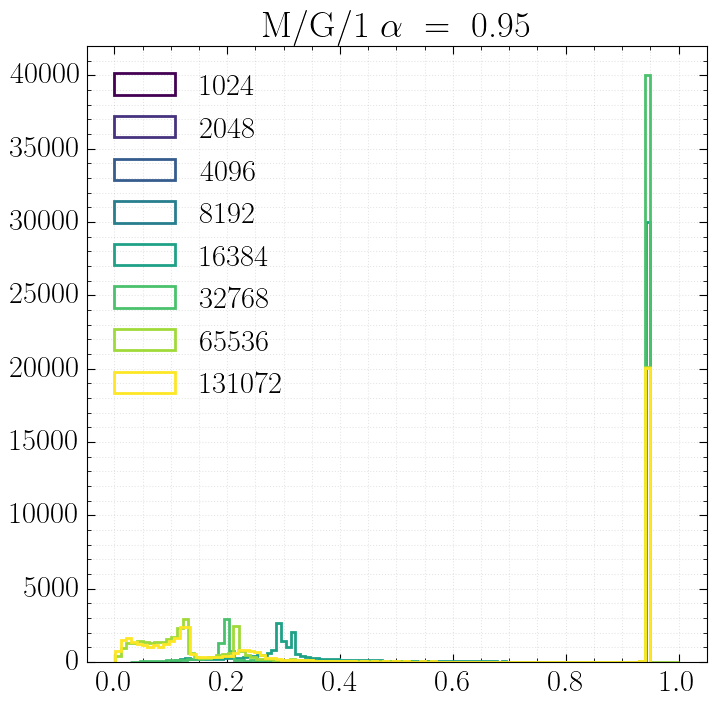



weinberg
---


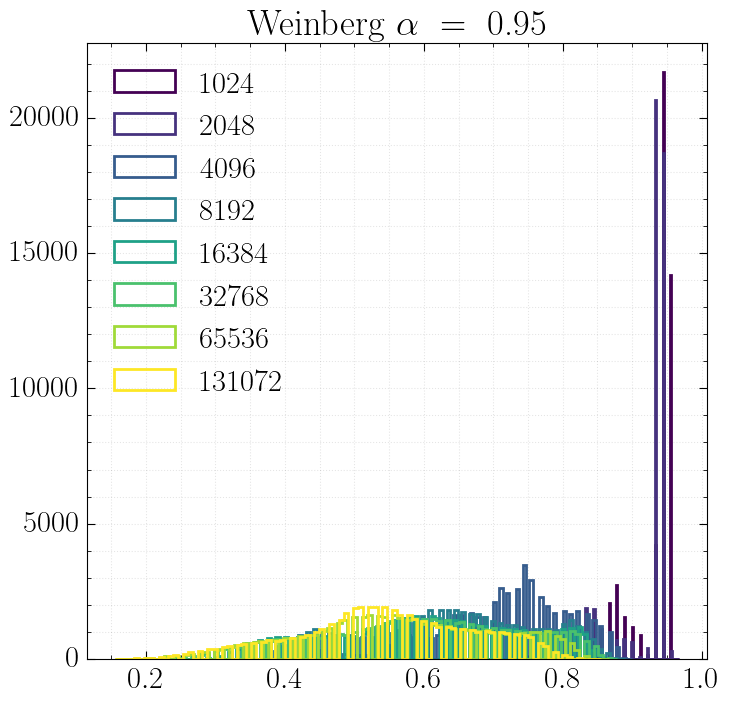



lotka_volterra
---


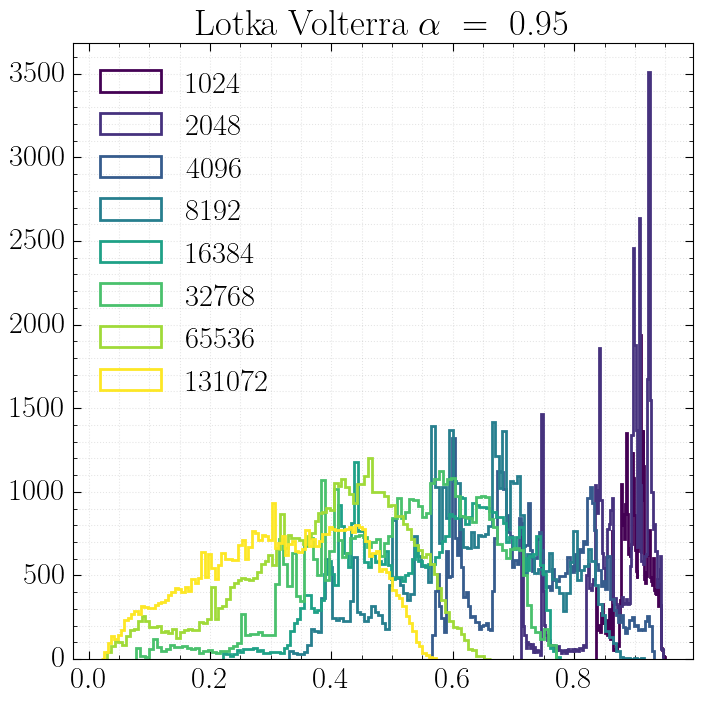



spatialsir
---


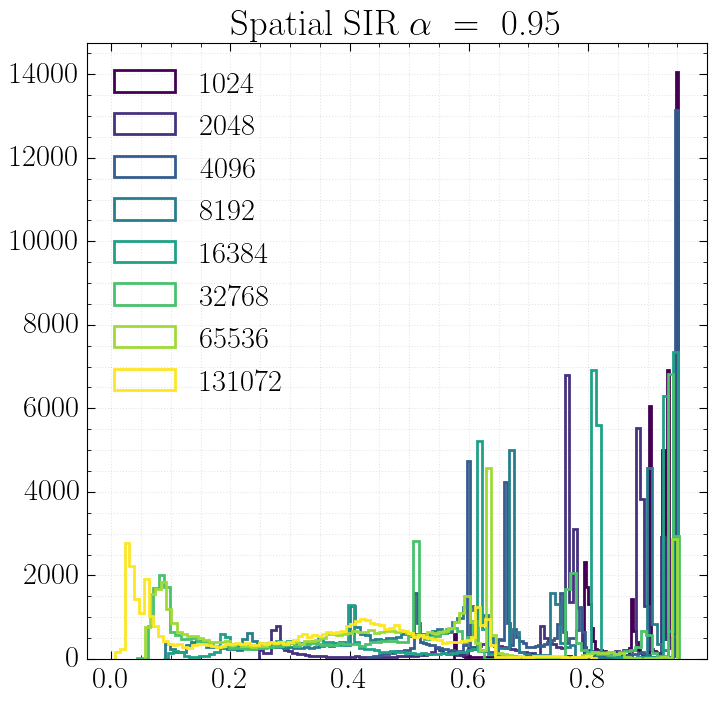



gw
---


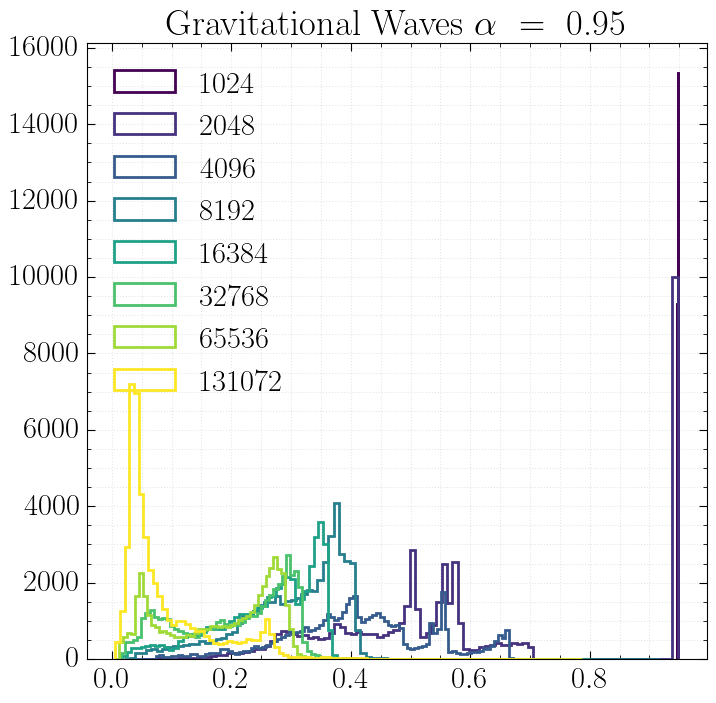

In [64]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["cnre"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../bnre/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/*/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=100,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### BNRE ensemble

slcp
---


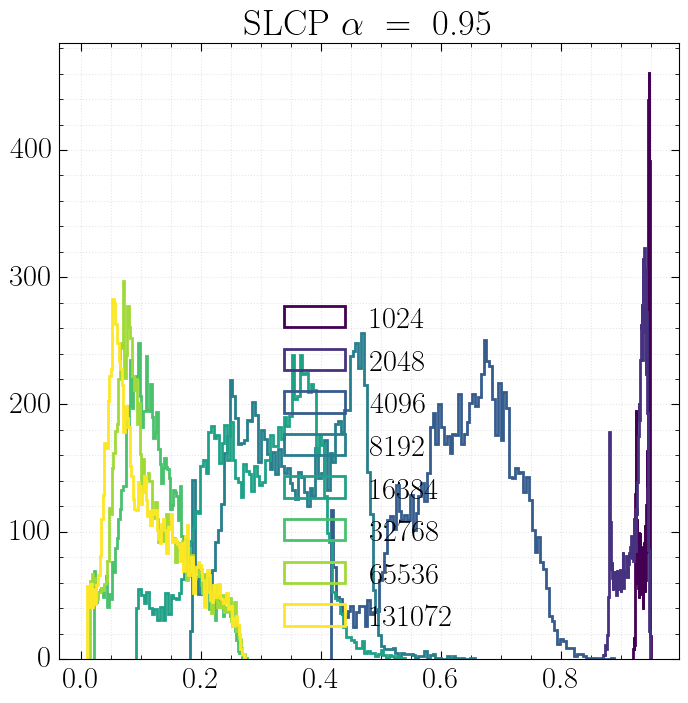



mg1
---


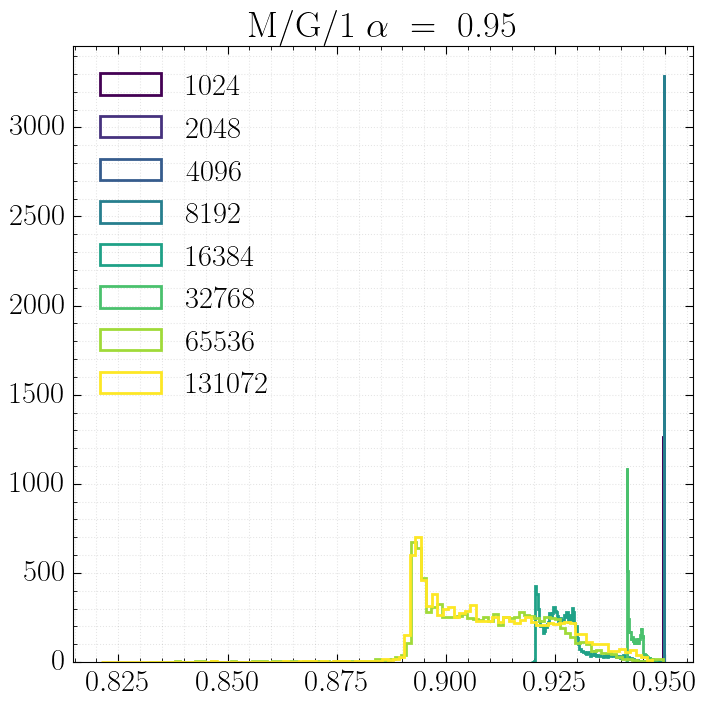



weinberg
---


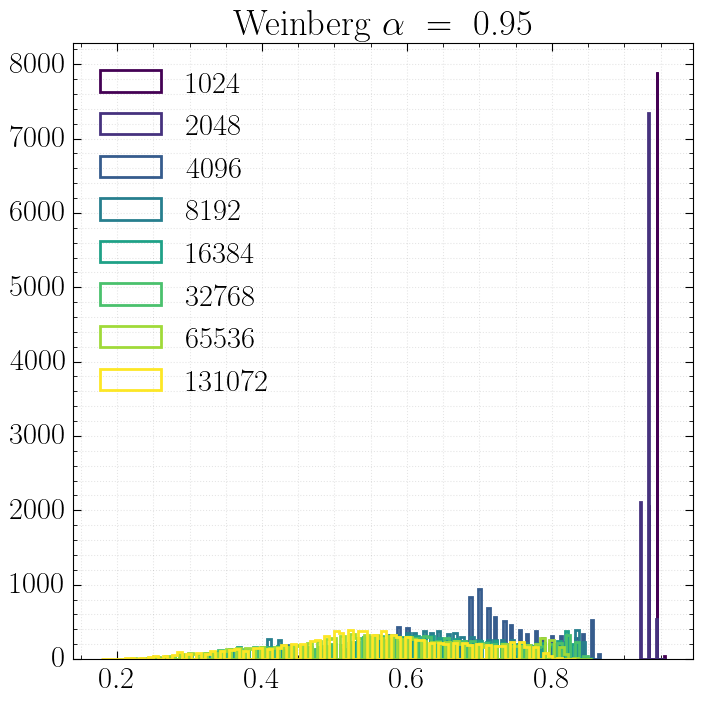



lotka_volterra
---


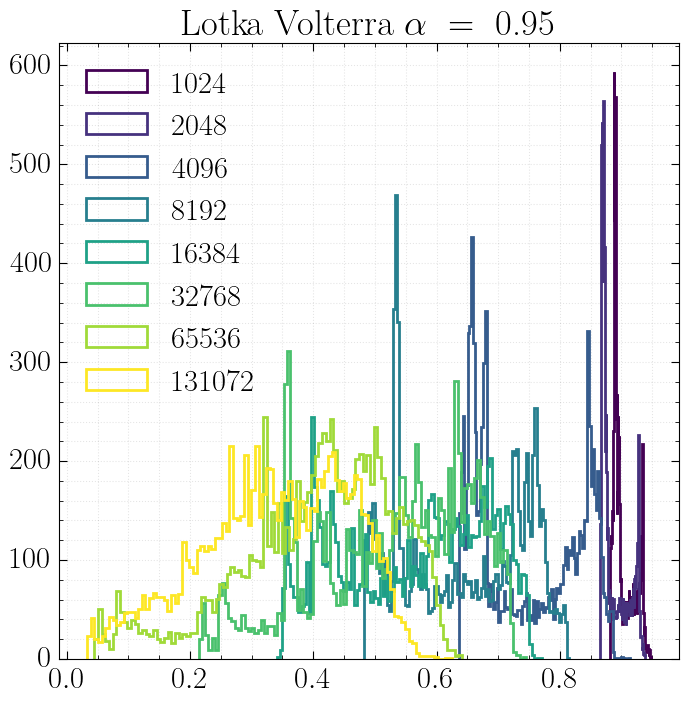



spatialsir
---


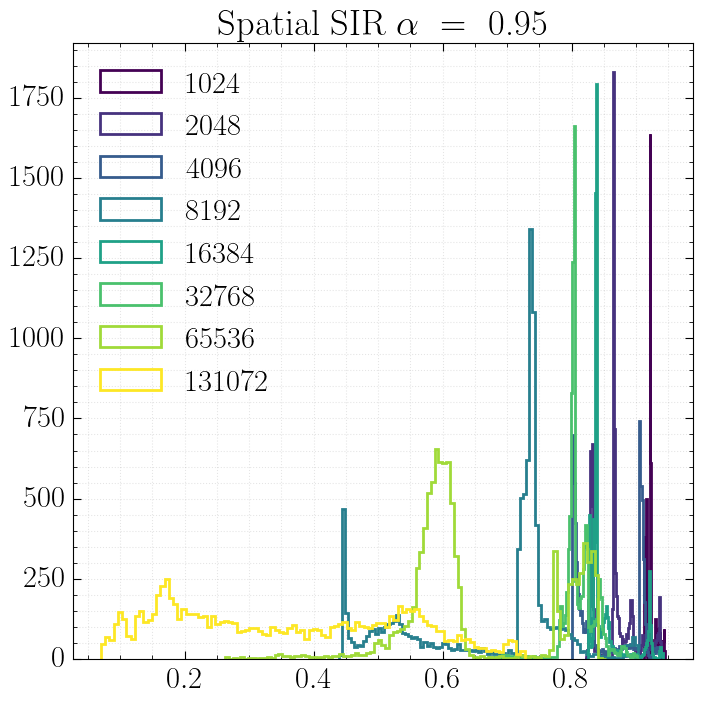



gw
---


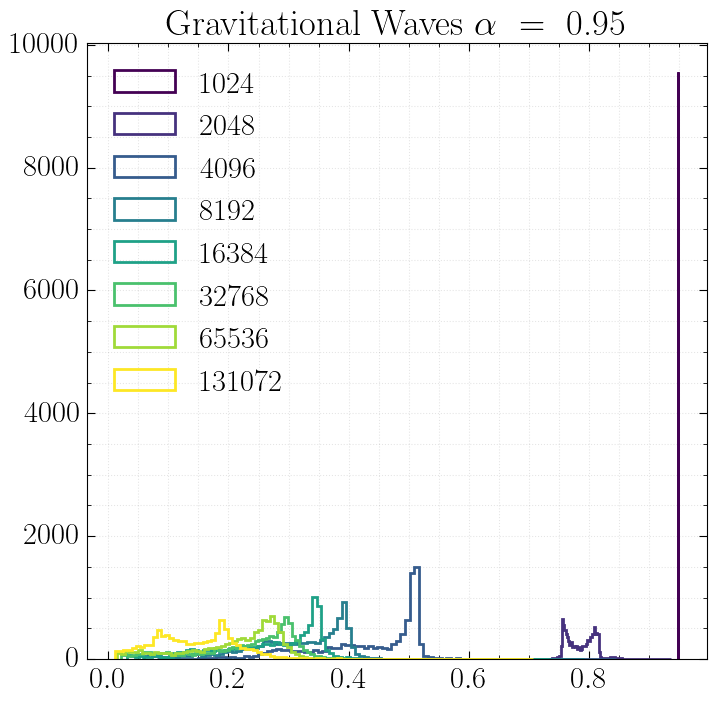

In [65]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["cnre_ensemble"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../bnre/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            try:
                samples = np.hstack(
                    [
                        np.flip(np.load(f))[level_index].reshape(-1)
                        for f in files
                    ]
                )
                plt.hist(
                    samples,
                    bins=100,
                    density=False,
                    cumulative=False,
                    histtype="step",
                    lw=2,
                    label=budget,
                    color=colors[budget_index],
                )
            except:
                print(f"{problem} {budget} failed")
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### CalNRE

slcp
---


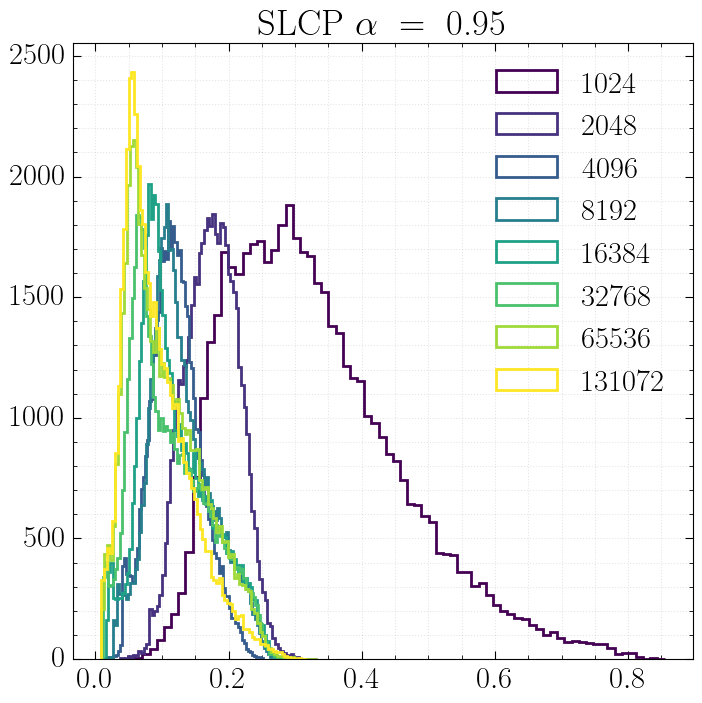



mg1
---


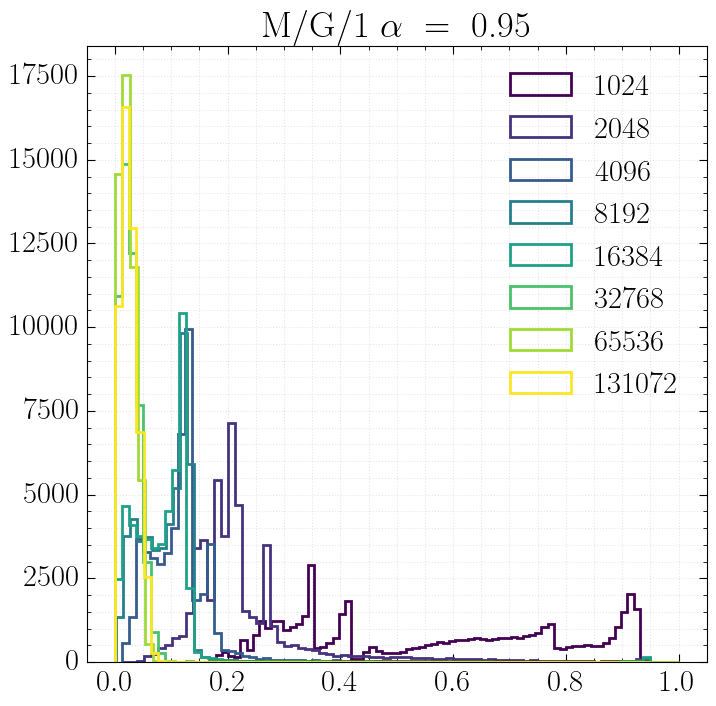



weinberg
---


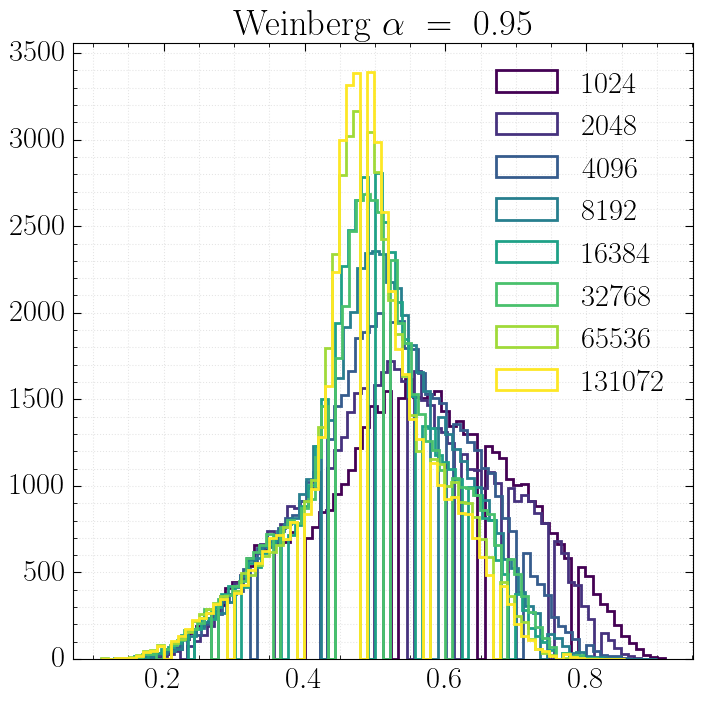



lotka_volterra
---


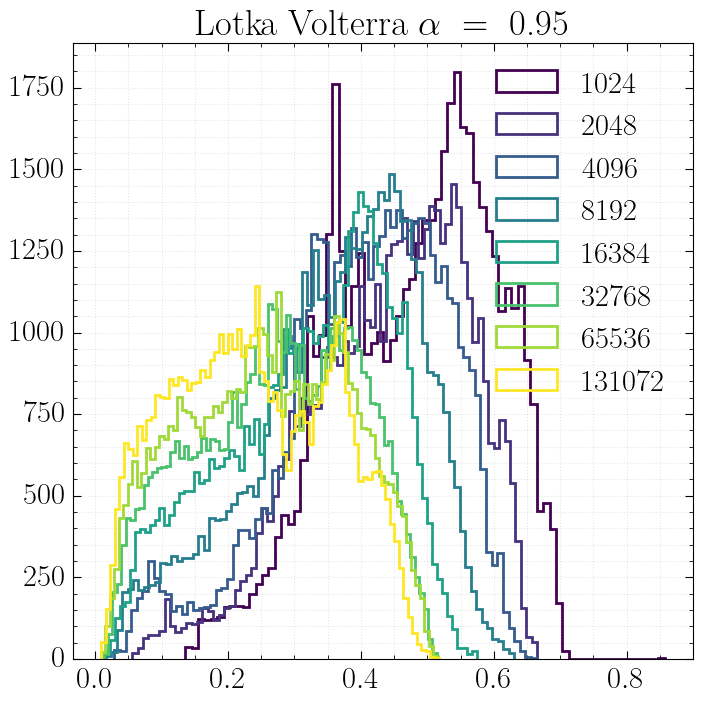



spatialsir
---


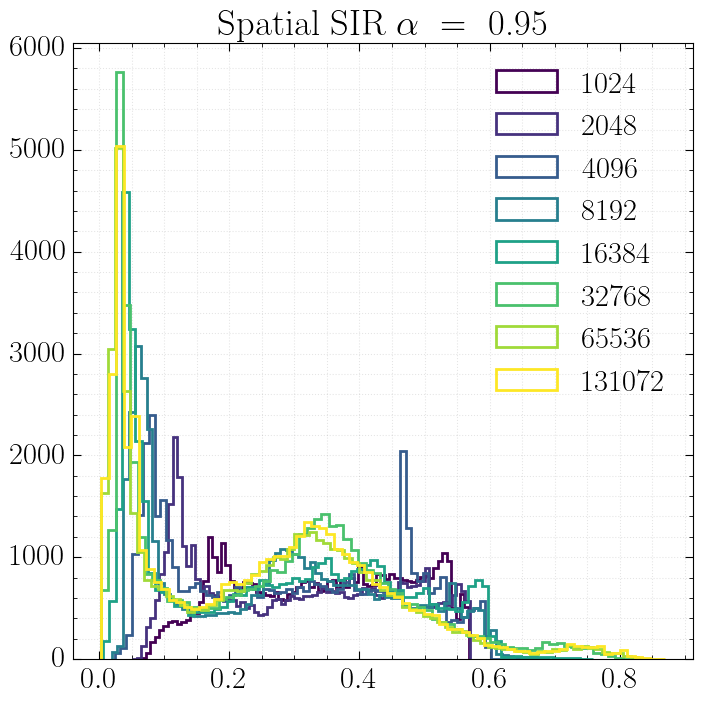



gw
---


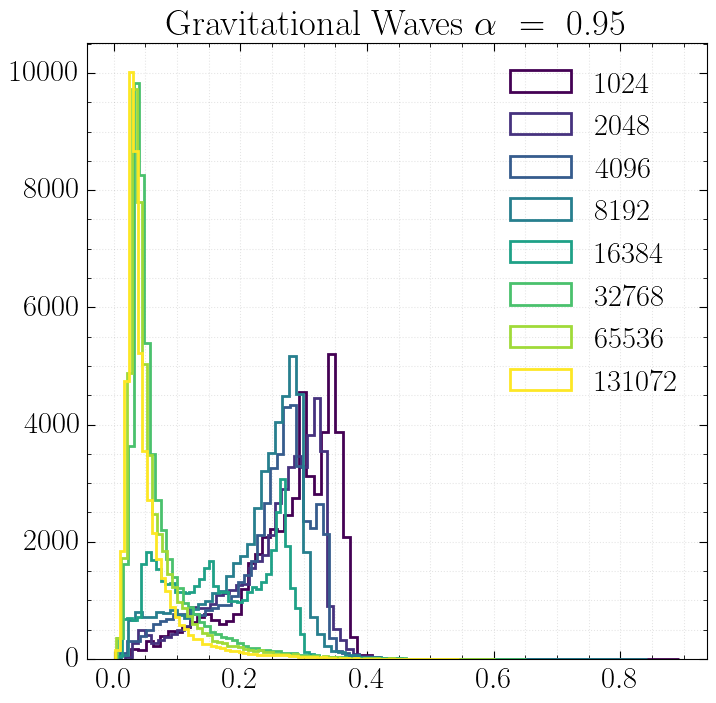

In [66]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["calnre"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/*/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=75,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### CalNRE ensemble

slcp
---


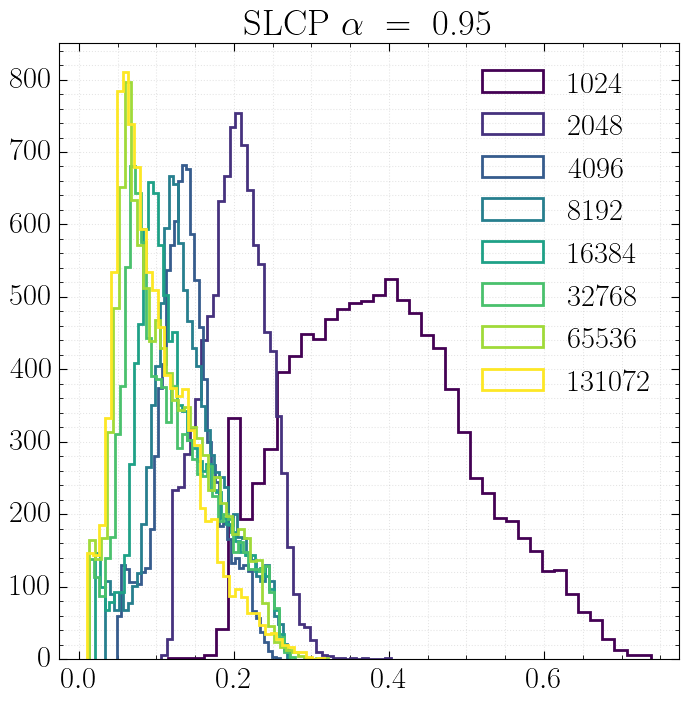



mg1
---


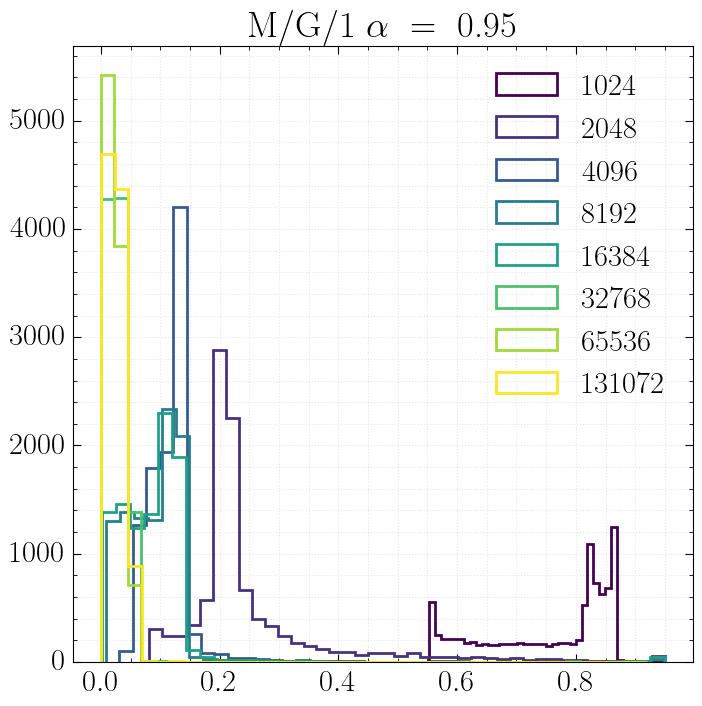



weinberg
---


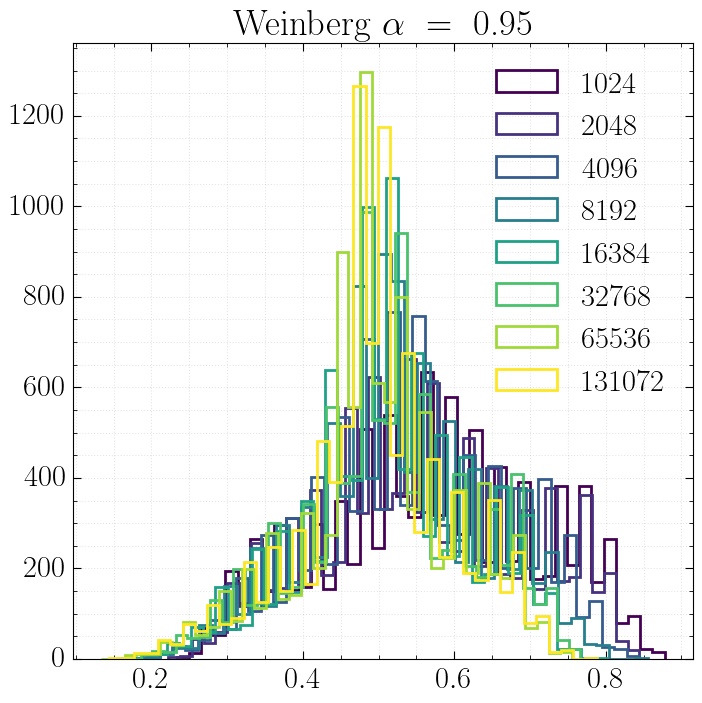



lotka_volterra
---


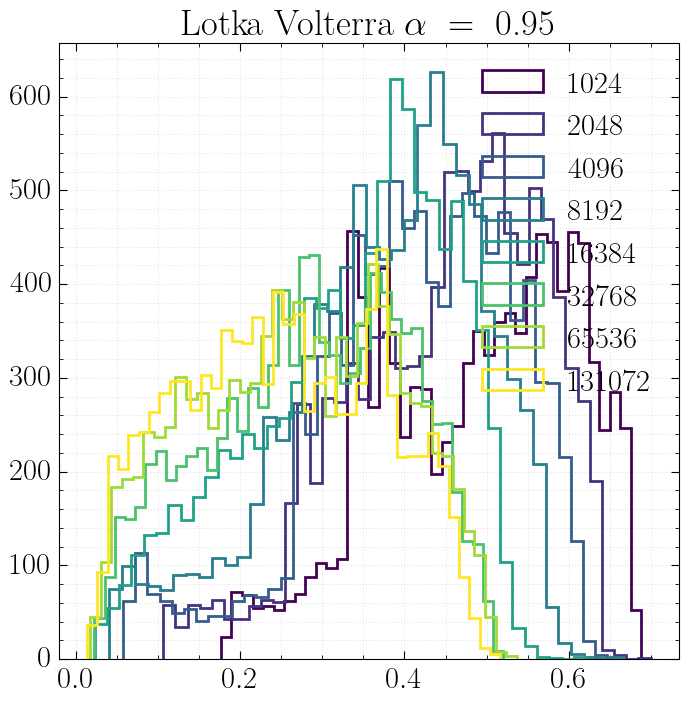



spatialsir
---


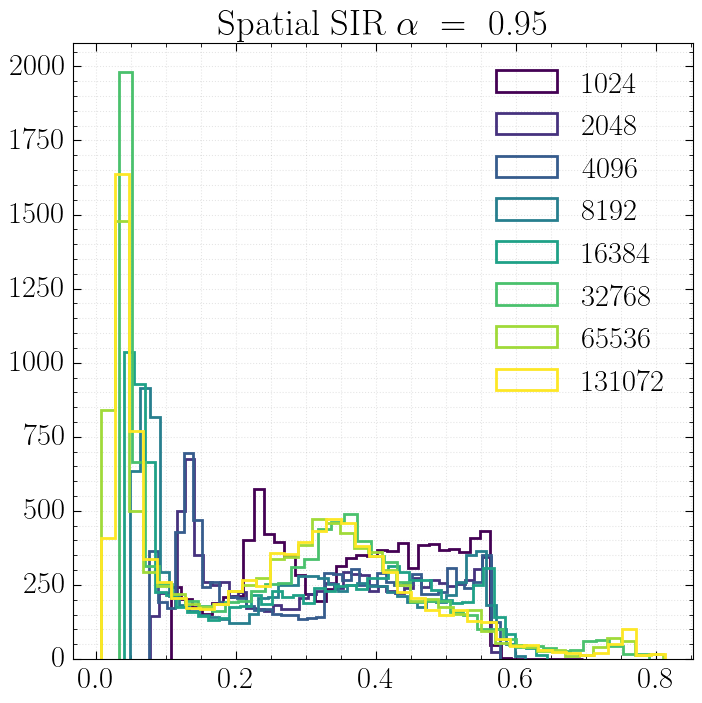



gw
---


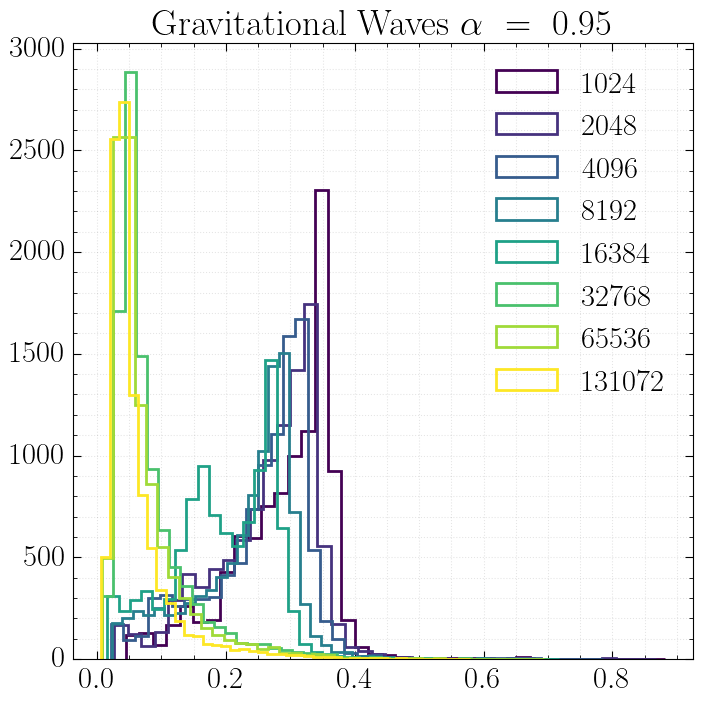

In [67]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["calnre_ensemble"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=40,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### CalNPE

slcp
---


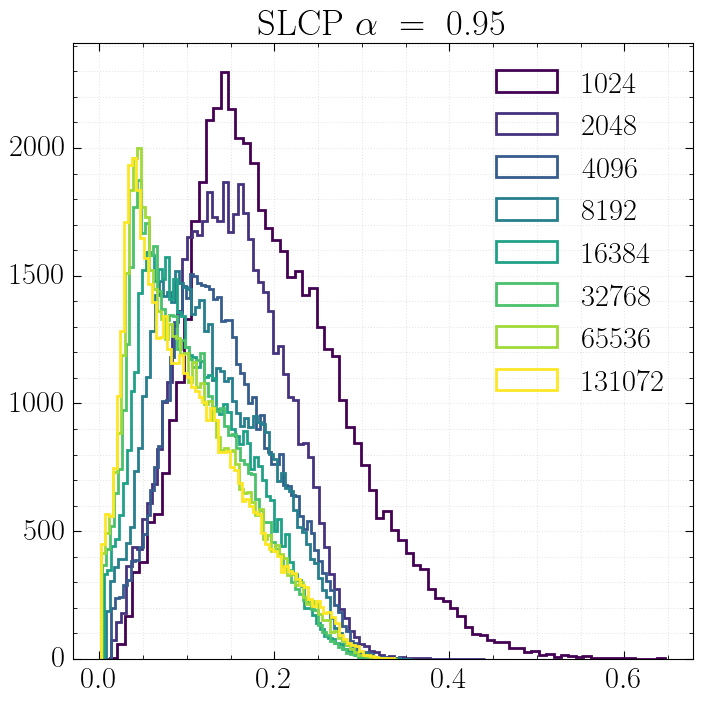



mg1
---


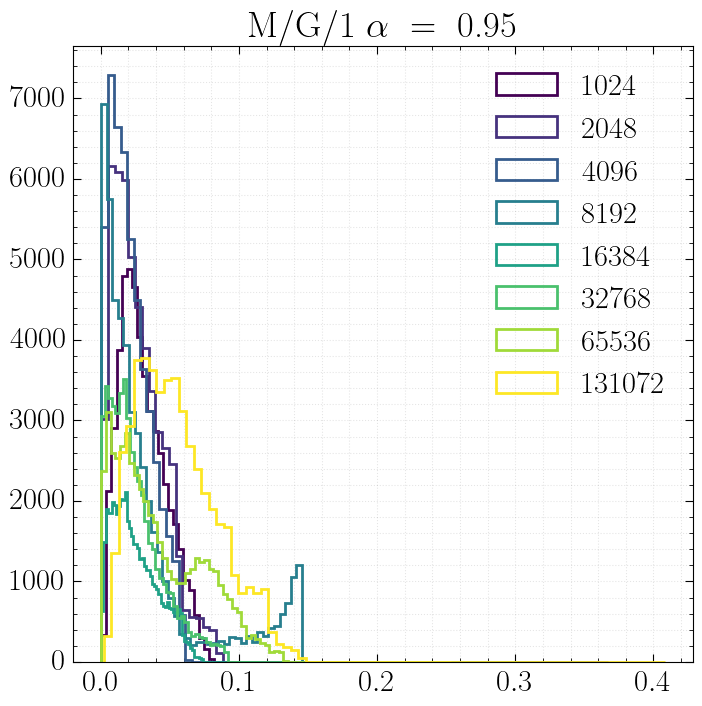



weinberg
---


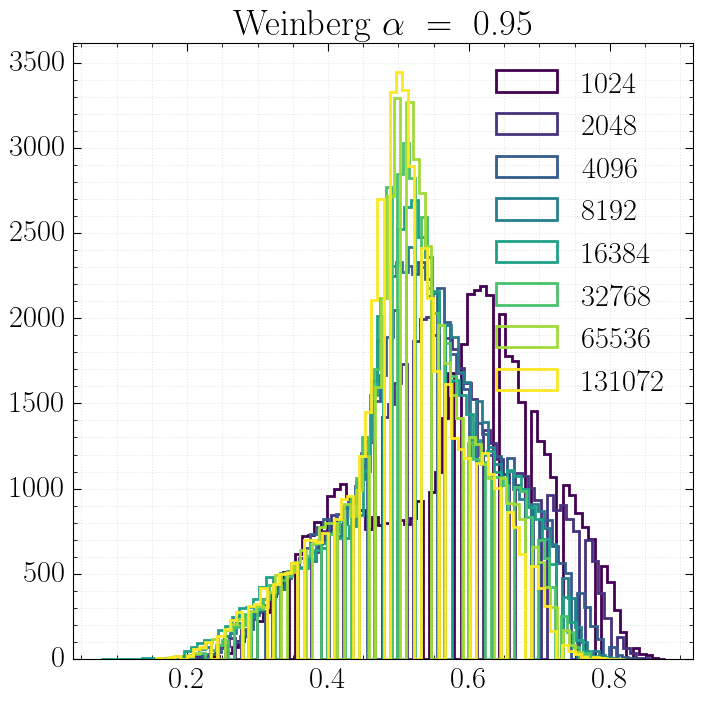



lotka_volterra
---


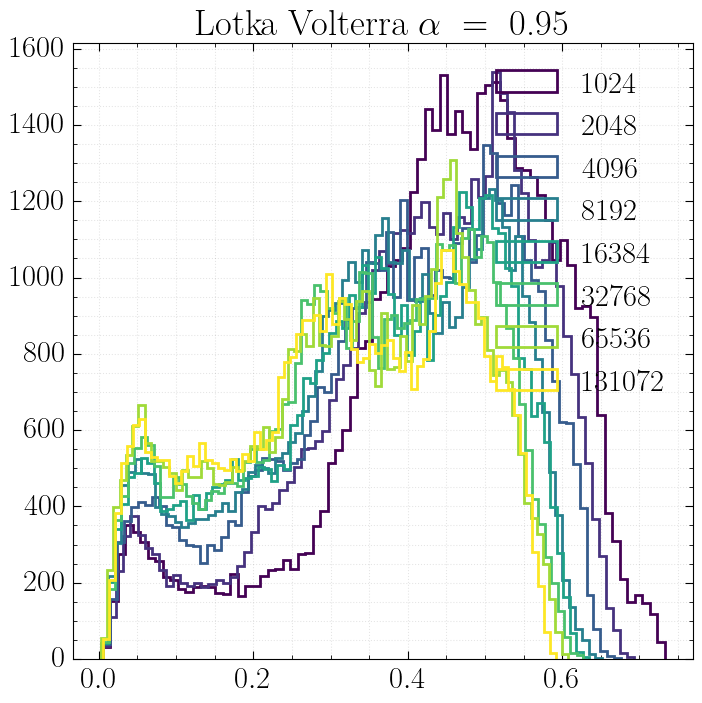



spatialsir
---


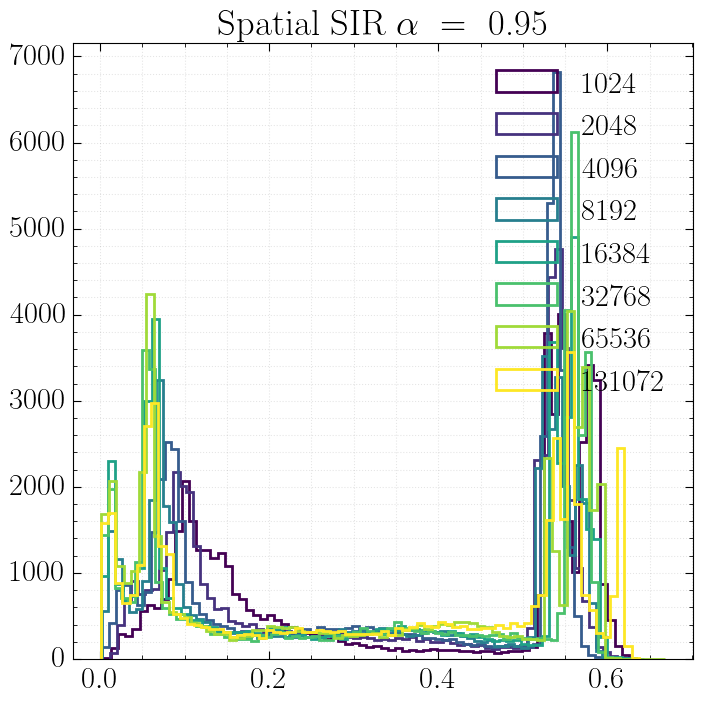



gw
---


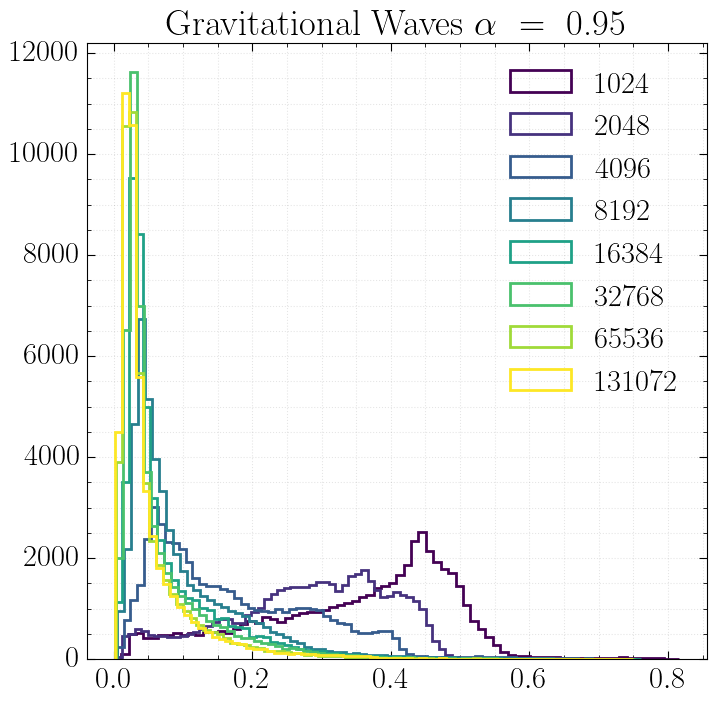

In [68]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["calnpe"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../calnpe/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/*/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=75,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

### CalNPE ensemble

slcp
---


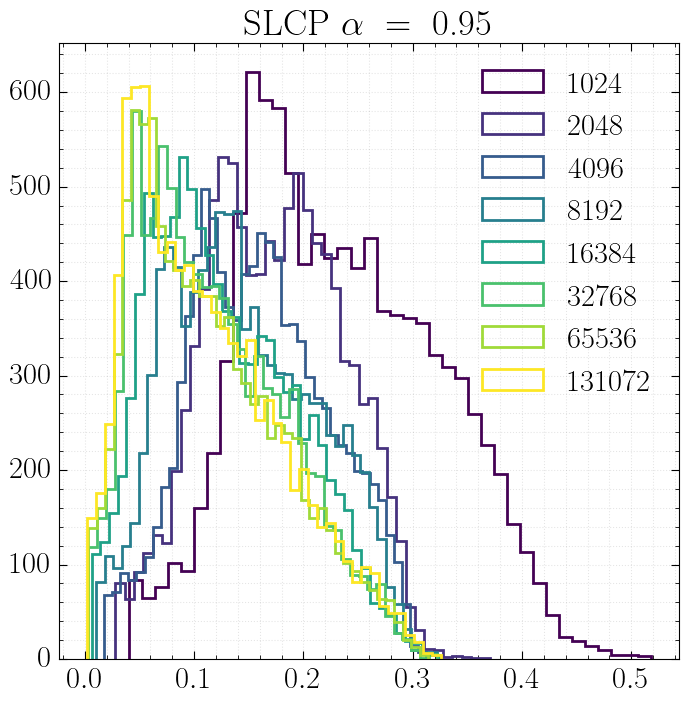



mg1
---


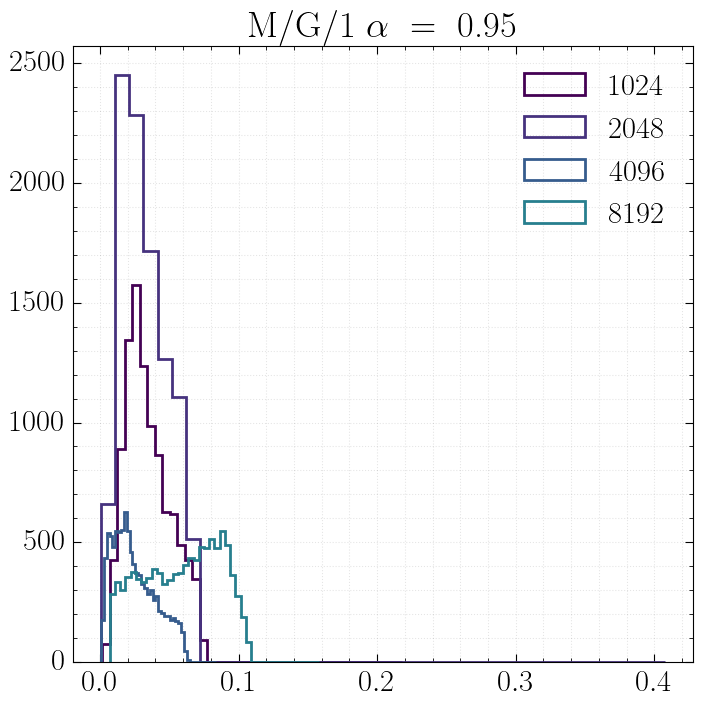



weinberg
---


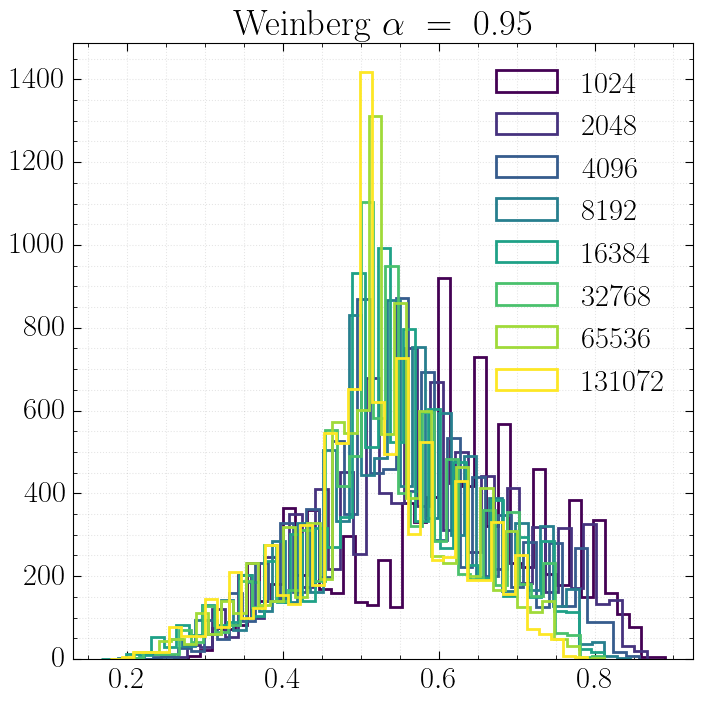



lotka_volterra
---


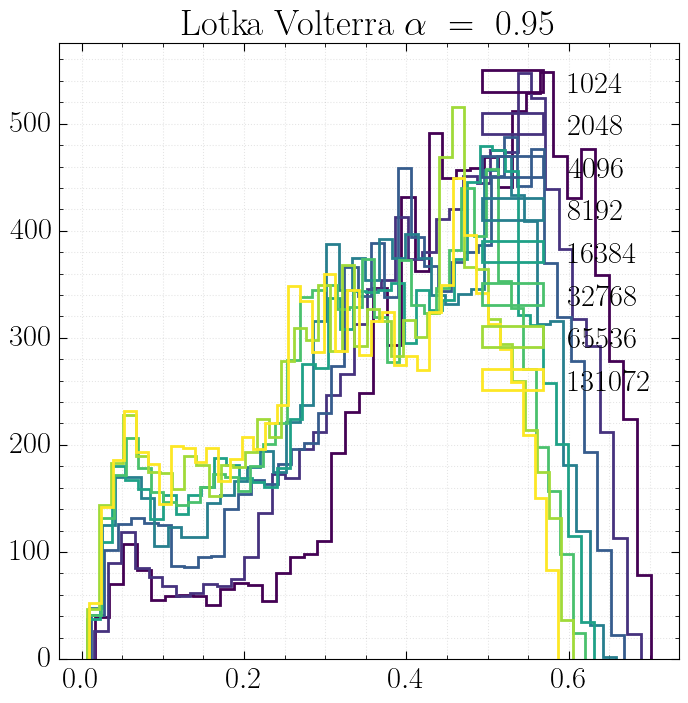



spatialsir
---


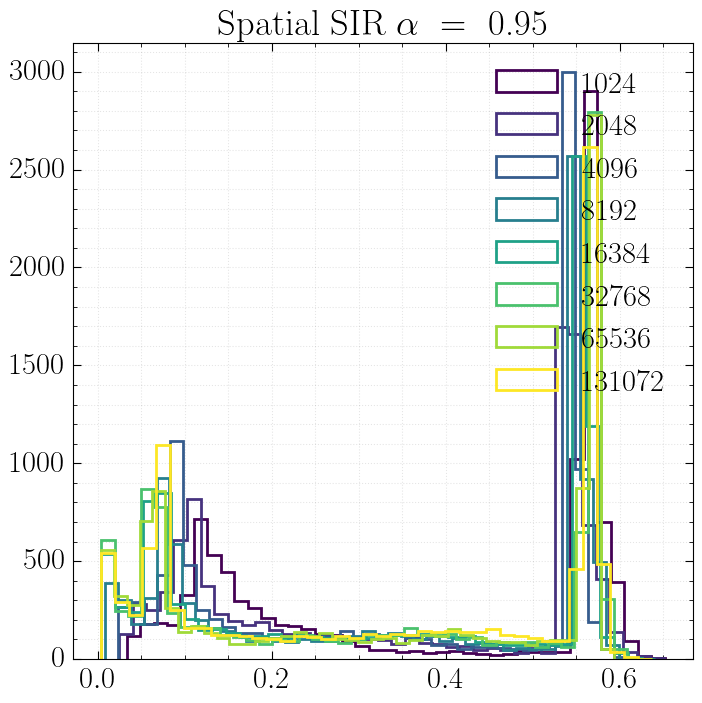



gw
---


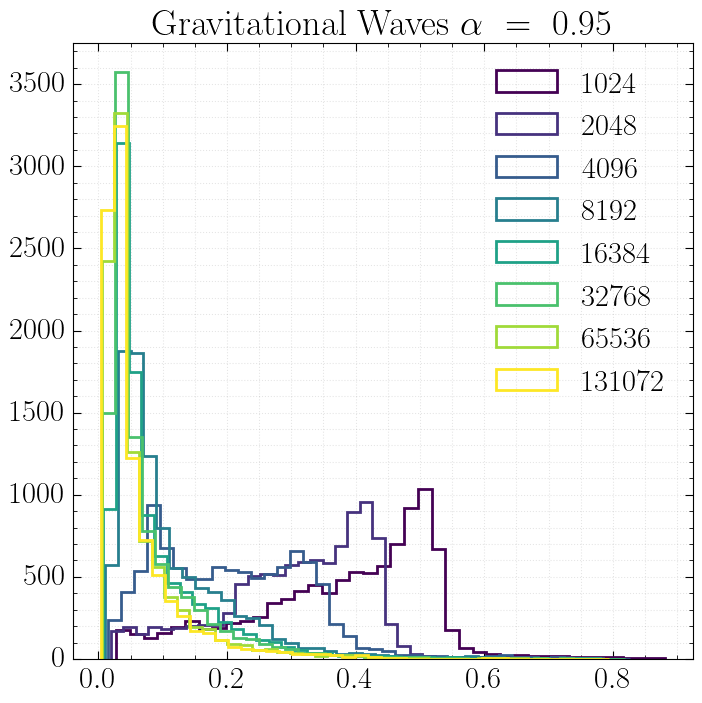

In [69]:
for problem in problems:
    print(problem)
    print("---")
    learning_rate = problem_lrs["calnpe_ensemble"][problem]
    for level_index, level in enumerate(levels):
        if level not in show_levels:
            continue
        for budget_index, budget in enumerate(simulation_budgets):
            query = (
                "../calnpe/"
                + problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            plt.hist(
                samples,
                bins=40,
                density=False,
                cumulative=False,
                histtype="step",
                lw=2,
                label=budget,
                color=colors[budget_index],
            )
        plt.title(
            problem_titles[problem]
            + r"$~\alpha~=~$"
            + "{:.2f}".format(levels[level_index])
        )
        plt.legend()
        plt.show()
    print("\n")

## Evolution of contour size

### Utilities

In [70]:
def load_contour_size_data(problem, method):
    learning_rate = problem_lrs[method][problem]
    if method == "nre":
        problem = "../nre/" + problem
    elif method == "bnre":
        problem = "../bnre/" + problem
    elif method == "calnpe":
        problem = "../calnpe/" + problem
    else:
        pass
    data = [[] for _ in range(len(levels))]
    data_ensemble = [[] for _ in range(len(levels))]
    for budget in simulation_budgets:
        for level_index, level in enumerate(levels):
            # Ensemble
            query = (
                problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            m = np.median(samples)
            data_ensemble[level_index].append(m)
            # Individual
            query = (
                problem
                + "/output/estimator/"
                + str(budget)
                + "/"
                + batch_size
                + "/"
                + learning_rate
                + "/*/contour-sizes.npy"
            )
            files = glob.glob(query)
            if len(files) == 0:
                continue
            samples = np.hstack(
                [np.flip(np.load(f))[level_index].reshape(-1) for f in files]
            )
            m = np.median(samples)
            data[level_index].append(m)

    return data, data_ensemble

In [71]:
def plot_contour_size(problem, ax=None, method="nre"):
    if ax is None:
        ax = plt.gca()
    data, data_ensemble = load_contour_size_data(problem, method=method)
    for level_index, _ in enumerate(levels):
        if len(data[level_index]) == len(simulation_budgets):
            ax.plot(
                simulation_budgets,
                data[level_index],
                c=colors_levels[level_index],
            )
        if len(data[level_index]) == len(simulation_budgets):
            ax.plot(
                simulation_budgets,
                data_ensemble[level_index],
                ":",
                c=colors_levels[level_index],
            )
    ax.set_xscale("log")
    ax.set_xlabel("Simulation budget")
    ax.set_ylabel("Relative contour size")
    ax.set_title(problem_titles[problem])
    ax.set_ylim([0 - 0.05, 1 + 0.05])
    make_square(ax)

### Plots

#### NRE

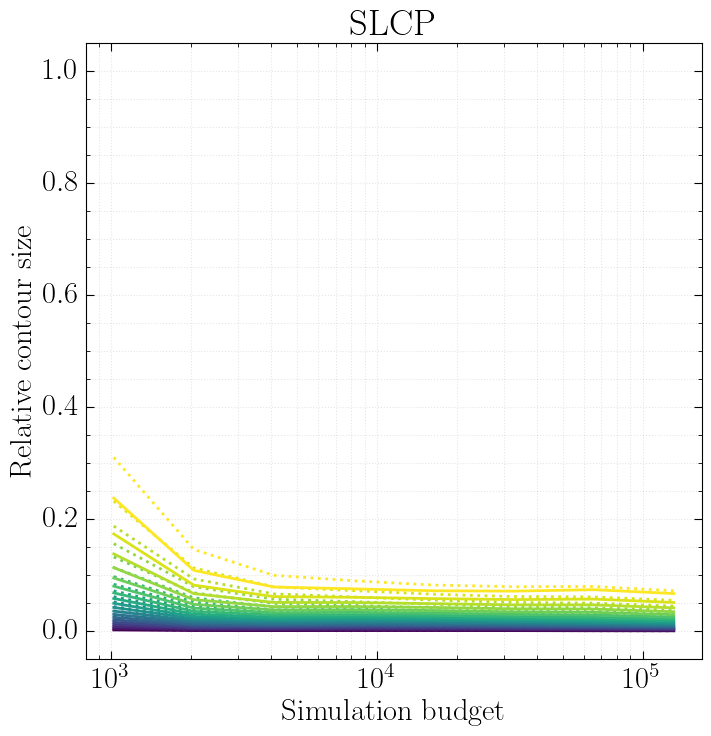

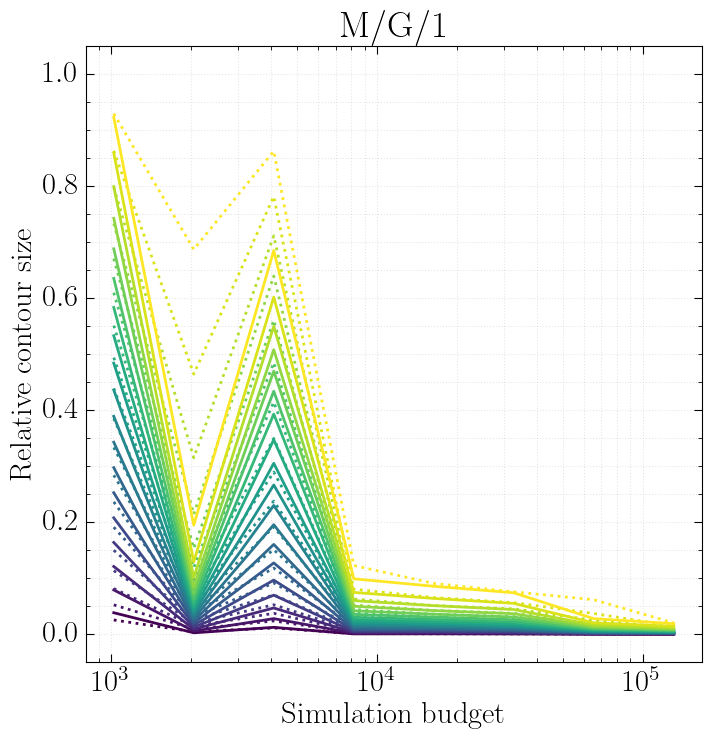

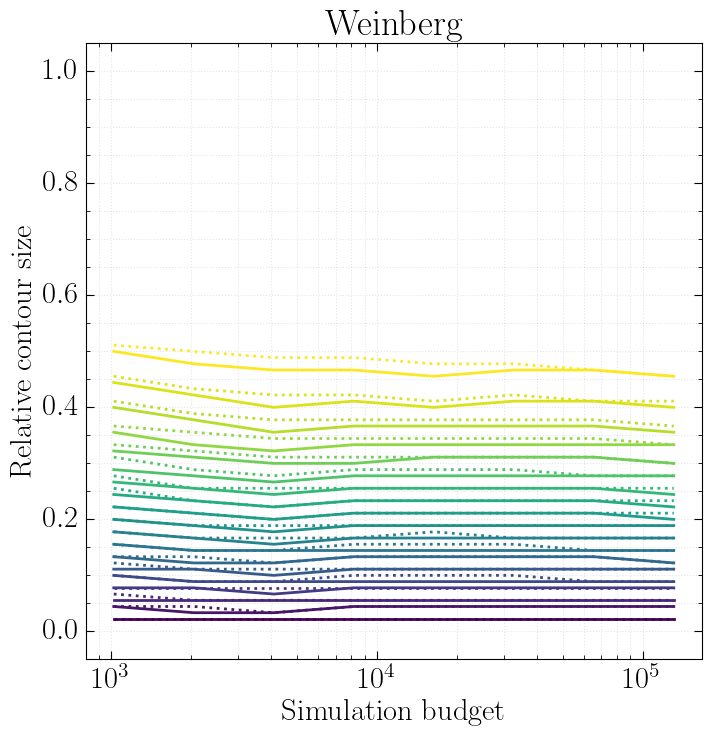

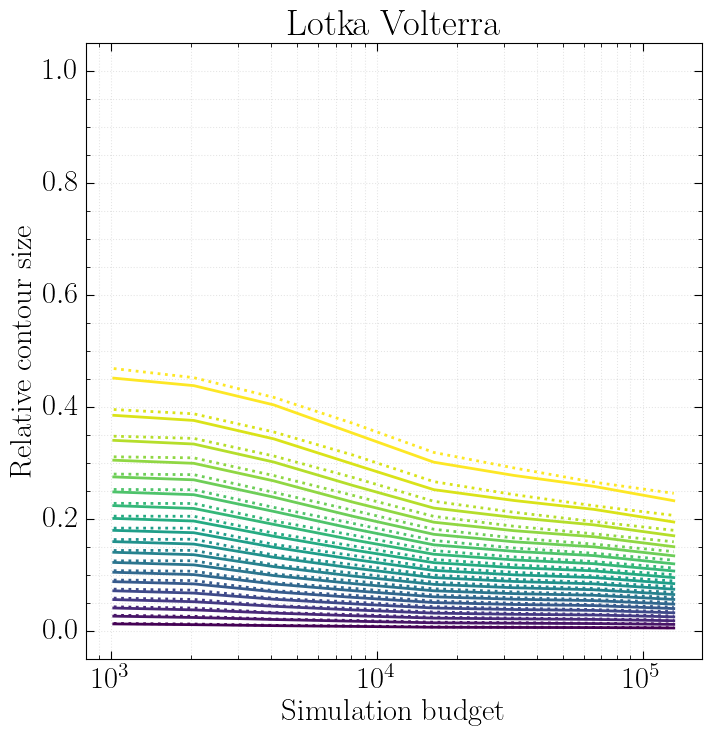

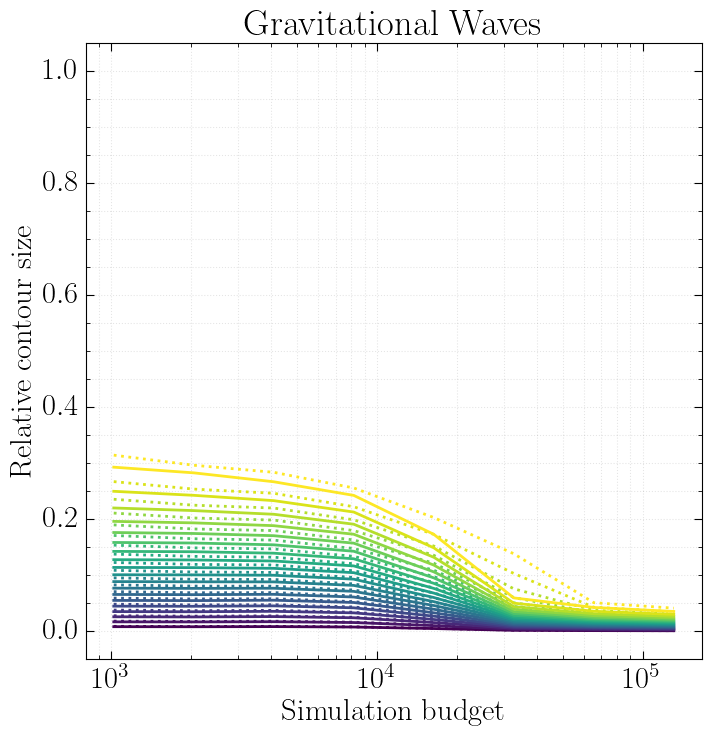

In [72]:
for problem in problems:
    try:
        plot_contour_size(problem, method="nre")
        plt.show()
    except:
        pass

#### BNRE

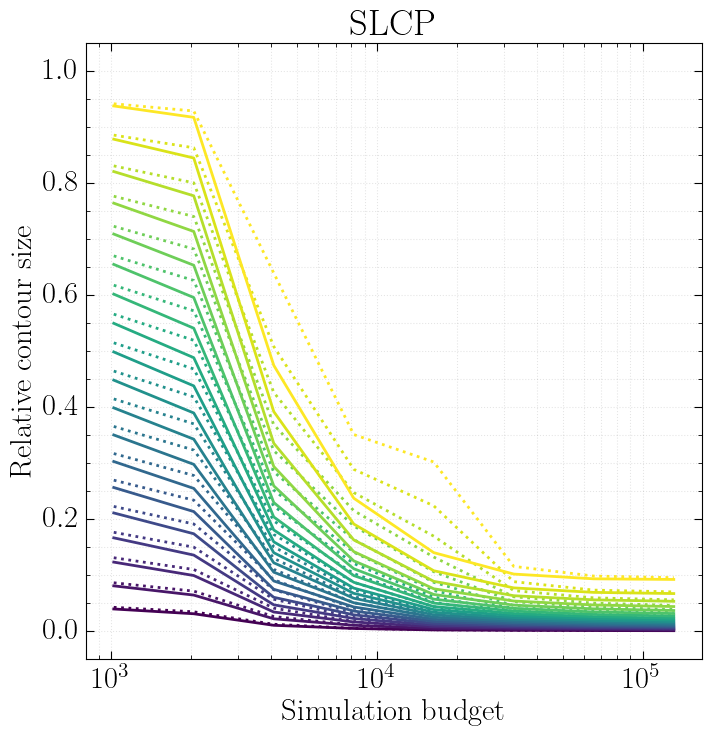

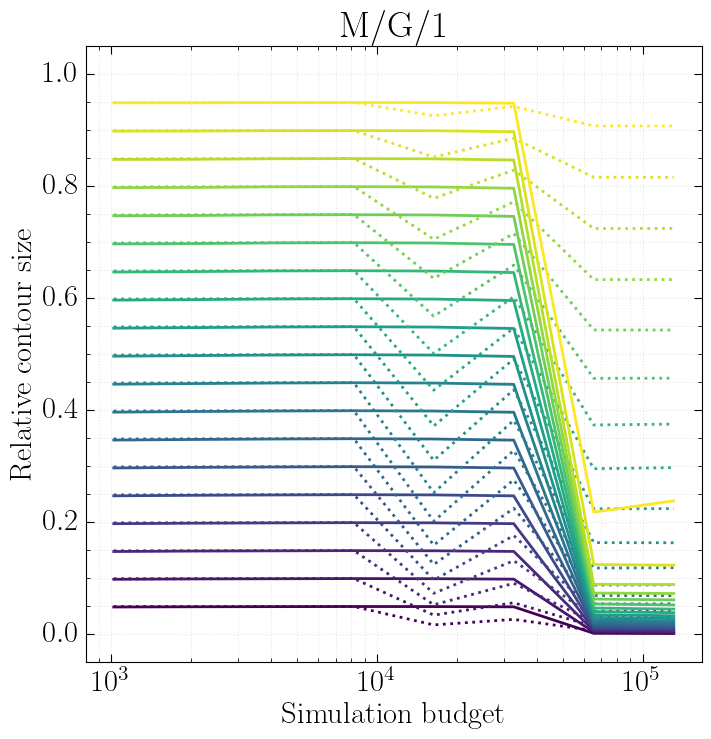

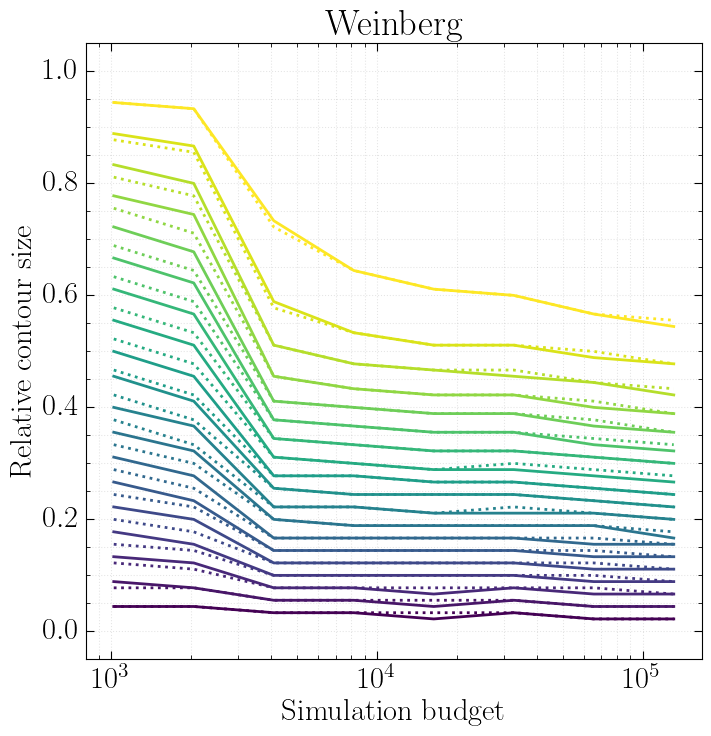

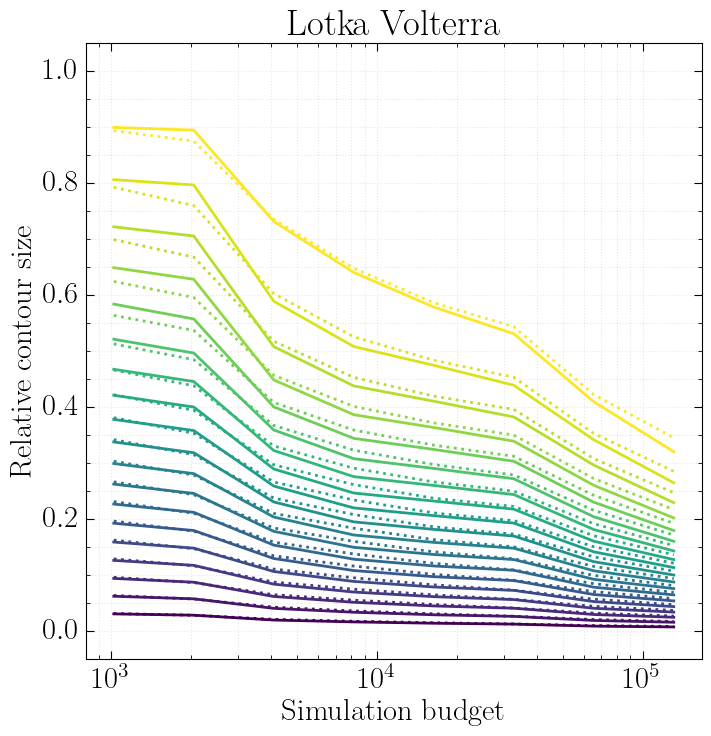

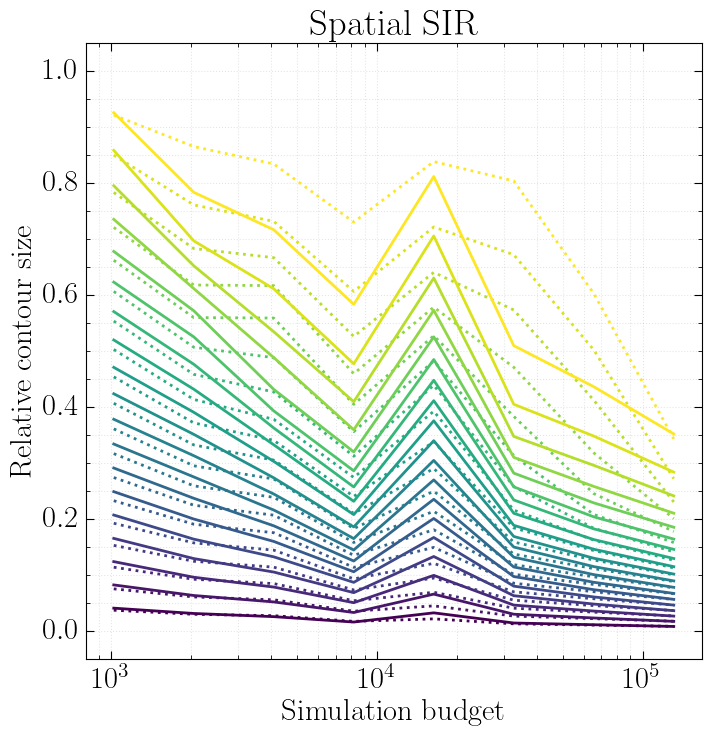

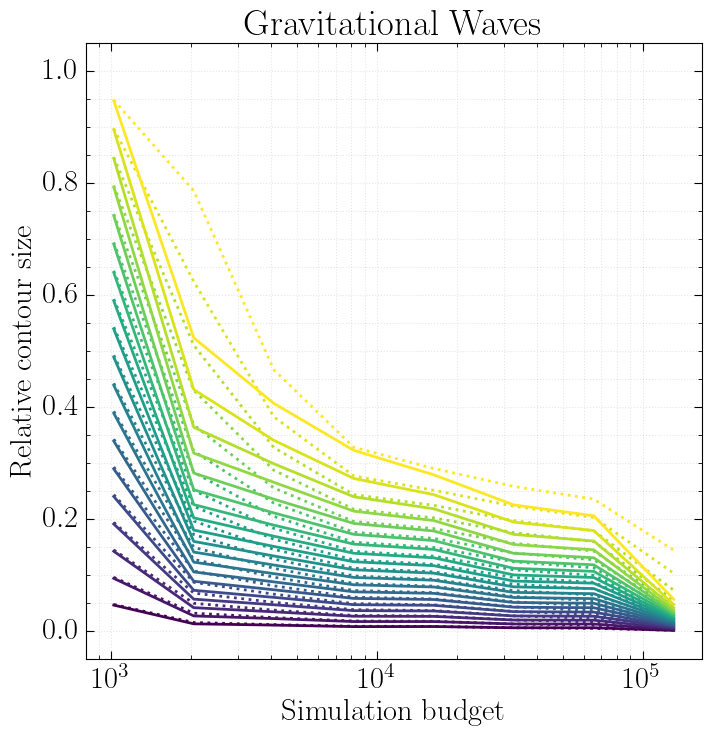

In [73]:
for problem in problems:
    try:
        plot_contour_size(problem, method="bnre")
        plt.show()
    except Exception as e:
        print(e)

#### CalNRE

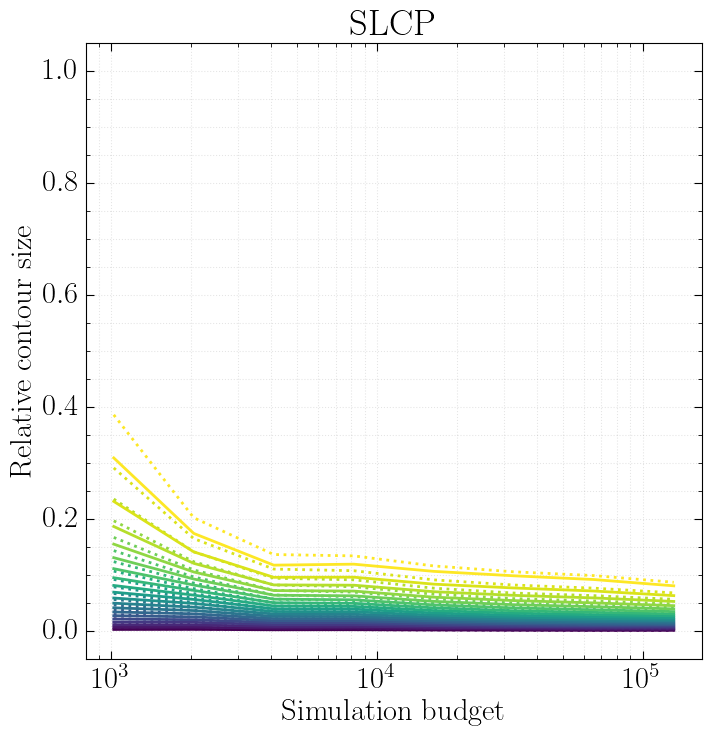

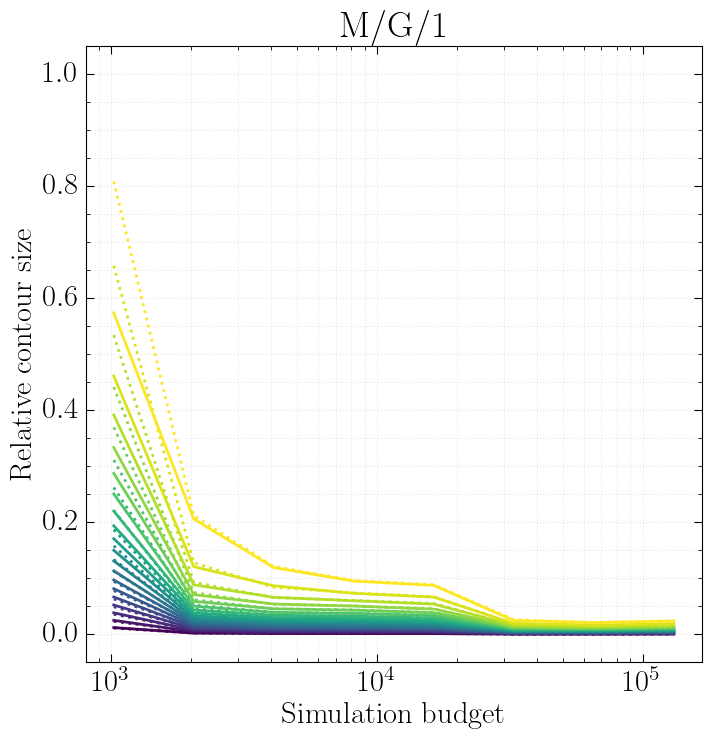

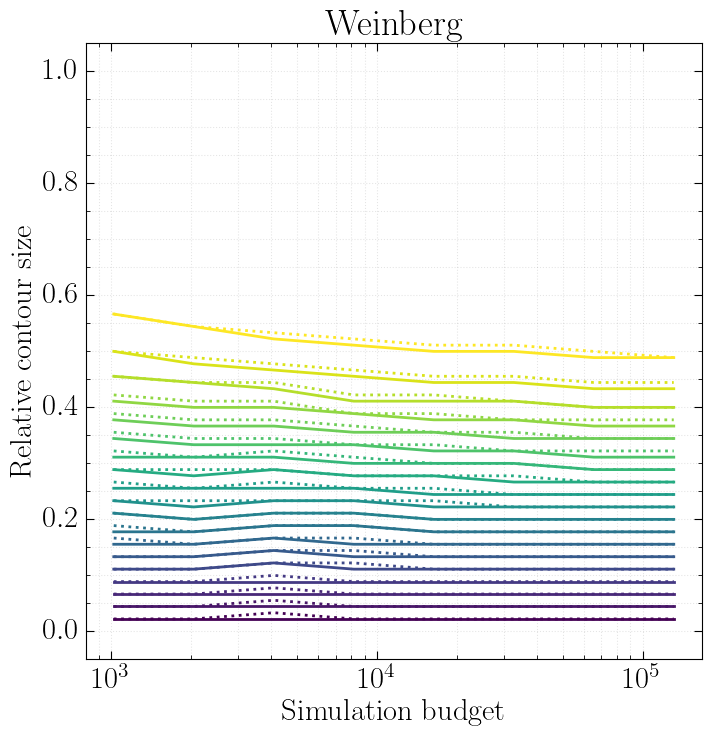

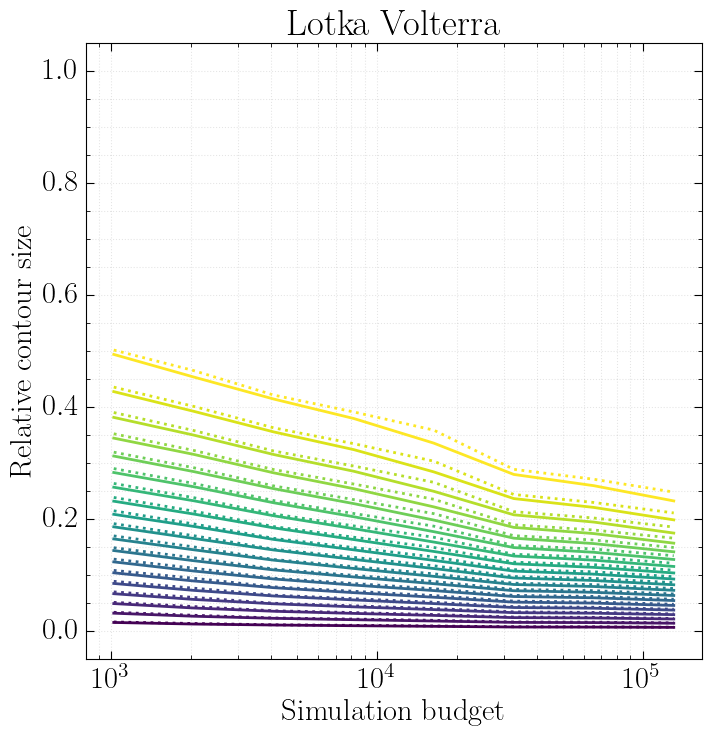

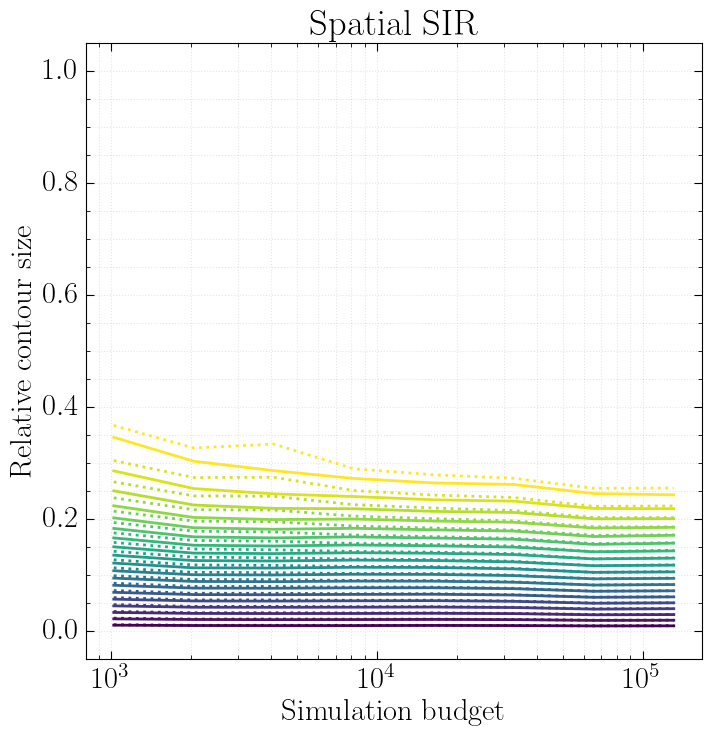

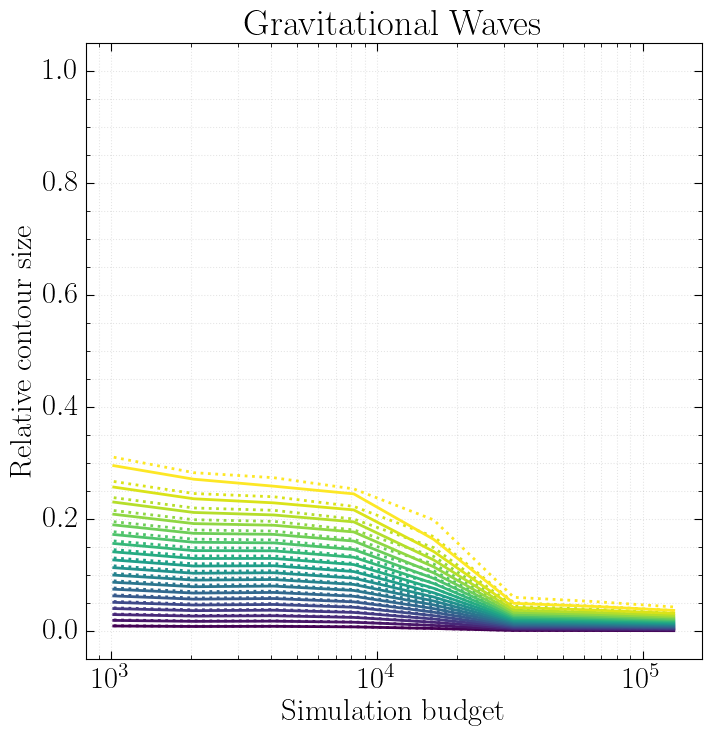

In [74]:
for problem in problems:
    try:
        plot_contour_size(problem, method="calnre")
        plt.show()
    except Exception as e:
        print(e)

#### CalNPE

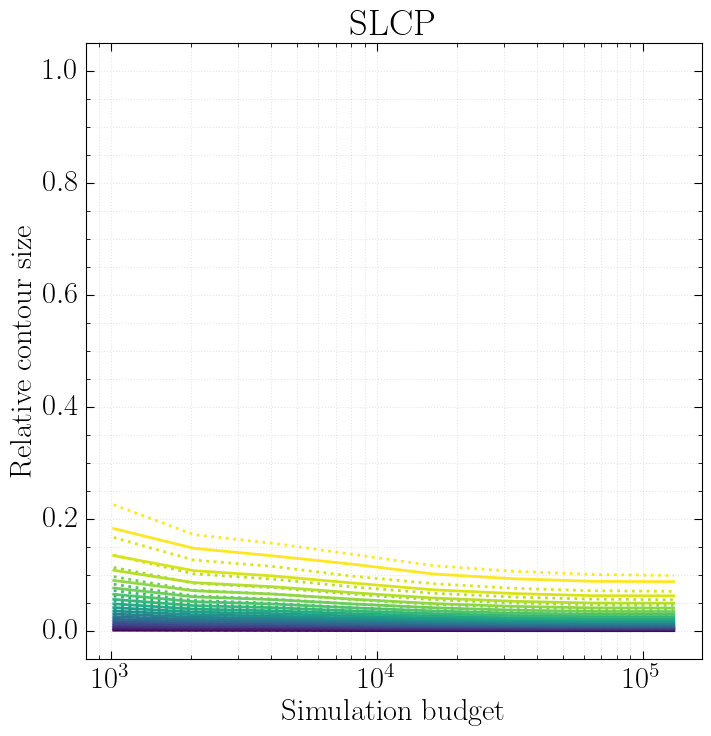

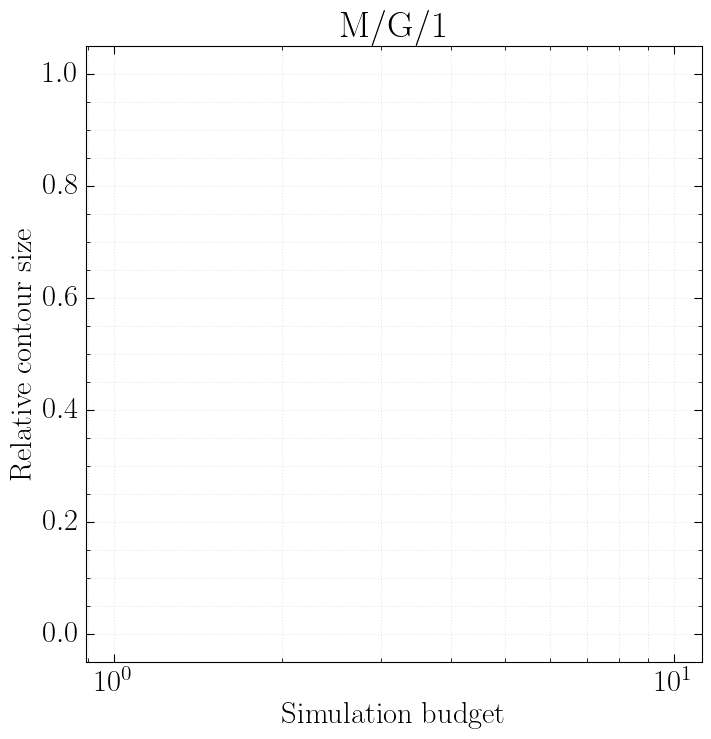

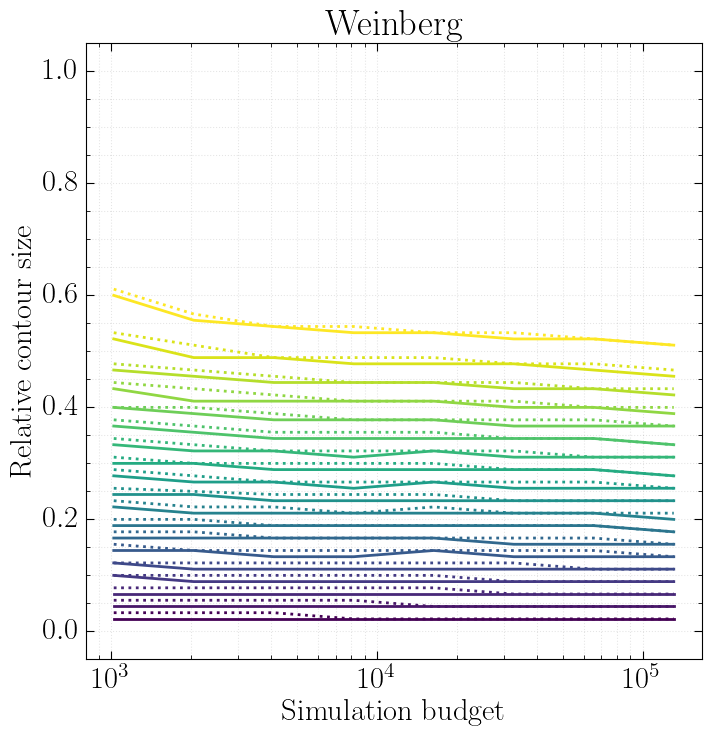

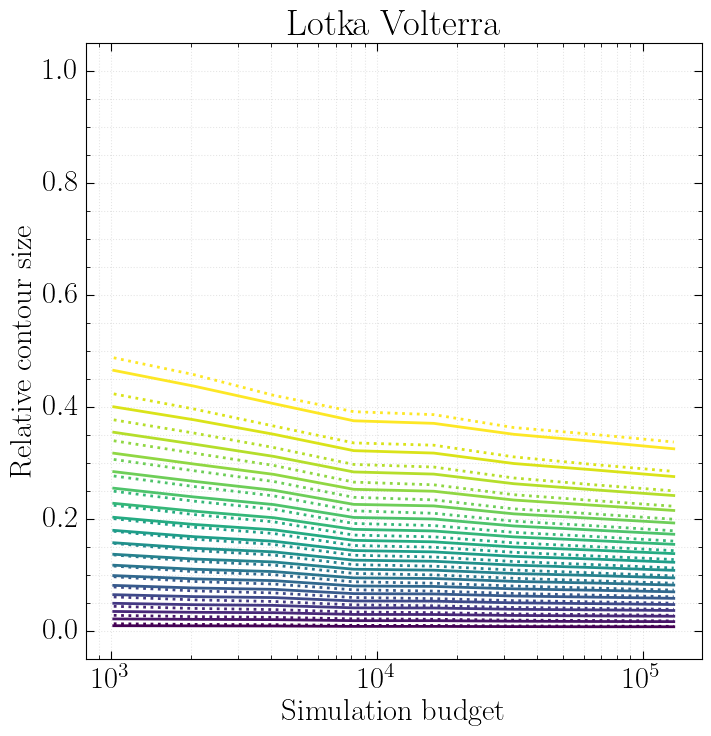

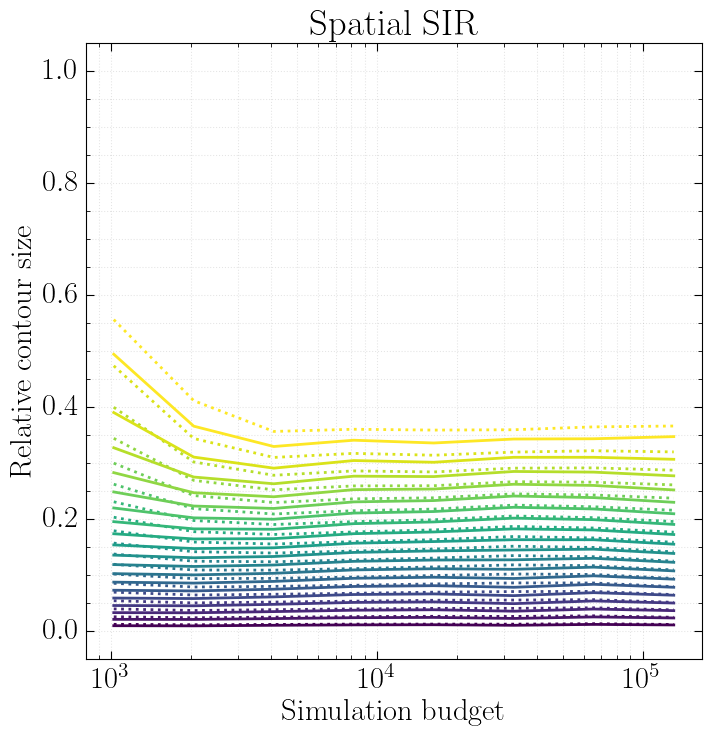

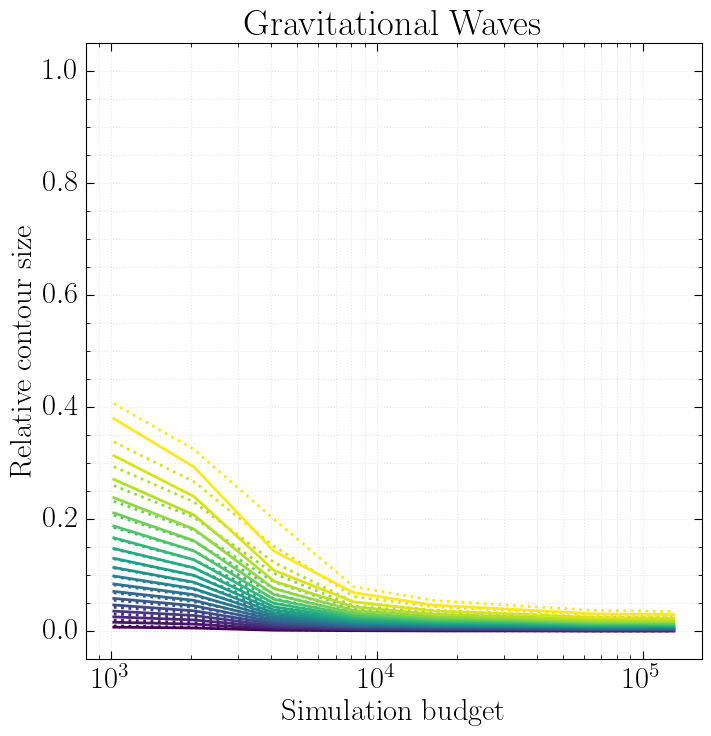

In [75]:
for problem in problems:
    try:
        plot_contour_size(problem, method="calnpe")
        plt.show()
    except Exception as e:
        print(e)

## Bias/variance

### Utilities

In [76]:
def load_bias_variance(
    problem, method, metric, metric_index, gamma=None, schedule=False
):
    learning_rate = problem_lrs[method][problem]

    data = []
    data_ensemble = []
    stds = []
    for budget in simulation_budgets:
        # Ensemble
        base_query = (
            "../{}/".format(method if method != "cnre" else "bnre")
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
        )

        if gamma is not None:
            base_query += "/" + str(gamma)
        if schedule:
            base_query += "/schedule"
        query = base_query + "/{}.npy".format(metric)

        if method == "npe":
            query = (
                "../casbi/coverage_simulations_and_bias_reduction/"
                + problem
                + "/output/"
                + str(budget)
                + "/without-regularization/{}-flow-sbi.npy".format(metric)
            )

        files = glob.glob(query)
        if len(files) != 0:
            samples = np.hstack(
                [np.load(f)[metric_index].reshape(-1) for f in files]
            )
            m = np.median(samples)
            data_ensemble.append(m)

        # Individual
        query = base_query + "/*/{}.npy".format(metric)

        if method == "npe":
            query = (
                "../casbi/coverage_simulations_and_bias_reduction/"
                + problem
                + "/output/"
                + str(budget)
                + "/without-regularization/flow-sbi-0*/{}.npy".format(metric)
            )

        files = glob.glob(query)
        if len(files) != 0:
            samples = np.hstack(
                [np.load(f)[metric_index].reshape(-1) for f in files]
            )
            m = np.median(samples)
            data.append(m)
            s = np.std(samples)
            stds.append(s)

    scale = problem_scales[problem][metric_index]

    data = np.array(data)
    stds = np.array(stds)
    data_ensemble = np.array(data_ensemble)

    if metric == "bias":
        data /= scale
        data_ensemble /= scale
        stds /= scale

    if metric == "bias_square" or metric == "variance":
        data /= scale**2
        data_ensemble /= scale**2
        stds /= scale**2

    return data, data_ensemble, stds

In [77]:
def plot_bias_variance(problem, method, metric, metric_index, ax=None):
    if ax is None:
        ax = plt.gca()
        ax.set_xlabel("Simulation budget")
        # ax.set_ylabel("{}_{}".format(metric, metric_index))
        ax.set_title(problem_titles[problem])

    data, data_ensemble, stds = load_bias_variance(
        problem, method, metric, metric_index
    )
    if len(data) == len(simulation_budgets):
        ax.plot(
            simulation_budgets,
            data,
            color=method_colors[method],
            label=method_titles[method],
        )
        # ax.errorbar(simulation_budgets, data, yerr=stds, color=method_colors[method], alpha=0.3)
        ax.fill_between(
            simulation_budgets,
            y1=data - stds,
            y2=data + stds,
            color=method_colors[method],
            alpha=0.1,
        )
    """
    if len(data) == len(simulation_budgets):
        ax.plot(simulation_budgets, data_ensemble, ':', label="Ensemble")
    """
    ax.set_xscale("log")
    make_square(ax)

### Plots

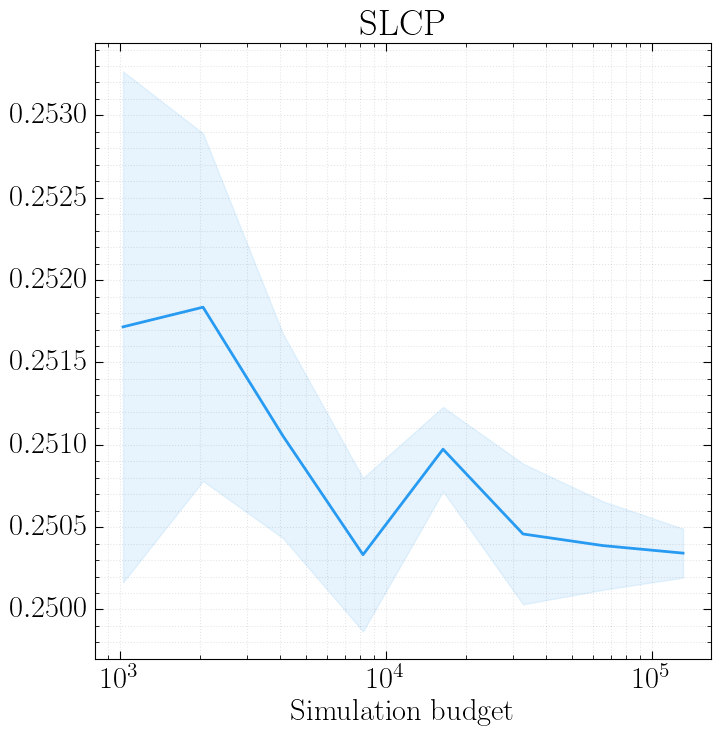

In [78]:
plot_bias_variance("slcp", "nre", "bias", 0)

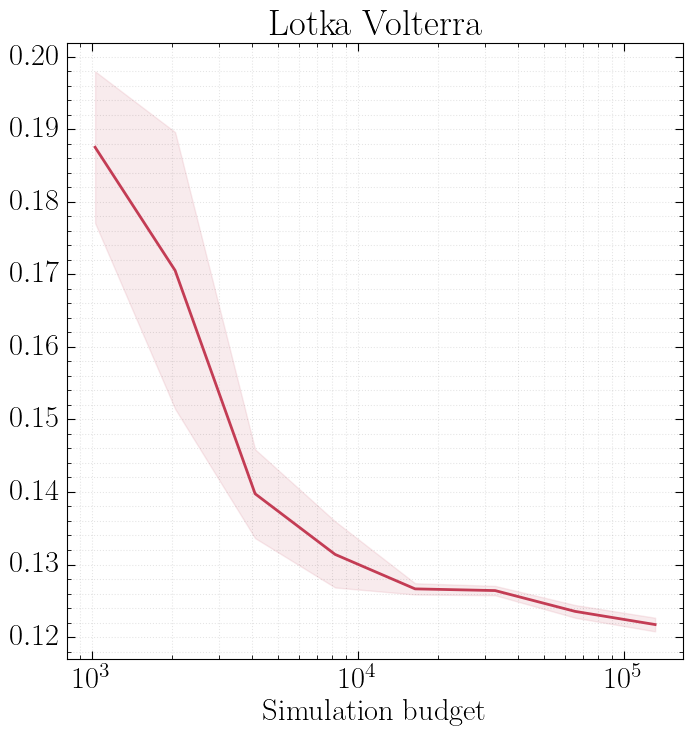

In [79]:
plot_bias_variance("lotka_volterra", "cnre", "bias", 0)

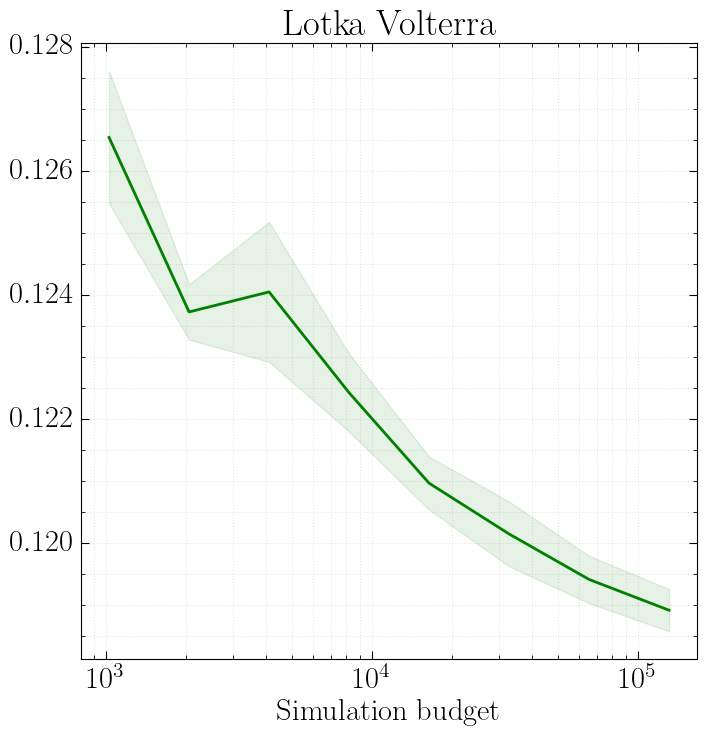

In [80]:
plot_bias_variance("lotka_volterra", "calnre", "bias", 0)

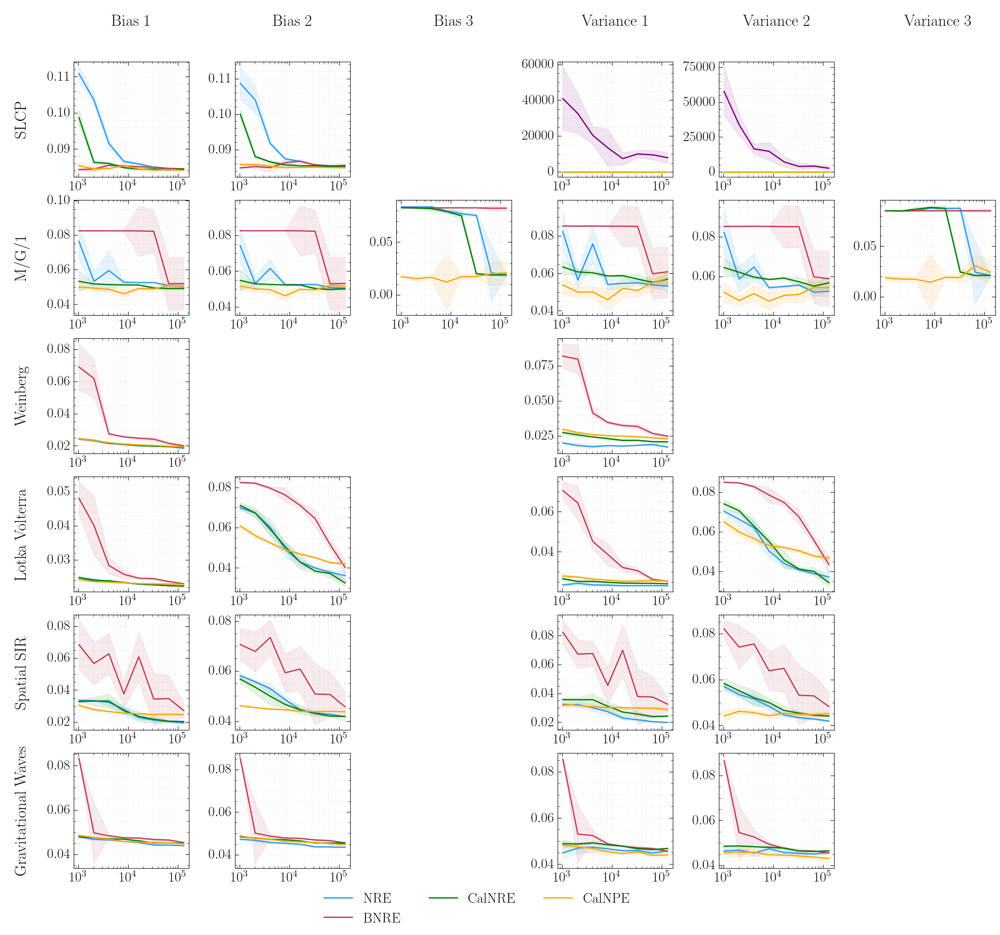

In [81]:
# Construct grid
horiz_sizes = [0.75, 0.75]

for _ in range(6):
    horiz_sizes += [2.5, 1.0]
horiz_sizes = horiz_sizes[:-1]

vert_sizes = [0.75, 0.5]

for _ in range(6):
    vert_sizes += [2.5, 0.5]

vert_sizes.append(0.75)

fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
horiz = [Fixed(x) for x in horiz_sizes]
vert = [Fixed(x) for x in vert_sizes]

rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
divider = Divider(fig, rect, horiz, vert, aspect=False)

title_size = 25

# Problems
for i in range(6):
    ax = fig.add_axes(rect, label="problem_axes_{}".format(i))
    ax.set_axes_locator(divider.new_locator(nx=0, ny=12 - 2 * i))
    ax.set_axis_off()
    ax.text(
        0.5,
        0.5,
        problem_titles[problems[i]],
        horizontalalignment="center",
        verticalalignment="center",
        transform=ax.transAxes,
        fontdict={"fontsize": title_size},
        rotation=90,
    )

# Metrics
for i in range(3):
    ax = fig.add_axes(rect, label="metric_axes_{}".format(i))
    ax.set_axes_locator(divider.new_locator(nx=2 + 2 * i, ny=14))
    ax.set_axis_off()
    ax.text(
        0.5,
        0.5,
        "Bias {}".format(i + 1),
        horizontalalignment="center",
        verticalalignment="center",
        transform=ax.transAxes,
        fontdict={"fontsize": title_size},
    )

    ax = fig.add_axes(rect, label="metric_axes_{}".format(3 + i))
    ax.set_axes_locator(divider.new_locator(nx=8 + 2 * i, ny=14))
    ax.set_axis_off()
    ax.text(
        0.5,
        0.5,
        "Variance {}".format(i + 1),
        horizontalalignment="center",
        verticalalignment="center",
        transform=ax.transAxes,
        fontdict={"fontsize": title_size},
    )

# Plots
for i, problem in enumerate(problems):
    for j in range(problem_nb_params[problem]):
        # Bias
        ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j))
        ax.set_axes_locator(divider.new_locator(nx=2 + 2 * j, ny=12 - 2 * i))
        for method in methods:
            plot_bias_variance(problem, method, "bias_square", j, ax=ax)

        if problem == "lotka_volterra" and j == 0:
            han, l = ax.get_legend_handles_labels()

        # Variance
        ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j + 3))
        ax.set_axes_locator(divider.new_locator(nx=8 + 2 * j, ny=12 - 2 * i))
        for method in methods:
            plot_bias_variance(problem, method, "variance", j, ax=ax)

# Legend
ax_legend = fig.add_axes(rect, label="legend ax")
ax_legend.set_axes_locator(divider.new_locator(nx=2, nx1=12, ny=0))
ax_legend.set_axis_off()
ax_legend.legend(han, l, ncol=3, loc="center")

plt.savefig("bias_variance.pdf")

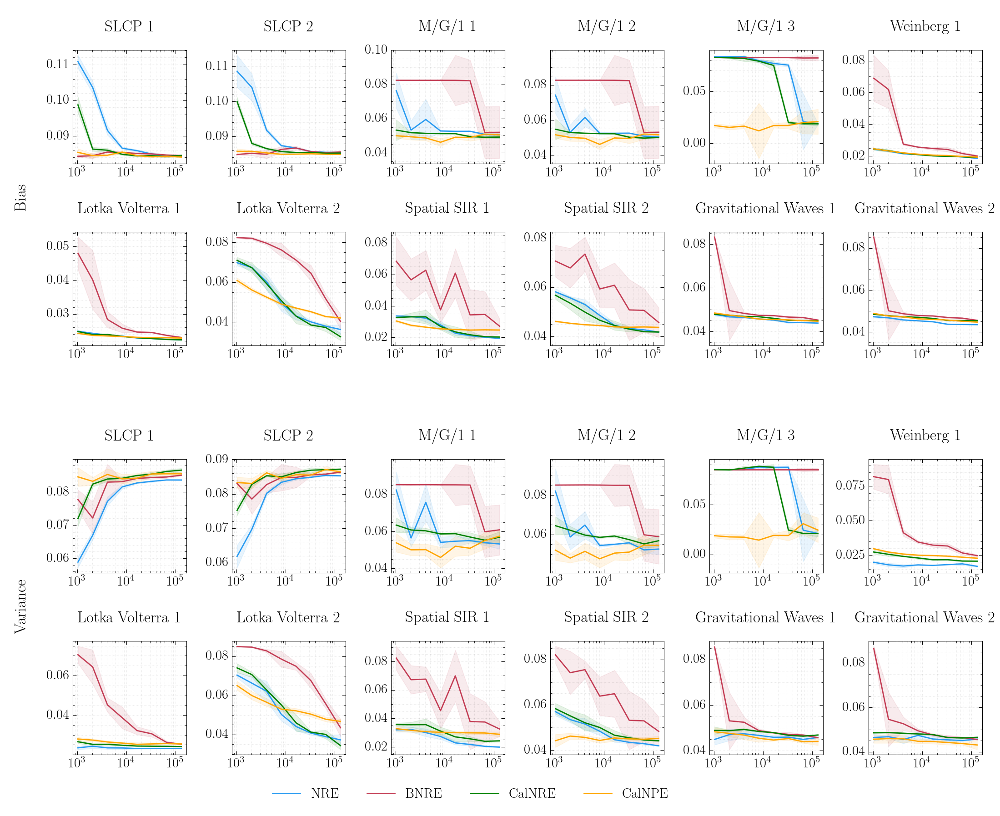

In [82]:
# Construct grid
horiz_sizes = [0.75, 0.75]

for _ in range(6):
    horiz_sizes += [2.5, 1.0]
horiz_sizes = horiz_sizes[:-1]

vert_sizes = [0.75, 0.5]

for i in range(4):
    if i == 1:
        vert_sizes += [2.5, 1.0, 1.5]
    else:
        vert_sizes += [2.5, 1.0, 0.5]

vert_sizes.append(0.75)

fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
horiz = [Fixed(x) for x in horiz_sizes]
vert = [Fixed(x) for x in vert_sizes]

rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
divider = Divider(fig, rect, horiz, vert, aspect=False)

title_size = 25

# Metrics
ax = fig.add_axes(rect, label="bias_axes")
ax.set_axes_locator(divider.new_locator(nx=0, ny=8, ny1=12))
ax.set_axis_off()
ax.text(
    0.5,
    0.5,
    "Bias",
    horizontalalignment="center",
    verticalalignment="center",
    transform=ax.transAxes,
    fontdict={"fontsize": title_size},
    rotation=90,
)
ax = fig.add_axes(rect, label="variance_axes")
ax.set_axes_locator(divider.new_locator(nx=0, ny=2, ny1=6))
ax.set_axis_off()
ax.text(
    0.5,
    0.5,
    "Variance",
    horizontalalignment="center",
    verticalalignment="center",
    transform=ax.transAxes,
    fontdict={"fontsize": title_size},
    rotation=90,
)

# Plots
curr_index = 0
for i, problem in enumerate(problems):
    for j in range(problem_nb_params[problem]):
        # Bias
        ax = fig.add_axes(rect, label="plot_axes_bias_{}_{}".format(i, j))
        ax.set_axes_locator(
            divider.new_locator(
                nx=2 + 2 * (curr_index % 6), ny=11 - 3 * (curr_index // 6)
            )
        )
        # for method in methods:
        for method in ["nre", "cnre", "calnre", "calnpe"]:
            plot_bias_variance(problem, method, "bias_square", j, ax=ax)

        if curr_index == 0:
            han, l = ax.get_legend_handles_labels()

        ax = fig.add_axes(rect, label="title_axes_bias_{}_{}".format(i, j))
        ax.set_axes_locator(
            divider.new_locator(
                nx=2 + 2 * (curr_index % 6), ny=12 - 3 * (curr_index // 6)
            )
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            "{} {}".format(problem_titles[problem], j + 1),
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

        # Variance
        ax = fig.add_axes(rect, label="plot_axes_variance_{}_{}".format(i, j))
        ax.set_axes_locator(
            divider.new_locator(
                nx=2 + 2 * (curr_index % 6), ny=5 - 3 * (curr_index // 6)
            )
        )
        # for method in methods:
        for method in ["nre", "cnre", "calnre", "calnpe"]:
            plot_bias_variance(problem, method, "variance", j, ax=ax)

        ax = fig.add_axes(rect, label="title_axes_variance_{}_{}".format(i, j))
        ax.set_axes_locator(
            divider.new_locator(
                nx=2 + 2 * (curr_index % 6), ny=6 - 3 * (curr_index // 6)
            )
        )
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            "{} {}".format(problem_titles[problem], j + 1),
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

        curr_index += 1


# Legend
ax_legend = fig.add_axes(rect, label="legend ax")
ax_legend.set_axes_locator(divider.new_locator(nx=2, nx1=12, ny=0))
ax_legend.set_axis_off()
ax_legend.legend(han, l, ncol=6, loc="center")

plt.savefig("bias_variance.pdf")

## Log posterior

In [83]:
def load_log_posterior(problem, method, gamma=None, schedule=False):
    learning_rate = problem_lrs[method][problem]

    data = []
    l_bound = []
    u_bound = []
    for budget in simulation_budgets:
        base_query = (
            "../{}/".format(method if method != "cnre" else "bnre")
            + problem
            + "/output/estimator/"
            + str(budget)
            + "/"
            + batch_size
            + "/"
            + learning_rate
        )
        if gamma is not None:
            base_query += "/" + str(gamma)
        if schedule:
            base_query += "/schedule"

        query = base_query + "/*/log_posterior.npy"

        if method == "npe":
            query = (
                "../casbi/coverage_simulations_and_bias_reduction/"
                + problem
                + "/output/"
                + str(budget)
                + "/without-regularization/flow-sbi-0*/expected-posterior.npy"
            )
        files = glob.glob(query)
        if len(files) != 0:
            samples = np.hstack([np.mean(np.load(f)) for f in files])
            m = np.median(samples, axis=0)
            data.append(m)
            # l = m - np.std(np.mean(samples, axis=0))
            # u = m + np.std(np.mean(samples, axis=0))
            # l = np.quantile(samples, 0.01)
            # u = np.quantile(samples, 0.99)
            l = np.min(samples)
            u = np.max(samples)
            l_bound.append(l)
            u_bound.append(u)
        else:
            data.append(None)
            l_bound.append(None)
            u_bound.append(None)

    data = np.array(data)
    l_bound = np.array(l_bound)
    u_bound = np.array(u_bound)

    return data, l_bound, u_bound

In [84]:
def plot_log_posterior(problem, method, ax=None):
    if ax is None:
        ax = plt.gca()
        ax.set_xlabel("Simulation budget")
        ax.set_title(problem_titles[problem])

    data, l_bound, u_bound = load_log_posterior(problem, method)
    if None not in data:
        ax.plot(
            simulation_budgets,
            data,
            method_colors[method],
            label=method_titles[method],
            marker=method_markers[method],
        )
        # ax.errorbar(simulation_budgets, data, yerr=stds, color="k", alpha=0.3)
        ax.fill_between(
            simulation_budgets,
            y1=l_bound,
            y2=u_bound,
            color=method_colors[method],
            alpha=0.1,
        )
    else:
        ax.plot(
            [
                simulation_budgets[idx]
                for idx, val in enumerate(data)
                if val is not None
            ],
            [val for idx, val in enumerate(data) if val is not None],
            method_colors[method],
            label=method_titles[method],
            marker=method_markers[method],
        )
        # ax.errorbar(simulation_budgets, data, yerr=stds, color="k", alpha=0.3)
        ax.fill_between(
            [
                simulation_budgets[idx]
                for idx, val in enumerate(data)
                if val is not None
            ],
            y1=[
                l_bound[idx] for idx, val in enumerate(data) if val is not None
            ],
            y2=[
                u_bound[idx] for idx, val in enumerate(data) if val is not None
            ],
            color=method_colors[method],
            alpha=0.2,
        )

    ax.set_xscale("log")
    make_square(ax)

In [85]:
def make_log_posterior_plot(methods, save_name):
    plot_problems = [
        "slcp",
        "weinberg",
        "spatialsir",
        "mg1",
        "lotka_volterra",
        "gw",
    ]

    # Construct grid
    horiz_sizes = []

    for _ in range(len(plot_problems)):
        horiz_sizes += [2.5, 0.5]
    horiz_sizes = horiz_sizes[:-1]

    vert_sizes = [0.75, 0.5]

    vert_sizes += [2.5, 0.25]

    vert_sizes.append(0.75)

    fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
    horiz = [Fixed(x) for x in horiz_sizes]
    vert = [Fixed(x) for x in vert_sizes]

    rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
    divider = Divider(fig, rect, horiz, vert, aspect=False)

    title_size = 25

    # Problems

    for i in range(len(plot_problems)):
        ax = fig.add_axes(rect, label="problem_axes_{}".format(i))
        ax.set_axes_locator(divider.new_locator(nx=2 * i, ny=4))
        ax.set_axis_off()
        ax.text(
            0.5,
            0.5,
            problem_titles[plot_problems[i]],
            horizontalalignment="center",
            verticalalignment="center",
            transform=ax.transAxes,
            fontdict={"fontsize": title_size},
        )

    # Plots
    for j, problem in enumerate(plot_problems):
        ax = fig.add_axes(rect, label="plot_axes_{}_{}".format(i, j))
        ax.set_axes_locator(divider.new_locator(nx=2 * j, ny=2))
        for i, method in enumerate(methods):
            plot_log_posterior(problem, method, ax)

        log_prior = np.log(1 / np.prod(np.array(problem_scales[problem])))
        ax.plot(
            simulation_budgets,
            [log_prior for _ in simulation_budgets],
            color="C0",
            linestyle="-",
            label="Prior",
        )

        if j == 0:
            ax.set_xlabel("Simulation budget")
            # ax.set_ylabel(r"$\mathbb{E}_{p(\boldsymbol{\vartheta},\boldsymbol{x})}\left[\log \hat{p}(\boldsymbol{\vartheta}|\boldsymbol{x})\right]$")
            ax.set_ylabel(
                r"$\mathbb{E}_{p(\theta,x)}\left[\log \hat{p}(\theta|x)\right]$"
            )
            # ax.set_ylabel("Log posterior density")
            han, l = ax.get_legend_handles_labels()
        make_square(ax)

    # Legend
    ax_legend = fig.add_axes(rect, label="legend ax")
    ax_legend.set_axes_locator(
        divider.new_locator(nx=0, nx1=2 * len(plot_problems) - 1, ny=0)
    )
    ax_legend.set_axis_off()
    ax_legend.legend(han, l, ncol=6, loc="center")

    plt.savefig(save_name)

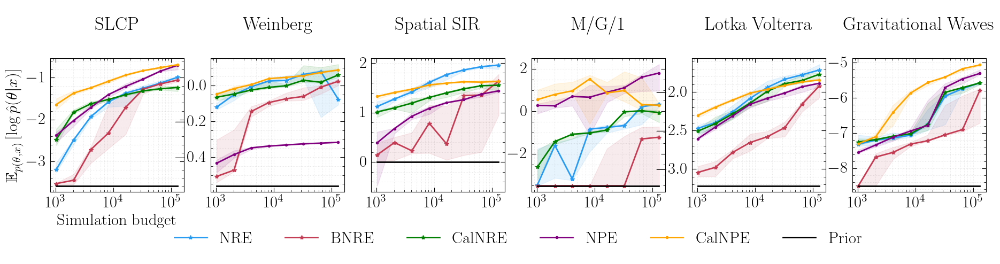

In [86]:
make_log_posterior_plot(
    ["nre", "cnre", "calnre", "npe", "calnpe"], "log_posterior.pdf"
)

## illustrative summary

In [87]:
# def make_illustrative_summary(save_name):

#     # Construct grid
#     horiz_sizes = [3.5, 0.75, 3.5, 2.0, 3.5, 0.75, 3.5]

#     vert_sizes = [0.75, 1.25, 3.5, 0.25, 0.5]

#     fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
#     horiz = [Fixed(x) for x in horiz_sizes]
#     vert = [Fixed(x) for x in vert_sizes]

#     rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
#     divider = Divider(fig, rect, horiz, vert, aspect=False)

#     title_size = 25

#     # Coverages
#     ax_cov_nre = fig.add_axes(rect, label="ax_cov_nre")
#     ax_cov_nre.set_axes_locator(divider.new_locator(nx=0, ny=2))
#     method_plot_functions["nre"]("weinberg", ax_cov_nre)
#     ax_cov_nre.plot(
#         levels,
#         levels,
#         color="C3",
#         linestyle=":",
#         linewidth=5.0,
#         alpha=1.0,
#         label="Calibrated estimator",
#     )
#     ax_cov_nre.set_ylim(-0.01, 1.01)
#     ax_cov_nre.set_xlim(-0.01, 1.01)
#     ax_cov_nre.set_xlabel("Credibility level")
#     ax_cov_nre.set_ylabel("Expected coverage")

#     han_2, l_2 = ax_cov_nre.get_legend_handles_labels()

#     ax_text_cov_nre = fig.add_axes(rect, label="text_cov_nre")
#     ax_text_cov_nre.set_axes_locator(divider.new_locator(nx=0, ny=4))
#     ax_text_cov_nre.set_axis_off()
#     ax_text_cov_nre.text(
#         0.5,
#         0.5,
#         "NRE",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax_text_cov_nre.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     ax_cov_cnre = fig.add_axes(rect, label="ax_cov_cnre")
#     ax_cov_cnre.set_axes_locator(divider.new_locator(nx=2, ny=2))
#     method_plot_functions["cnre"]("weinberg", ax_cov_cnre)
#     ax_cov_cnre.plot(
#         levels,
#         levels,
#         color="C3",
#         linestyle=":",
#         linewidth=5.0,
#         alpha=1.0,
#         label="Calibrated estimator",
#     )
#     ax_cov_cnre.set_ylim(-0.01, 1.01)
#     ax_cov_cnre.set_xlim(-0.01, 1.01)
#     ax_cov_cnre.set_xlabel("Credibility level")

#     ax_text_cov_cnre = fig.add_axes(rect, label="text_cov_cnre")
#     ax_text_cov_cnre.set_axes_locator(divider.new_locator(nx=2, ny=4))
#     ax_text_cov_cnre.set_axis_off()
#     ax_text_cov_cnre.text(
#         0.5,
#         0.5,
#         "BNRE",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax_text_cov_cnre.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # Bias
#     ax_bias = fig.add_axes(rect, label="ax_bias")
#     ax_bias.set_axes_locator(divider.new_locator(nx=4, ny=2))
#     plot_bias_variance("weinberg", "nre", "bias_square", 0, ax=ax_bias)
#     plot_bias_variance("weinberg", "cnre", "bias_square", 0, ax=ax_bias)
#     ax_bias.set_xlabel("Simulation budget")

#     han, l = ax_bias.get_legend_handles_labels()

#     ax_text_bias = fig.add_axes(rect, label="text_bias")
#     ax_text_bias.set_axes_locator(divider.new_locator(nx=4, ny=4))
#     ax_text_bias.set_axis_off()
#     ax_text_bias.text(
#         0.5,
#         0.5,
#         "Bias",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax_text_bias.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # Variance
#     ax_variance = fig.add_axes(rect, label="ax_variance")
#     ax_variance.set_axes_locator(divider.new_locator(nx=6, ny=2))
#     plot_bias_variance("weinberg", "nre", "variance", 0, ax=ax_variance)
#     plot_bias_variance("weinberg", "cnre", "variance", 0, ax=ax_variance)
#     ax_variance.set_xlabel("Simulation budget")

#     ax_text_variance = fig.add_axes(rect, label="text_variance")
#     ax_text_variance.set_axes_locator(divider.new_locator(nx=6, ny=4))
#     ax_text_variance.set_axis_off()
#     ax_text_variance.text(
#         0.5,
#         0.5,
#         "Variance",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax_text_variance.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # Legend
#     ax_legend = fig.add_axes(rect, label="legend ax")
#     ax_legend.set_axes_locator(divider.new_locator(nx=4, nx1=7, ny=0))
#     ax_legend.set_axis_off()
#     ax_legend.legend(han, l, ncol=2, loc="center")

#     # Legend
#     ax_legend_2 = fig.add_axes(rect, label="legend ax_2")
#     ax_legend_2.set_axes_locator(divider.new_locator(nx=0, nx1=3, ny=0))
#     ax_legend_2.set_axis_off()
#     ax_legend_2.legend(han_2, l_2, ncol=3, loc="center")

#     plt.savefig(save_name)

In [88]:
# make_illustrative_summary("illustrative_summary.pdf")

## Effect of gamma

In [89]:
# def load_balancing_error(problem, method, budget, gamma=None, schedule=False):
#     learning_rate = problem_lrs[problem]

#     base_query = (
#         "../{}/".format(method)
#         + problem
#         + "/output/estimator/"
#         + str(budget)
#         + "/"
#         + batch_size
#         + "/"
#         + learning_rate
#     )
#     if gamma is not None:
#         base_query += "/" + str(gamma)
#     if schedule:
#         base_query += "/schedule"
#     query = base_query + "/*/balancing.npy"

#     files = glob.glob(query)
#     if len(files) == 0:
#         return None
#     samples = np.hstack([np.load(f) for f in files])

#     data = np.mean(np.absolute(1 - samples))

#     return data

In [90]:
# def plot_effect_of_gamma(method, benchmarks, save_name=None, schedule=False):
#     # Construct grid
#     horiz_sizes = [1.0]

#     for _ in range(6):
#         horiz_sizes += [2.5, 1.0]
#     horiz_sizes = horiz_sizes[:-1]

#     vert_sizes = [0.5]

#     for i in range(1):
#         if i == 1:
#             vert_sizes += [2.5, 1.5]
#         else:
#             vert_sizes += [2.5, 0.5]

#     vert_sizes.append(0.75)

#     fig = plt.figure(figsize=[sum(horiz_sizes), sum(vert_sizes)])
#     horiz = [Fixed(x) for x in horiz_sizes]
#     vert = [Fixed(x) for x in vert_sizes]

#     rect = (0.1, 0.1, 0.8, 0.8)  # Ignored
#     divider = Divider(fig, rect, horiz, vert, aspect=False)

#     gammas = [float(2 ** x) for x in range(1, 11)]
#     title_size = 25

#     # auc
#     ax = fig.add_axes(rect, label="ax_0")
#     ax.set_axes_locator(divider.new_locator(nx=1, ny=1))
#     for benchmark in benchmarks:
#         data = [
#             area_under_expected_coverage(
#                 method, benchmark, 8192, gamma=gamma, schedule=schedule
#             )[0]
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_0")
#     ax.set_axes_locator(divider.new_locator(nx=1, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "AUC",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # biases
#     ax = fig.add_axes(rect, label="ax_1")
#     ax.set_axes_locator(divider.new_locator(nx=3, ny=1))
#     for benchmark in benchmarks:
#         data = [
#             load_bias_variance(
#                 benchmark, method, "bias", 0, gamma=gamma, schedule=schedule
#             )[0]
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_1")
#     ax.set_axes_locator(divider.new_locator(nx=3, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "Bias 1",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     ax = fig.add_axes(rect, label="ax_2")
#     ax.set_axes_locator(divider.new_locator(nx=5, ny=1))
#     for benchmark in benchmarks:
#         data = [
#             load_bias_variance(
#                 benchmark, method, "bias", 1, gamma=gamma, schedule=schedule
#             )[0]
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_2")
#     ax.set_axes_locator(divider.new_locator(nx=5, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "Bias 2",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # Variances
#     ax = fig.add_axes(rect, label="ax_3")
#     ax.set_axes_locator(divider.new_locator(nx=7, ny=1))
#     for benchmark in benchmarks:
#         data = [
#             load_bias_variance(
#                 benchmark, method, "variance", 0, gamma=gamma, schedule=schedule
#             )[0]
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_3")
#     ax.set_axes_locator(divider.new_locator(nx=7, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "Variance 1",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     ax = fig.add_axes(rect, label="ax_4_{}".format(benchmark))
#     ax.set_axes_locator(divider.new_locator(nx=9, ny=1))
#     for benchmark in benchmarks:
#         data = [
#             load_bias_variance(
#                 benchmark, method, "variance", 1, gamma=gamma, schedule=schedule
#             )[0]
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_4")
#     ax.set_axes_locator(divider.new_locator(nx=9, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "Variance 2",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     # Balancing
#     ax = fig.add_axes(rect, label="ax_5")
#     ax.set_axes_locator(divider.new_locator(nx=11, ny=1))
#     for benchmark in benchmarks:

#         data = [
#             load_balancing_error(
#                 benchmark, method, 8192, gamma=gamma, schedule=schedule
#             )
#             for gamma in gammas
#         ]
#         ax.plot(
#             gammas,
#             data,
#             color=problem_colors[benchmark],
#             label=problem_titles[benchmark],
#         )
#     ax.set_xscale("log")

#     ax = fig.add_axes(rect, label="text_5")
#     ax.set_axes_locator(divider.new_locator(nx=11, ny=3))
#     ax.set_axis_off()
#     ax.text(
#         0.5,
#         0.5,
#         "Balancing error",
#         horizontalalignment="center",
#         verticalalignment="center",
#         transform=ax.transAxes,
#         fontdict={"fontsize": title_size},
#     )

#     if save_name is not None:
#         plt.savefig(save_name)

In [91]:
# plot_effect_of_gamma("kl_cnpe", "lotka_volterra")

In [92]:
# plot_effect_of_gamma("cnre", ["slcp", "spatialsir", "lotka_volterra"])

In [93]:
# plot_effect_of_gamma("cnre", "spatialsir")

In [94]:
# plot_effect_of_gamma("cnre", "spatialsir", schedule=True)

In [95]:
# plot_effect_of_gamma("cnre", "lotka_volterra")

In [96]:
# plot_effect_of_gamma("ratio_cnpe", "lotka_volterra")

In [97]:
# plot_effect_of_gamma("cnre", "spatialsir")

In [98]:
# plot_effect_of_gamma("cnre", "spatialsir", schedule=True)

In [99]:
# plot_effect_of_gamma("cnre", "lotka_volterra")

In [100]:
# plot_effect_of_gamma("ratio_cnpe", "lotka_volterra")